# L1: Intro to CNN

### Part 1: (Hammering the Screw)  
  
  Scenario:  **Classify the fashion image into one of the 10 categories**  
  Inventory: Vanilla NN (hammer) and CNN (new tool)

<center><img src='https://drive.google.com/uc?id=1xL9UKISIdQPOSh3B_Z_ac3-8MzoW3jp7' width=1000 height=500>
</center>


## 0. Setup

As always, we will start by downloading resources, installing packages and importing them to the environment!   
- 0.1 Download Resources  
- 0.2 Import Libraries  

### 0.1 Download Data

We are going to use a collection of real-world clothing images dataset, opensourced [here](https://github.com/alexeygrigorev/clothing-dataset-small).  

You can read more about the dataset in this [blog post](https://medium.com/data-science-insider/clothing-dataset-5b72cd7c3f1f).

In [ ]:
!gdown https://drive.google.com/uc?id=1XdXz0TKo_KCDRHOMvzV-YtcTx7NPG-jC

Downloading...
From: https://drive.google.com/uc?id=1XdXz0TKo_KCDRHOMvzV-YtcTx7NPG-jC
To: /content/clothing-dataset-small.zip
100% 106M/106M [00:01<00:00, 82.0MB/s] 


In [ ]:
!unzip /content/clothing-dataset-small.zip

Archive:  /content/clothing-dataset-small.zip
   creating: clothing-dataset-small/
  inflating: clothing-dataset-small/.DS_Store  
   creating: clothing-dataset-small/test/
   creating: clothing-dataset-small/test/skirt/
  inflating: clothing-dataset-small/test/skirt/f4b934fc-e326-4f72-b535-53288b8b82d3.jpg  
  inflating: clothing-dataset-small/test/skirt/491982c3-3e90-431e-99e6-b14ecea36384.jpg  
  inflating: clothing-dataset-small/test/skirt/24963db3-649c-4f04-8da3-0375ede8e0a6.jpg  
  inflating: clothing-dataset-small/test/skirt/32b99302-cec7-4dec-adfa-3d4029674209.jpg  
  inflating: clothing-dataset-small/test/skirt/0558b2c5-be00-49de-b27f-8c88114ac36f.jpg  
  inflating: clothing-dataset-small/test/skirt/95e66e02-b4ed-4fe9-b538-db6bac4fb7df.jpg  
  inflating: clothing-dataset-small/test/skirt/2001dec1-1e0a-4c11-9d15-120b019b3dea.jpg  
  inflating: clothing-dataset-small/test/skirt/b0e05193-cc92-4935-88d7-e71a1b19dd4b.jpg  
  inflating: clothing-dataset-small/test/skirt/309829b2-6d1

#### [Optional] Download trained checkpoints for this lecture

In [ ]:
!gdown https://drive.google.com/drive/folders/1wgRokkvPUoGjsUZqJEhtpJn5e5lDTL4i --folder  # OPTIONAL

Retrieving folder list
Processing file 1yJT_CluvRxuSiWNnNhPyG5vgon0Re4_t L1_ann_model.ckpt.data-00000-of-00001
Processing file 1BiOY_1SXdkEHQmb0nVWgos0NnOvjQo1f L1_ann_model.ckpt.index
Processing file 1fnyJtYPAit6Nsa9cOD7b5G_8rXRnEv0n L1_cnn_model.ckpt.data-00000-of-00001
Processing file 1pzasWKpoLT-4yUf0ry8r0ykXegRuDzL_ L1_cnn_model.ckpt.index
Retrieving folder list completed
Building directory structure
Building directory structure completed
Downloading...
From: https://drive.google.com/uc?id=1yJT_CluvRxuSiWNnNhPyG5vgon0Re4_t
To: /content/Saved Models/L1_ann_model.ckpt.data-00000-of-00001
100% 607M/607M [00:26<00:00, 23.0MB/s]
Downloading...
From: https://drive.google.com/uc?id=1BiOY_1SXdkEHQmb0nVWgos0NnOvjQo1f
To: /content/Saved Models/L1_ann_model.ckpt.index
100% 1.68k/1.68k [00:00<00:00, 4.90MB/s]
Downloading...
From: https://drive.google.com/uc?id=1fnyJtYPAit6Nsa9cOD7b5G_8rXRnEv0n
To: /content/Saved Models/L1_cnn_model.ckpt.data-00000-of-00001
100% 201M/201M [00:10<00:00, 19.2MB/

### 0.2 Import Libraries

a. viz libraries like matplotlib, seaborn etc.

b. DL framework like tf, keras etc.

In [ ]:
# Import common libraries
import os
import glob
import random
import numpy as np
import pandas as pd
import sklearn.metrics as metrics
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

# Import tensorflow and its modules
import tensorflow as tf
from tensorflow import keras # this allows <keras.> instead of <tf.keras.>
from tensorflow.keras import layers # this allows <layers.> instead of <tf.keras.layers.>
tf.keras.utils.set_random_seed(111) # set random seed

# To supress any warnings during the flow
import warnings
warnings.filterwarnings('ignore')

## 1. Data Visualization

Q. **What to visualize?** Samples, Data Distribution etc.


> We can see from the data directory that the data is divided into train/valid/test with each containing separate sub-folders for each class!  
><img src='https://drive.google.com/uc?id=1sxY-Ej9Z3CXKaU6AyQwG6O4P7PRGWW2n' width=230>         

#### **Now let's Plot Samples from each of these classes and Data Distribution across samples!**


In [ ]:
class_dirs = os.listdir("clothing-dataset-small/train") # list all directories inside "train" folder
image_dict = {} # dict to store image array(key) for every class(value)
count_dict = {} # dict to store count of files(key) for every class(value)
# iterate over all class_dirs
for cls in class_dirs:
    # get list of all paths inside the subdirectory
    file_paths = glob.glob(f'clothing-dataset-small/train/{cls}/*')
    # count number of files in each class and add it to count_dict
    count_dict[cls] = len(file_paths)
    # select random item from list of image paths
    image_path = random.choice(file_paths)
    # load image using keras utility function and save it in image_dict
    image_dict[cls] = tf.keras.utils.load_img(image_path)

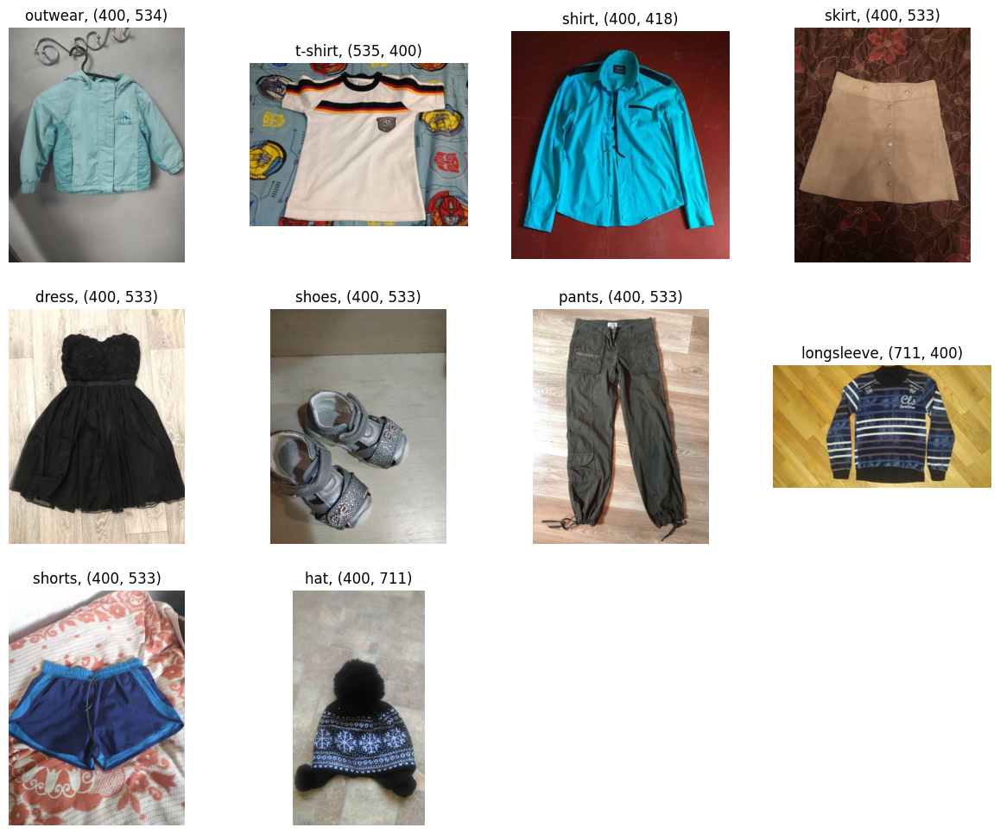

In [ ]:
## Viz Random Sample from each class

plt.figure(figsize=(15, 12))
# iterate over dictionary items (class label, image array)
for i, (cls,img) in enumerate(image_dict.items()):
    # create a subplot axis
    ax = plt.subplot(3, 4, i + 1)
    # plot each image
    plt.imshow(img)
    # set "class name" along with "image size" as title
    plt.title(f'{cls}, {img.size}')
    plt.axis("off")

- Notice that every Image has **different dimension!**
- This is expected in a real-world data, but can you guess why this is **not ideal**? Hint: Batching requires all samples to be of the same size!
- We will see later how we can handle this issue!

Count of training samples per class:
         class  count
0     outwear    184
1     t-shirt    795
2       shirt    290
3       skirt    112
4       dress    241
5       shoes    198
6       pants    468
7  longsleeve    455
8      shorts    202
9         hat    123


<Axes: title={'center': 'Training Data Count per class'}, xlabel='class'>

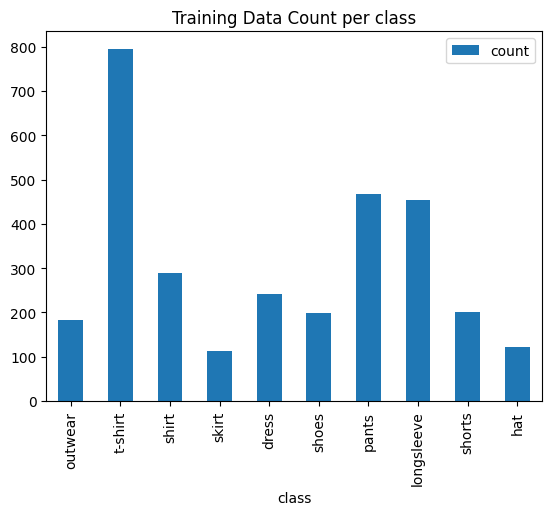

In [ ]:
## Let's now Plot the Data Distribution of Training Data across Classes
df_count_train = pd.DataFrame({
    "class": count_dict.keys(),     # keys of count_dict are class labels
    "count": count_dict.values(),   # value of count_dict contain counts of each class
})
print("Count of training samples per class:\n", df_count_train)

# draw a bar plot using pandas in-built plotting function
df_count_train.plot.bar(x='class', y='count', title="Training Data Count per class")

- Note that the `train/val/test` split already provided, we needn't create it explicitly!
- Also, we can observe that the data is **imbalanced**. For this lecture, we will work with the given data-distribution, but later on we will see some common techniques to work with imbalanced-data! (Any thoughts?)

## 2. Preprocessing

### Q. **What type of Preprocessing is required here?**  
  
- 2.1 Shape Preprocessing  
- 2.2 Value Preprocessing   
- 2.3 Additional Shape Preprocessing for MLPs

#### Before that, lets ***mount*** the data directory in Keras using [image_dataset_from_directory](https://www.tensorflow.org/api_docs/python/tf/keras/utils/image_dataset_from_directory) function

Keras provides a utility function (`tf.keras.utils.image_dataset_from_directory`) to directly load data from directory in `tf.data.Dataset` format.

In [ ]:
print('\nLoading Train Data...')
train_data = tf.keras.utils.image_dataset_from_directory(
    "clothing-dataset-small/train", shuffle = True,
)

print('\nLoading Validation Data...')
val_data = tf.keras.utils.image_dataset_from_directory(
    "clothing-dataset-small/validation", shuffle = False,
)

print('\nLoading Test Data...')
test_data = tf.keras.utils.image_dataset_from_directory(
    "clothing-dataset-small/test", shuffle = False,
)


Loading Train Data...
Found 3068 files belonging to 10 classes.

Loading Validation Data...
Found 341 files belonging to 10 classes.

Loading Test Data...
Found 372 files belonging to 10 classes.


### 2.1 Shape Preprocessing (Resizing)

- The dataset may contain images of different sizes, but a batch in keras, requires all of them to be of the same size. (Why? , How?)
- This can be achieved in a multiple of ways, but the most common technique is to resize all images to a fixed size (128,128)   

*Note: We can also provide the resizing parameters while loading data itself.*

### 2.2 Value Preprocessing (Rescaling)

- We also convert the datatype of input tensor from `uint8` to `float32` and rescale the values to lie between 0 and 1 instead of 0 and 255. (Why?)
- Without scaling, the high pixel range images will have large influence on loss values and thereby weight updation. (Eg: Black cat vs White cat)

### 2.3 Shape Preprocessing for MLPs (Flatten)

- Images are 2D* objects (with channel acting as an additional dimension)
- But Neural Networks requires each sample to be 1D or flat!
- Now Flattening of this matrix will lead to 3 elements of the vector to have value for that particular pixel as shown below.


><img src='https://drive.google.com/uc?id=1LXJfVbDG23ro2t-7jZ1FC_kzXBT4Xfpw' height=600>

- We will be using **Keras API** `Flatten layer` to convert the image matrix into vector
- It will change `bs x 256 x 256 x 3` to `bs x 196608`

In [ ]:
height, width = 128, 128 # Optional, not required if we already have resized the data from `image_dataset_from_directory` function.

# Data Processing Stage with resizing and rescaling operations
data_preprocess_with_flatten = keras.Sequential(
    name = "data_preprocess_with_flatten",
    layers = [
        layers.Resizing(height, width),
        layers.Rescaling(1./255),
        layers.Flatten(), # Note: We prefer NOT to add `layers.Flatten()` as part of preprocessing layers (rather as model definition itself)!
    ]
)

# Perform Data Processing on the train, val, test dataset
train_ds = train_data.map(lambda x, y: (data_preprocess_with_flatten(x), y))


Let's visualize a sample after preprocessing:

In [ ]:
sample = next(iter(train_ds))[0]

print(sample)

tf.Tensor(
[[0.09552696 0.08768383 0.09944853 ... 0.5103711  0.47507697 0.4084103 ]
 [0.19276579 0.04910769 0.06562117 ... 0.4493935  0.12782486 0.18272682]
 [0.63098645 0.5407904  0.6113786  ... 0.93143386 0.939277   0.9353554 ]
 ...
 [0.49344397 0.49344397 0.46207142 ... 0.19694066 0.19694066 0.1655681 ]
 [0.54509807 0.43921572 0.2627451  ... 0.81038606 0.73587626 0.5672488 ]
 [0.15490197 0.04509804 0.10000001 ... 0.2515235  0.07401124 0.13448918]], shape=(32, 49152), dtype=float32)


- Its preferred to use flatten layer as part of **model definition**, instead of preprocessing stack, since it's a non-standard preprocessing step, which is not required while working with CNNs.

In [ ]:
# Data Processing Stage with resizing and rescaling operations
data_preprocess = keras.Sequential(
    name="data_preprocess",
    layers=[
        layers.Resizing(height, width), # Shape Preprocessing
        layers.Rescaling(1.0/255), # Value Preprocessing
    ]
)

# Perform Data Processing on the train, val, test dataset
train_ds = train_data.map(lambda x, y: (data_preprocess(x), y))
val_ds = val_data.map(lambda x, y: (data_preprocess(x), y))
test_ds = test_data.map(lambda x, y: (data_preprocess(x), y))

### 3.1 Model Architecture of Vanilla NN

- Recall the Neural Network structure covered in earilier lecture,
  
- How Neural Network is made of an Input layer, few Hidden layers and an Output layer with each neuron training on a distinct set of features based on the previous layer’s output.
  
- These complex connection (weight matrix W) between the neurons helps NN to recognize patterns in the data
><img src='https://drive.google.com/uc?id=19BIzu4JiXHNqBgTNXc8PMk_qaYR2nFK5' height=350>


In [ ]:
num_classes = 10
hidden_size_1 = 1024
hidden_size_2 = 256

model = keras.Sequential(
    name="model_ann",
    layers=[
        layers.Flatten(input_shape=(height, width, 3)), # alternatively, input_shape=next(iter(train_ds))[0].shape[1:]
        layers.Dense(units=hidden_size_1, activation='relu'), # hidden layer 1
        layers.Dense(units=hidden_size_2, activation='relu'), # hidden layer 2
        layers.Dense(units=num_classes, activation='softmax'), # output layer
    ]
)

- So now that we have created the model,  
Lets Visualize **the structure of the model and the number of parameters,** using `.summary()` method.

In [ ]:
model.summary()

Model: "model_ann"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_1 (Flatten)         (None, 49152)             0         
                                                                 
 dense (Dense)               (None, 1024)              50332672  
                                                                 
 dense_1 (Dense)             (None, 256)               262400    
                                                                 
 dense_2 (Dense)             (None, 10)                2570      
                                                                 
Total params: 50,597,642
Trainable params: 50,597,642
Non-trainable params: 0
_________________________________________________________________


- Lets also **plot the model structure** in the form os a graph using `tf.keras.utils.plot_model` command!

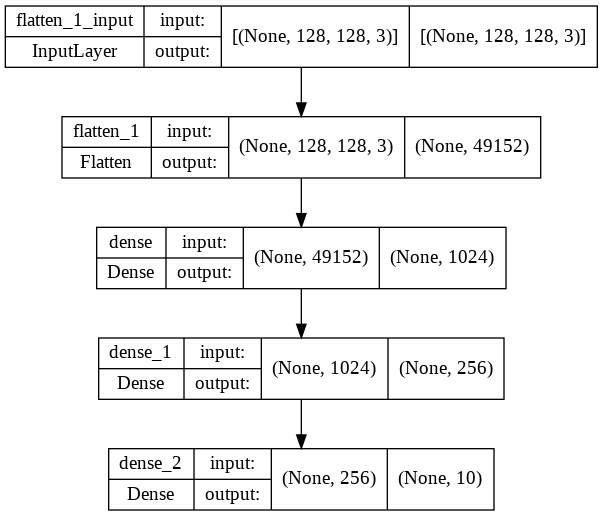

In [ ]:
tf.keras.utils.plot_model(model, to_file="model_ann.png", show_shapes=True)

In [ ]:
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

### 3.3 Training and Evaluation with Vanilla NN   

a. Let's train the model for 10 epochs

In [ ]:
epochs = 10
model_fit = model.fit(train_ds, validation_data=val_ds, epochs=epochs)

Epoch 1/10
96/96 [==============================] - 9s 66ms/step - loss: 16.9828 - accuracy: 0.2317 - val_loss: 2.9010 - val_accuracy: 0.3636
Epoch 2/10
96/96 [==============================] - 8s 75ms/step - loss: 2.2269 - accuracy: 0.3765 - val_loss: 2.0419 - val_accuracy: 0.3695
Epoch 3/10
96/96 [==============================] - 7s 64ms/step - loss: 2.0304 - accuracy: 0.3950 - val_loss: 1.9385 - val_accuracy: 0.3900
Epoch 4/10
96/96 [==============================] - 7s 65ms/step - loss: 1.9046 - accuracy: 0.4263 - val_loss: 1.7731 - val_accuracy: 0.4399
Epoch 5/10
96/96 [==============================] - 7s 65ms/step - loss: 1.5782 - accuracy: 0.4990 - val_loss: 1.8575 - val_accuracy: 0.4370
Epoch 6/10
96/96 [==============================] - 7s 65ms/step - loss: 1.5179 - accuracy: 0.5199 - val_loss: 2.0026 - val_accuracy: 0.3959
Epoch 7/10
96/96 [==============================] - 7s 64ms/step - loss: 1.6271 - accuracy: 0.4847 - val_loss: 1.9305 - val_accuracy: 0.4135
Epoch 8/10
9

### b. Did the training go well ?
- Lets plot the training and validation loss and accuracy curves

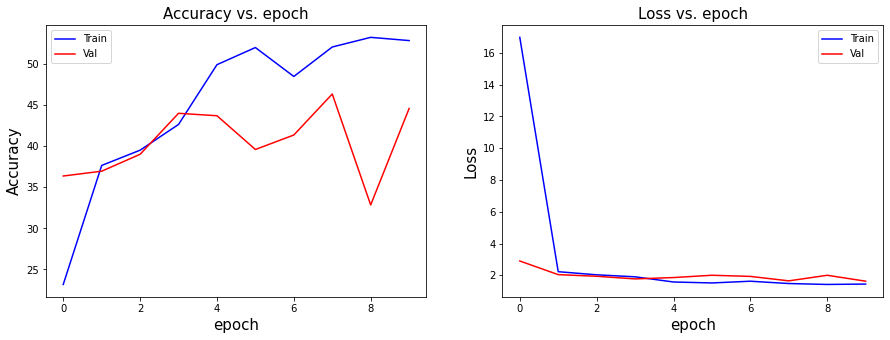

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(15,5))
ax = axes.ravel()

#accuracy graph
ax[0].plot(range(0,model_fit.params['epochs']), [acc * 100 for acc in model_fit.history['accuracy']], label='Train', color='b')
ax[0].plot(range(0,model_fit.params['epochs']), [acc * 100 for acc in model_fit.history['val_accuracy']], label='Val', color='r')
ax[0].set_title('Accuracy vs. epoch', fontsize=15)
ax[0].set_ylabel('Accuracy', fontsize=15)
ax[0].set_xlabel('epoch', fontsize=15)
ax[0].legend()

#loss graph
ax[1].plot(range(0,model_fit.params['epochs']), model_fit.history['loss'], label='Train', color='b')
ax[1].plot(range(0,model_fit.params['epochs']), model_fit.history['val_loss'], label='Val', color='r')
ax[1].set_title('Loss vs. epoch', fontsize=15)
ax[1].set_ylabel('Loss', fontsize=15)
ax[1].set_xlabel('epoch', fontsize=15)
ax[1].legend()

#display the graph
plt.show()

b. Let's evaluate it on Test Dataset

We will calculate accuracy and generate confustion-matrix on the Test Dataset!

In [ ]:
# load model from pretrained checkpoints (optional)
model.load_weights("/content/Saved Models/L1_ann_model.ckpt")

# run model prediction and obtain probabilities
y_pred = model.predict(test_ds)

# get list of predicted classes by taking argmax of the probabilities(y_pred)
predicted_categories = tf.argmax(y_pred, axis=1)

# get list of class names
class_names = test_data.class_names

# create list of all "y"s labels, by iterating over test dataset
true_categories = tf.concat([y for x, y in test_ds], axis=0)

# calculate accuracy
test_acc = metrics.accuracy_score(true_categories, predicted_categories) * 100
print(f'\nTest Accuracy: {test_acc:.2f}%\n')


Test Accuracy: 36.56%



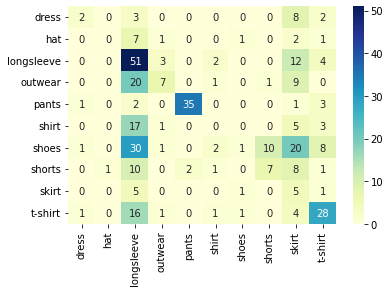

In [ ]:
def ConfusionMatrix(model, ds, label_list):
# Note: This logic doesn't work with shuffled datasets
    # run model prediction and obtain probabilities
    y_pred = model.predict(ds)
    # get list of predicted classes by taking argmax of the probabilities(y_pred)
    predicted_categories = tf.argmax(y_pred, axis=1)
    # create list of all "y"s labels, by iterating over test dataset
    true_categories = tf.concat([y for x, y in ds], axis=0)
    # generate confusion matrix and plot it
    cm = metrics.confusion_matrix(true_categories,predicted_categories) # last batch
    sns.heatmap(cm, annot=True, xticklabels=label_list, yticklabels=label_list, cmap="YlGnBu", fmt='g')
    plt.show()

ConfusionMatrix(model, test_ds, test_data.class_names)

c. Let's also plot few samples from test set along with their predicted softmax probabilities.

- We plot the image and the predicted array (as bar plot) side-by-side.
- The predicted array is the class probabilities (output from softmax layer) corresponding to 10 classes.
- If the tallest bar (argmax) in the bar-plot is the true label, we color it blue else it's colored red.
- Height of the bar plot indicates what's the probability of it predicting that label.

In [ ]:
# function to plot image given image, its true label and class probabilities (pred_array)
def plot_image(pred_array, true_label, img):
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])

  plt.imshow(img, cmap=plt.cm.binary)

  predicted_label = np.argmax(pred_array)
  if predicted_label == true_label:
    color = 'blue'
  else:
    color = 'red'

  plt.xlabel("{} {:2.0f}% ({})".format(class_names[predicted_label],
                                100*np.max(pred_array),
                                class_names[true_label]),
                                color=color)

# function to plot barplot of class probabilities (pred_array)
def plot_value_array(pred_array, true_label):
  plt.grid(False)
  plt.xticks(range(10))
  plt.yticks([])
  thisplot = plt.bar(range(10), pred_array, color="#777777")
  plt.ylim([0, 1])
  predicted_label = np.argmax(pred_array)

  thisplot[predicted_label].set_color('red')
  thisplot[true_label].set_color('blue')

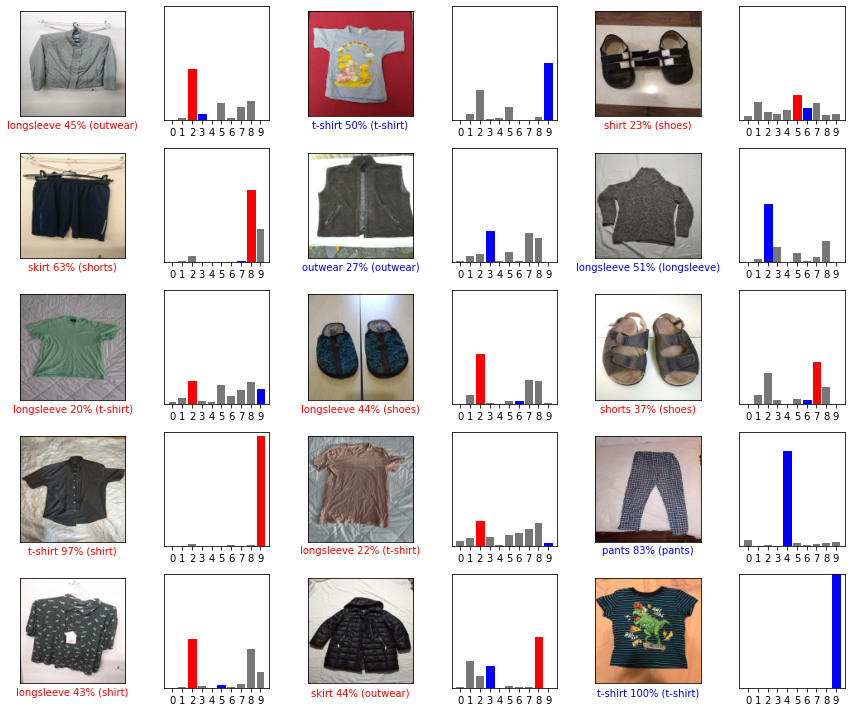

In [ ]:
true_categories = tf.concat([y for x, y in test_ds], axis=0)
images = tf.concat([x for x, y in test_ds], axis=0)
y_pred = model.predict(test_ds)
class_names = test_data.class_names

# Randomly sample 15 test images and plot it with their predicted labels, and the true labels.
indices = random.sample(range(len(images)), 15)
# Color correct predictions in blue and incorrect predictions in red.
num_rows = 5
num_cols = 3
num_images = num_rows*num_cols
plt.figure(figsize=(2*2*num_cols, 2*num_rows))
for i,index in enumerate(indices):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_image(y_pred[index], true_categories[index], images[index])
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_value_array(y_pred[index], true_categories[index])
plt.tight_layout()
plt.show()

### 3.4 Replacing Vanilla NN with CNNs  

- We saw hammering image data doesn't yield good results. Let's find the right set of tool that would do its job, aka CNNs.
- Let's replace the first dense layer with a simple convolution block, keeping everything else same.  
- A typical Convolution Block comprises of a `Conv2D` layer followed by a `MaxPooling2D` layer!    

*(Don't worry if you don't understand what all of this means, it will be explained in detail in later sections)*

a. Model Architecture  

In [ ]:
num_classes = 10
hidden_size = 256

model = keras.Sequential(
    name="model_cnn",
    layers=[
        layers.Conv2D(filters=16, kernel_size=3, strides=1, padding="same", activation='relu', input_shape=(height, width, 3)),
        layers.MaxPooling2D(),
        layers.Flatten(),
        layers.Dense(units=hidden_size, activation='relu'),
        layers.Dense(units=num_classes, activation='softmax')
    ]
)

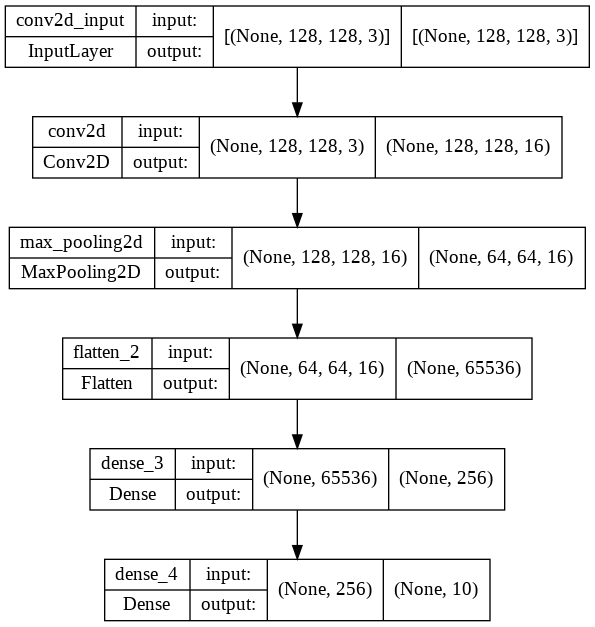

In [ ]:
tf.keras.utils.plot_model(model, to_file="model_cnn.png", show_shapes=True)

In [ ]:
model.summary()

Model: "model_cnn"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 16)       0         
 )                                                               
                                                                 
 flatten_2 (Flatten)         (None, 65536)             0         
                                                                 
 dense_3 (Dense)             (None, 256)               16777472  
                                                                 
 dense_4 (Dense)             (None, 10)                2570      
                                                                 
Total params: 16,780,490
Trainable params: 16,780,490
Non-trainable params: 0
_____________________________________________

b. Compile the model with **cross-entropy** loss and **adam** optimizer:

In [ ]:
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

### 3.5 Training and Evaluation with CNNs

a. Training for same 10 epochs

In [ ]:
epochs = 10
model_fit = model.fit(train_ds, validation_data=val_ds, epochs=epochs)

Epoch 1/10
96/96 [==============================] - 15s 65ms/step - loss: 4.6031 - accuracy: 0.3057 - val_loss: 2.0120 - val_accuracy: 0.3666
Epoch 2/10
96/96 [==============================] - 7s 64ms/step - loss: 1.6114 - accuracy: 0.4837 - val_loss: 1.6362 - val_accuracy: 0.4751
Epoch 3/10
96/96 [==============================] - 6s 63ms/step - loss: 1.3366 - accuracy: 0.5812 - val_loss: 1.5580 - val_accuracy: 0.5161
Epoch 4/10
96/96 [==============================] - 6s 63ms/step - loss: 1.0319 - accuracy: 0.6767 - val_loss: 1.4881 - val_accuracy: 0.5220
Epoch 5/10
96/96 [==============================] - 7s 64ms/step - loss: 0.8030 - accuracy: 0.7585 - val_loss: 1.4169 - val_accuracy: 0.5425
Epoch 6/10
96/96 [==============================] - 6s 63ms/step - loss: 0.5880 - accuracy: 0.8302 - val_loss: 1.4555 - val_accuracy: 0.5484
Epoch 7/10
96/96 [==============================] - 6s 63ms/step - loss: 0.4126 - accuracy: 0.9009 - val_loss: 1.3997 - val_accuracy: 0.5572
Epoch 8/10
9

b. How well the training go?  

Accuracy and Loss Plots on train/val datasets

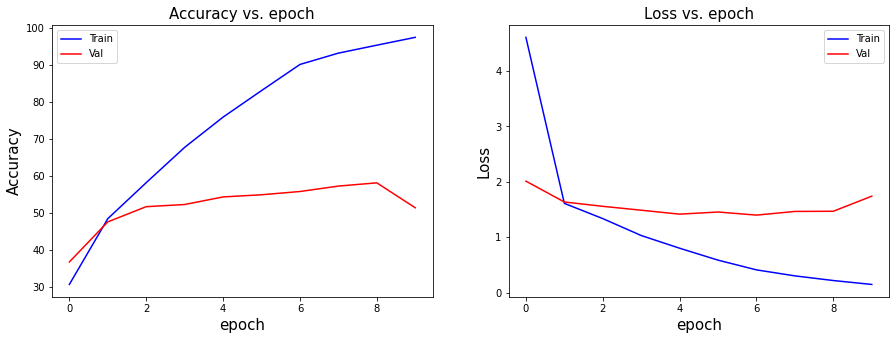

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(15, 5))
ax = axes.ravel()

#accuracy graph
ax[0].plot(range(0,model_fit.params['epochs']), [acc * 100 for acc in model_fit.history['accuracy']], label='Train', color='b')
ax[0].plot(range(0,model_fit.params['epochs']), [acc * 100 for acc in model_fit.history['val_accuracy']], label='Val', color='r')
ax[0].set_title('Accuracy vs. epoch', fontsize=15)
ax[0].set_ylabel('Accuracy', fontsize=15)
ax[0].set_xlabel('epoch', fontsize=15)
ax[0].legend()

#loss graph
ax[1].plot(range(0,model_fit.params['epochs']), model_fit.history['loss'], label='Train', color='b')
ax[1].plot(range(0,model_fit.params['epochs']), model_fit.history['val_loss'], label='Val', color='r')
ax[1].set_title('Loss vs. epoch', fontsize=15)
ax[1].set_ylabel('Loss', fontsize=15)
ax[1].set_xlabel('epoch', fontsize=15)
ax[1].legend()

#display the graph
plt.show()

c. Evaluation on Test Dataset  

Print Classification Report, Confusion Matrix and plot a few samples (with their probabilities)!

In [ ]:
# load model from pretrained checkpoints (optional)
model.load_weights("/content/Saved Models/L1_cnn_model.ckpt")

true_categories = tf.concat([y for x, y in test_ds], axis=0)
images = tf.concat([x for x, y in test_ds], axis=0)
y_pred = model.predict(test_ds)
class_names = test_data.class_names
predicted_categories = tf.argmax(y_pred, axis=1)

test_acc = metrics.accuracy_score(true_categories, predicted_categories) * 100
print(f'\nTest Accuracy: {test_acc:.2f}%\n')


Test Accuracy: 50.27%



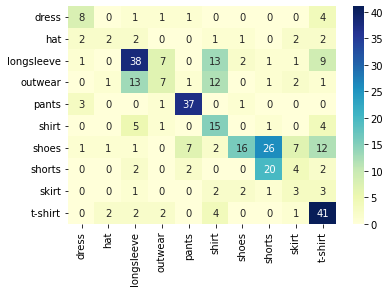

In [ ]:
ConfusionMatrix(model, test_ds, test_data.class_names)

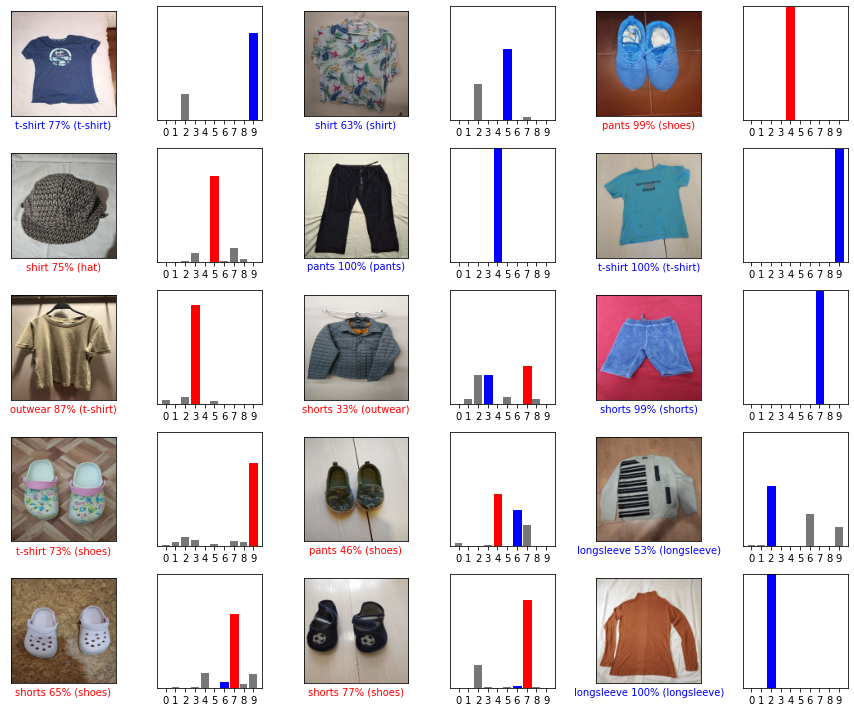

In [ ]:
true_categories = tf.concat([y for x, y in test_ds], axis=0)
images = tf.concat([x for x, y in test_ds], axis=0)
y_pred = model.predict(test_ds)
class_names = test_data.class_names

# Randomly sample 15 test images and plot it with their predicted labels, and the true labels.
indices = random.sample(range(len(images)), 15)
# Color correct predictions in blue and incorrect predictions in red.
num_rows = 5
num_cols = 3
num_images = num_rows*num_cols
plt.figure(figsize=(2*2*num_cols, 2*num_rows))
for i,index in enumerate(indices):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_image(y_pred[index], true_categories[index], images[index])
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_value_array(y_pred[index], true_categories[index])
plt.tight_layout()
plt.show()

### What is a 2D Kernel ?

><img src='https://drive.google.com/uc?id=1mQ95EJrwQ_5LoGGiAU-9pT29V0hiM5fg' height=350> <img src='https://drive.google.com/uc?id=1h5uJOQyvN2GQheJF9ost1uq6SBj9Lyjz' height=350>



- A kernel can be visualized as a small matrix that slides across, from left-to-right and top-to-bottom, of a larger image.
- At each pixel in the input image, the neighborhood of the image
is convolved with the kernel and the output stored.
- Inshort, a kernel find relations within the neighbouring pixels in its area iteratively and once the finishes sliding over the image, it is able to correlate certain features in a image
- For example :
    - We have an image of a car on a road, the kernel when sliding over the image wil be able to identify the edges (shape) of a car, by correlating the pixels between the car and the road.
### **Let's see how can we make Computer to detect vertical edges ?**

><img src='https://drive.google.com/uc?id=1OoNlFfmCNyky1bXHDmc4KpWoJiPCqJDY' height=250>




#### By using APPROPRIATE kernels/filters.

Let's try to apply the Sobel vertical edge filter ourselves on the image above and see the results !

In [ ]:
# Downloading the image
!gdown 1TE-0GfSsWXaau_sMwO5_RgB84SSylOyk

Downloading...
From: https://drive.google.com/uc?id=1TE-0GfSsWXaau_sMwO5_RgB84SSylOyk
To: /content/cycle_people.png
100% 16.2k/16.2k [00:00<00:00, 29.1MB/s]


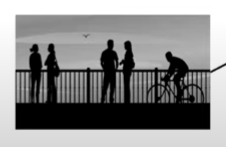

In [ ]:
# Importing necessary libraries
import cv2
from google.colab.patches import cv_imshow

# Reading the image file using OpenCV
img = cv2.imread('/content/cycle_people.png')

# Displaying the input image
cv_imshow(img)

Let's now use the cv2.Sobel() function to apply the Sobel vertical edge filter on the above image

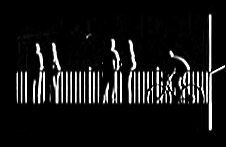

In [ ]:
# Apply the Sobel filter

# The ddpeth parameter specifies the desired depth of the output image. In this case, it is set to 64-bit floating point values.
# dx and dy parameters specify the order of derivative to be taken in the x and y directions respectively.
# kzise parameter specifies the size of the Sobel filter
output = cv2.Sobel(img, ddepth = cv2.CV_64F, dx = 1, dy = 0, ksize = 3)

# Displaying the output image
cv_imshow(output)

# L2: Dealing with Overfitting

### Setup

#### Download Data

We are going to use the same collection of real-world clothing images dataset as in the first lecture, opensourced [here](https://github.com/alexeygrigorev/clothing-dataset-small).  

You can read more about the dataset in this [blog post](https://medium.com/data-science-insider/clothing-dataset-5b72cd7c3f1f).

In [ ]:
!gdown https://drive.google.com/uc?id=1XdXz0TKo_KCDRHOMvzV-YtcTx7NPG-jC

Downloading...
From: https://drive.google.com/uc?id=1XdXz0TKo_KCDRHOMvzV-YtcTx7NPG-jC
To: /content/clothing-dataset-small.zip
100% 106M/106M [00:01<00:00, 93.7MB/s]


In [ ]:
!unzip /content/clothing-dataset-small.zip

Archive:  /content/clothing-dataset-small.zip
   creating: clothing-dataset-small/
  inflating: clothing-dataset-small/.DS_Store  
   creating: clothing-dataset-small/test/
   creating: clothing-dataset-small/test/skirt/
  inflating: clothing-dataset-small/test/skirt/f4b934fc-e326-4f72-b535-53288b8b82d3.jpg  
  inflating: clothing-dataset-small/test/skirt/491982c3-3e90-431e-99e6-b14ecea36384.jpg  
  inflating: clothing-dataset-small/test/skirt/24963db3-649c-4f04-8da3-0375ede8e0a6.jpg  
  inflating: clothing-dataset-small/test/skirt/32b99302-cec7-4dec-adfa-3d4029674209.jpg  
  inflating: clothing-dataset-small/test/skirt/0558b2c5-be00-49de-b27f-8c88114ac36f.jpg  
  inflating: clothing-dataset-small/test/skirt/95e66e02-b4ed-4fe9-b538-db6bac4fb7df.jpg  
  inflating: clothing-dataset-small/test/skirt/2001dec1-1e0a-4c11-9d15-120b019b3dea.jpg  
  inflating: clothing-dataset-small/test/skirt/b0e05193-cc92-4935-88d7-e71a1b19dd4b.jpg  
  inflating: clothing-dataset-small/test/skirt/309829b2-6d1

#### Import Statements

In [ ]:
import os
import numpy as np
import tensorflow as tf
tf.keras.utils.set_random_seed(111)
from tensorflow import keras
from tensorflow.keras import layers, regularizers
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn.metrics as metrics
%matplotlib inline

### Baseline Model

This is the same CNN model which we used in the previous module to train our clothing dataset.

Loading Data

In [ ]:
def load_data(base_dir="clothing-dataset-small"):
    # checking if the data folders are present
    assert os.path.exists(f"{base_dir}/train") and os.path.exists(f"{base_dir}/validation") and os.path.exists(f"{base_dir}/test")

    print('\nLoading Data...')
    train_data = tf.keras.utils.image_dataset_from_directory(
        f"{base_dir}/train", shuffle=True, label_mode='categorical'
    )
    val_data = tf.keras.utils.image_dataset_from_directory(
        f"{base_dir}/validation", shuffle=False, label_mode='categorical'
    )
    test_data = tf.keras.utils.image_dataset_from_directory(
        f"{base_dir}/test", shuffle=False, label_mode='categorical'
    )
    return train_data, val_data, test_data, train_data.class_names

In [ ]:
train_data, val_data, test_data, class_names = load_data()


Loading Data...
Found 3068 files belonging to 10 classes.
Found 341 files belonging to 10 classes.
Found 372 files belonging to 10 classes.


Data Preprocessing: Resizing, Standardization

In [ ]:
def preprocess(train_data, val_data, test_data, target_height=128, target_width=128):

    # Data Processing Stage with resizing and rescaling operations
    data_preprocess = keras.Sequential(
        name="data_preprocess",
        layers=[
            layers.Resizing(target_height, target_width),
            layers.Rescaling(1.0/255),
        ]
    )

    # Perform Data Processing on the train, val, test dataset
    train_ds = train_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)
    val_ds = val_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)
    test_ds = test_data.map(lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE)

    return train_ds, val_ds, test_ds

In [ ]:
train_ds, val_ds, test_ds = preprocess(train_data, val_data, test_data)

Model Architecture

In [ ]:
def baseline(height=128, width=128):
    num_classes = 10
    hidden_size = 256

    model = keras.Sequential(
        name="model_cnn",
        layers=[
            layers.Conv2D(filters=16, kernel_size=3, padding="same", activation='relu', input_shape=(height, width, 3)),
            layers.MaxPooling2D(),
            layers.Flatten(),
            layers.Dense(units=hidden_size, activation='relu'),
            layers.Dense(units=num_classes, activation='softmax')
        ]
    )
    return model

In [ ]:
model = baseline()
model.summary()

Model: "model_cnn"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2  (None, 64, 64, 16)        0         
 D)                                                              
                                                                 
 flatten (Flatten)           (None, 65536)             0         
                                                                 
 dense (Dense)               (None, 256)               16777472  
                                                                 
 dense_1 (Dense)             (None, 10)                2570      
                                                                 
Total params: 16780490 (64.01 MB)
Trainable params: 16780490 (64.01 MB)
Non-trainable params: 0 (0.00 Byte)
_______________

Compile and Train

In [ ]:
def compile_train_v1(model, train_ds, val_ds, ckpt_path="/tmp/checkpoint"):
    epochs = 10
    model.compile(optimizer='adam',
                loss='categorical_crossentropy',
                metrics=['accuracy'])

    model_fit = model.fit(train_ds, validation_data=val_ds, epochs=epochs, callbacks=[
        keras.callbacks.ModelCheckpoint(ckpt_path, save_weights_only=True, monitor='val_accuracy', mode='max', save_best_only=True),
    ])
    return model_fit

In [ ]:
model_fit = compile_train_v1(model, train_ds, val_ds)

Epoch 1/10
96/96 [==============================] - 94s 942ms/step - loss: 2.7191 - accuracy: 0.3181 - val_loss: 1.8600 - val_accuracy: 0.3959
Epoch 2/10
96/96 [==============================] - 59s 607ms/step - loss: 1.5122 - accuracy: 0.5140 - val_loss: 1.6450 - val_accuracy: 0.4663
Epoch 3/10
96/96 [==============================] - 56s 578ms/step - loss: 1.0537 - accuracy: 0.6776 - val_loss: 1.4735 - val_accuracy: 0.5367
Epoch 4/10
96/96 [==============================] - 63s 647ms/step - loss: 0.6668 - accuracy: 0.8028 - val_loss: 1.5122 - val_accuracy: 0.5748
Epoch 5/10
96/96 [==============================] - 63s 657ms/step - loss: 0.3689 - accuracy: 0.9091 - val_loss: 1.4431 - val_accuracy: 0.5865
Epoch 6/10
96/96 [==============================] - 56s 583ms/step - loss: 0.1827 - accuracy: 0.9677 - val_loss: 1.5148 - val_accuracy: 0.6012
Epoch 7/10
96/96 [==============================] - 62s 628ms/step - loss: 0.1175 - accuracy: 0.9778 - val_loss: 1.7681 - val_accuracy: 0.5630

Plot Train and Validation Accuracy

In [ ]:
# helper function to annotate maximum values in the plots
def annot_max(x,y, xytext=(0.94,0.96), ax=None, only_y=True):
    xmax = x[np.argmax(y)]
    ymax = max(y)
    if only_y:
        text = "{:.2f}%".format(ymax)
    else:
        text= "x={:.2f}, y={:.2f}%".format(xmax, ymax)
    if not ax:
        ax=plt.gca()
    bbox_props = dict(boxstyle="square,pad=0.3", fc="w", ec="k", lw=0.72)
    arrowprops=dict(arrowstyle="->",connectionstyle="angle,angleA=0,angleB=60")
    kw = dict(xycoords='data',textcoords="axes fraction",
              arrowprops=arrowprops, bbox=bbox_props, ha="right", va="top")
    ax.annotate(text, xy=(xmax, ymax), xytext=xytext, **kw)

def plot_accuracy(model_fit):
    #accuracy graph
    x = range(0,len(model_fit.history['accuracy']))
    y_train = [acc * 100 for acc in model_fit.history['accuracy']]
    y_val = [acc * 100 for acc in model_fit.history['val_accuracy']]

    plt.plot(x, y_train, label='Train', color='b')
    annot_max(x, y_train, xytext=(0.7,0.9))
    plt.plot(x, y_val, label='Val', color='r')
    annot_max(x, y_val, xytext=(0.8,0.7))
    plt.ylabel('Accuracy', fontsize=15)
    plt.xlabel('epoch', fontsize=15)
    plt.legend()
    plt.show()

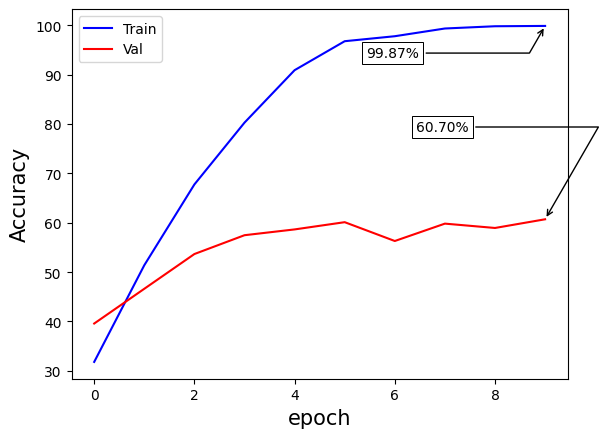

In [ ]:
plot_accuracy(model_fit)

Analyze Result on Test Dataset

In [ ]:
def print_accuracy_stats(model, ds, class_names):
    model.load_weights("/tmp/checkpoint")
    true_onehot = tf.concat([y for x, y in ds], axis=0)
    true_categories = tf.argmax(true_onehot, axis=1)
    y_pred = model.predict(ds)
    predicted_categories = tf.argmax(y_pred, axis=1)

    test_acc = metrics.accuracy_score(true_categories, predicted_categories) * 100
    print(f'\nTest Accuracy: {test_acc:.2f}%\n')

# Note: This doesn't work with shuffled datasets
def plot_confusion_matrix(model, ds, class_names):
    model.load_weights("/tmp/checkpoint")
    true_onehot = tf.concat([y for x, y in ds], axis=0)
    true_categories = tf.argmax(true_onehot, axis=1)
    y_pred = model.predict(ds)
    predicted_categories = tf.argmax(y_pred, axis=1)
    cm = metrics.confusion_matrix(true_categories,predicted_categories) # last batch
    sns.heatmap(cm, annot=True, xticklabels=class_names, yticklabels=class_names, cmap="YlGnBu", fmt='g')
    plt.show()

12/12 [==============================] - 2s 144ms/step

Test Accuracy: 52.15%

12/12 [==============================] - 2s 197ms/step


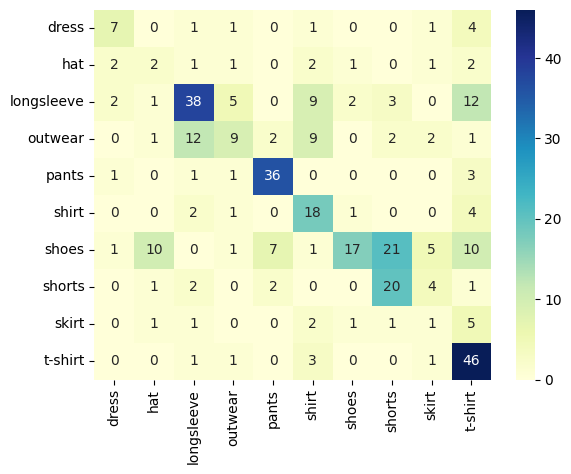

In [ ]:
print_accuracy_stats(model, test_ds, class_names)
plot_confusion_matrix(model, test_ds, class_names)


## **1.** Modifications in Model Pipeline

The baseline network has ~17 million parameters and just over 3000 images for training. This results in overparamterization of the network making it prone to overfit. One way to tackle this would be to remove some layers from the network. But since it's already a small network, that would badly affect the performance on both training/validation set (You can try yourself to see that!). So what else can we do?

***HINT: Look at `model.summary()` carefully!***

We find that over ~99% of the parameters are associated with just one layer, and that's not even the Convolutional layer. Although we introduced CNN in the model architecture, the number of trainable parameters as a result of that is just ~5000 which is 1000 times less than that of the Dense Layers in the architecture.

The reason for it is that when we flatten the 3D matrix of shape 32x32x32 into 1D, the number of connections from that layer to dense layer explodes exponentially (no weight sharing in MLP).

In order to avoid this, we will try do two things:
1. Reduce the 3D volume before the flatten layer by using more Convolution blocks.
2. Replace the flatten layer by `GlobalAveragePooling2D`  



<img src='https://drive.google.com/uc?id=1ys5_E-9FiC9MqtHldydDnn15huJibLua' height=350>

- 2D Global average pooling block takes a input tensor of size (input width) x (input height) x (input channels)
- computes the average value of all values across the (input width) x (input height) matrix for each of the (input channels).

### **Modification #1**

In [ ]:
def arch_1(height=128, width=128):
    num_classes = 10
    hidden_size = 256

    model = keras.Sequential(
        name="model_cnn_1",
        layers=[
            layers.Conv2D(filters=16, kernel_size=3, padding="same", activation='relu', input_shape=(height, width, 3)),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=32, kernel_size=3, padding="same", activation='relu'),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=64, kernel_size=3, padding="same", activation='relu'),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=128, kernel_size=3, padding="same", activation='relu'),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=256, kernel_size=3, padding="same", activation='relu'),
            # layers.MaxPooling2D(),
            # layers.Flatten(),
            layers.GlobalAveragePooling2D(),
            layers.Dense(units=hidden_size, activation='relu'),
            layers.Dense(units=num_classes, activation='softmax')
        ]
    )
    return model

In [ ]:
model = arch_1()
model.summary()

Model: "model_cnn_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 128, 128, 16)      448       
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 64, 64, 16)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 64, 64, 32)        4640      
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 32, 32, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_3 (Conv2D)           (None, 32, 32, 64)        18496     
                                                                 
 max_pooling2d_3 (MaxPoolin  (None, 16, 16, 64)        

In [ ]:
def compile_train_v1(model, train_ds, val_ds, epochs=10, ckpt_path="/tmp/checkpoint"):
    model.compile(optimizer='adam',
                loss='categorical_crossentropy',
                metrics=['accuracy'])

    model_fit = model.fit(train_ds, validation_data=val_ds, epochs=epochs, callbacks=[
        keras.callbacks.ModelCheckpoint(ckpt_path, save_weights_only=True, monitor='val_accuracy', mode='max', save_best_only=True),
    ])
    return model_fit

In [ ]:
model_fit = compile_train_v1(model, train_ds, val_ds)

Epoch 1/10
96/96 [==============================] - 94s 960ms/step - loss: 2.1248 - accuracy: 0.2533 - val_loss: 2.1774 - val_accuracy: 0.2405
Epoch 2/10
96/96 [==============================] - 76s 789ms/step - loss: 2.0683 - accuracy: 0.2816 - val_loss: 2.0834 - val_accuracy: 0.2581
Epoch 3/10
96/96 [==============================] - 73s 754ms/step - loss: 1.9229 - accuracy: 0.3478 - val_loss: 1.9395 - val_accuracy: 0.3284
Epoch 4/10
96/96 [==============================] - 72s 746ms/step - loss: 1.7744 - accuracy: 0.4029 - val_loss: 1.8110 - val_accuracy: 0.4018
Epoch 5/10
96/96 [==============================] - 71s 727ms/step - loss: 1.6551 - accuracy: 0.4400 - val_loss: 1.7264 - val_accuracy: 0.4223
Epoch 6/10
96/96 [==============================] - 72s 749ms/step - loss: 1.5256 - accuracy: 0.4909 - val_loss: 1.6102 - val_accuracy: 0.4721
Epoch 7/10
96/96 [==============================] - 73s 754ms/step - loss: 1.4037 - accuracy: 0.5316 - val_loss: 1.5607 - val_accuracy: 0.4692

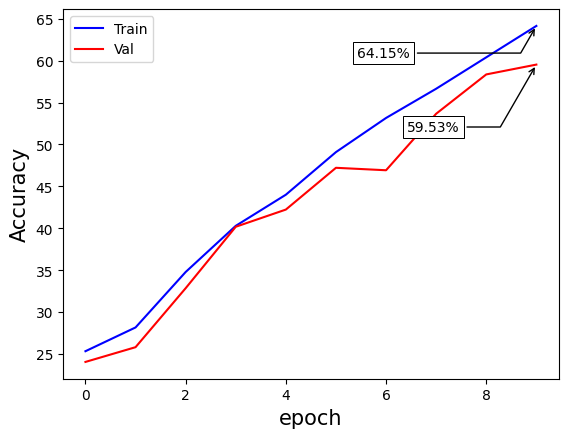

In [ ]:
plot_accuracy(model_fit)


**Unbelievable!**  
With just two modifications in the architecture, we can see the model performing much better and the problem of overfitting vanish.  

This is good news, but something seems not right about the above plots!   
#### **Can you guess what is wrong with the above plots?**  

It seems the model was still improving when we stopped training leading to ***underfitting***!  
So, let's continue training for more number of epochs. **But how many more epochs?**  

The answer is that *we do not know*. But perhaps we can guess, by looking at the training plots. **Can you?**   

- We can stop when the val loss/accuracy curve flattens out (or do not improve any further)!  
- This technique is better known as "early stopping" and `keras` provides a readymade function for that.
- Effectively, it stops model training, once the condition set by `EarlyStopping` is met.
- Conditions could be based on either validation loss or accuracy numbers.
- The `patience` argument determines that after how many "epochs with no improvement", training should be stopped.

Let's plugin this into our training pipeline and see if it improves the result. [not implemented yet!]

In [ ]:
model_fit = compile_train_v1(model, train_ds, val_ds, epochs=30)

Epoch 1/30
96/96 [==============================] - 73s 742ms/step - loss: 0.9657 - accuracy: 0.6773 - val_loss: 1.1646 - val_accuracy: 0.6012
Epoch 2/30
96/96 [==============================] - 70s 719ms/step - loss: 0.8968 - accuracy: 0.6972 - val_loss: 1.1622 - val_accuracy: 0.6012
Epoch 3/30
96/96 [==============================] - 71s 726ms/step - loss: 0.8385 - accuracy: 0.7125 - val_loss: 1.0839 - val_accuracy: 0.6364
Epoch 4/30
96/96 [==============================] - 72s 748ms/step - loss: 0.8122 - accuracy: 0.7246 - val_loss: 1.1318 - val_accuracy: 0.6246
Epoch 5/30
96/96 [==============================] - 69s 716ms/step - loss: 0.7355 - accuracy: 0.7454 - val_loss: 1.0647 - val_accuracy: 0.6510
Epoch 6/30
96/96 [==============================] - 71s 727ms/step - loss: 0.7119 - accuracy: 0.7487 - val_loss: 1.1862 - val_accuracy: 0.6305
Epoch 7/30
96/96 [==============================] - 71s 739ms/step - loss: 0.6591 - accuracy: 0.7699 - val_loss: 1.0208 - val_accuracy: 0.6686

In [ ]:
plot_accuracy(model_fit)

In [ ]:
print_accuracy_stats(model, test_ds, class_names)
plot_confusion_matrix(model, test_ds, class_names)


### **Modification #2**
1. Add Batch Normalization after every `Conv2D` and `Dense` layers.
2. Add `Dropout` after `Dense` layers

#### **Q. What is Dropout and why is it required?**
- Drops out random neurons from the network during training
- Dropout reduces overfitting by :
    - Reducing over - reliability of the network on using certain features to identify in a image
    - Dropout thus encourages the network to utilize all the features to find pattern in a image
    - Thus increasing overall generalization of our model, thus giving good model performance


- Dropout is only used during training and not while evaluating our model as
    - We want to use the capability of every learned neurons and really don't like to skip some of them randomly.

<center><img src='https://drive.google.com/uc?id=1P0w9g-BuTHUCWQ6Xcz7A_lei_bQfdTX-' height=280></center>

#### **Q. What is Batch Normalization?**
- Simply put, it normalizes the inputs to each layer to a learnt representation likely close to μ = 0.0, σ = 1.0 wrt every minibatch.
- It's a four-step process as described below:

<center><img src='https://t3638486.p.clickup-attachments.com/t3638486/c04a328b-8726-4bce-9f8d-b121e0e157ba/image.png' height=200>
<img src='https://drive.google.com/uc?id=12DwZw4uWID62jT6PJHlmzhKeEe9plhxe' height=300></center>

#### **Q. Why Batch Normalization?**

- In simple terms, just like input normalization, if all the layer inputs are normalized, then the significant outliers are less likely to impact the training process in a negative way.
- And if they do, their impact will be much lower than without using Batch Normalization.
- This inturn makes model less sensitive to hyperparameter tuning (for eg: larger LRs won't affect much the training process).

#### **Q. How Batch Normalization Behaves during Inference?**

- When inferring e.g. the class for a new sample, you wish to normalize it based on the entire training set, as it produces better estimates and is computationally feasible.

- Hence, during inference, the Batch Normalization step goes as follows:
<center><img src='https://t3638486.p.clickup-attachments.com/t3638486/e58670bb-997f-4acb-9909-534ec0536e1d/image.png' height=100></center>, where, 𝑥∈𝑋  and 𝑋 represents the full training data.

#### **Q. Now that we have understood Dropout and BN, where should we add it to our model?**

- Emperically it has been found out that dropout works best when it is placed in-between Dense layers of an architecture with a probability of 0.5.
- Sometimes adding dropout layers after MaxPooling Layer with lower probability (0.1 to 0.25) also enhances performance.
- These are not hard-set rules, rather standard practices which people tend to follow.

- As for BatchNorm, the original paper suggested to add BN layer just after Conv Layer and before non-linearity, but later-on it was experimentally found out that placing BN layers after non-linear layers worked better.

- Other reasoning for placing BN after both Conv and non-linear layers like ReLU comes from Statistics. If we normalize the feature distribution right after Conv Layer and pass it to the ReLU block, it will clamp the negative values from BN output to 0, effectively changing the distribution itself and defeating the purpose of normalization.




In [ ]:
def arch_2(height=128, width=128):
    num_classes = 10
    hidden_size = 256

    model = keras.Sequential(
        name="model_cnn_2",
        layers=[
            layers.Conv2D(filters=16, kernel_size=3, padding="same", input_shape=(height, width, 3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=32, kernel_size=3, padding="same"),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=64, kernel_size=3, padding="same"),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=128, kernel_size=3, padding="same"),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=256, kernel_size=3, padding="same"),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            # layers.MaxPooling2D(),
            # layers.Flatten(),
            layers.GlobalAveragePooling2D(),
            layers.Dense(units=hidden_size),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.Dropout(0.5),
            layers.Dense(units=num_classes, activation='softmax')
        ]
    )
    return model

In [ ]:
model = arch_2()
model.summary()

In [ ]:
model_fit = compile_train_v1(model, train_ds, val_ds, epochs=30)

In [ ]:
plot_accuracy(model_fit)

**WAIT, WAIT..SOMETHING AIN'T RIGHT HERE...**   

We see the training is not very stable here (too many fluctuations)! This was "kinda" expected since we added more chaos to the training process, for example "dropout" switches off 20% of connections randomly at every step.


*Note: Every regularization technique induces some form of chaos to the training process.*  

#### Q.**How to solve this issue?**

**Rule of Thumb:** Fluctuating (heartbeat) plots imply that the learning rate is too high.  

So, we can try tuning it. Or a better alternative is to use a Learning Rate Scheduler and let the model train until the loss/accuracy curve flattens out (also called Early Stopping).

In Keras, we can simply add both LR Scheduler and Early Stopping as a callback to `model.fit`.

<br><br>



### **Modification #3**

#### 1. Use `ReduceLROnPlateau` as LR Scheduler and `EarlyStopping` to stop training once the loss curve plateaus.


In [ ]:
def compile_train_v2(model, train_ds, val_ds, epochs=10, ckpt_path="/tmp/checkpoint"):
    callbacks = [
        keras.callbacks.ReduceLROnPlateau(
            monitor="val_loss", factor=0.3, patience=5, min_lr=0.00001
        ),
        keras.callbacks.ModelCheckpoint(ckpt_path, save_weights_only=True, monitor='val_accuracy', mode='max', save_best_only=True),
        keras.callbacks.EarlyStopping(
            monitor="val_loss", patience=10, min_delta=0.001, mode='min'
        )
    ]
    model.compile(optimizer='adam',
                loss='categorical_crossentropy',
                metrics=['accuracy'])
    model_fit = model.fit(train_ds, validation_data=val_ds, epochs=epochs, callbacks=callbacks)
    return model_fit

In [ ]:
model = arch_2()
model_fit = compile_train_v2(model, train_ds, val_ds, epochs=100)

In [ ]:
plot_accuracy(model_fit)

In [ ]:
print_accuracy_stats(model, test_ds, class_names)
plot_confusion_matrix(model, test_ds, class_names)

### **Modification #4**
#### using regularization


<img src='https://drive.google.com/uc?id=10kKlUkyr849jz9bzz_5Wcb55DvK1mvKc' height=150>

<br>

**Ridge regularization (L2)**

<img src='https://drive.google.com/uc?id=1Be9BvuJDV6gzO8PJtwZjMz3blG6pLczd' height=70>

Add L2 regularization to `Conv2D` and `Dense` layers

In [ ]:
def arch_3(height=128, width=128):
    num_classes = 10
    hidden_size = 256

    model = keras.Sequential(
        name="model_cnn_3",
        layers=[
            layers.Conv2D(filters=16, kernel_size=3, padding="same", input_shape=(height, width, 3),
                            kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=32, kernel_size=3, padding="same",
                            kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=64, kernel_size=3, padding="same",
                            kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=128, kernel_size=3, padding="same",
                            kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.MaxPooling2D(),
            layers.Conv2D(filters=256, kernel_size=3, padding="same",
                            kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            # layers.MaxPooling2D(),
            # layers.Flatten(),
            layers.GlobalAveragePooling2D(),
            layers.Dense(units=hidden_size, kernel_regularizer=regularizers.l2(1e-3)),
            layers.Activation("relu"),
            layers.BatchNormalization(),
            layers.Dropout(0.5),
            layers.Dense(units=num_classes, activation='softmax')
        ]
    )
    return model

In [ ]:
model = arch_3()
model.summary()

In [ ]:
model_fit = compile_train_v2(model, train_ds, val_ds, epochs=100)

In [ ]:
plot_accuracy(model_fit)

In [ ]:
print_accuracy_stats(model, test_ds, class_names)
plot_confusion_matrix(model, test_ds, class_names)

## Modifications in Data Pipeline (Data Augmentation)

#### What is Augmentation?

- Augmentation is a technique to `artificially increase` the amount of data by generating new data points from `existing data`.

**How can we increase the data from existing data?**  

- By making Minor changes such as `flips, translations,brigntness,coloring, rotations etc`.

<img src='https://drive.google.com/uc?id=15SJ7_ImxN3Ouzdx6T921JtFg0mS0P_Z4' height=200>



**How does it help with training?**  

- This leads to greater diversity of data samples being seen by the network hence decreasing the likelihood of overfitting the model on the training dataset.

- Also it helps in reducing some of the spurious characteristics of the dataset.

#### What different sort of Augmentation strategies we can apply?

Some most common data augmentations are:
* padding
* random rotating
* re-scaling,
* vertical and horizontal flipping
* translation ( image is moved along X, Y direction)
* cropping
* zooming
* darkening & brightening/color modification
* grayscaling
* changing contrast
* adding noise
* random erasing

We will discuss some of them in detail here, along with their code in `Keras`.

#### How do we apply augmentation in `tensorflow` / `keras`?

There are many ways to apply augmentation in Tensorflow/Keras, few of them are discussed here:
1. using the Keras Preprocessing Layers, just like preprocessing functions like `resizing` and `rescaling`, keras also provides data augmentation layers like `tf.keras.layers.RandomFlip`,  `tf.keras.layers.RandomRotation`, etc. These can be used in a similar way as we used the preprocessing functions.
2. using tf.image methods like `tf.image.stateless_random_flip_up_down`, `tf.image.stateless_random_brightness`
3. using Keras ImageDataGenerator API - It provides quick, out-of-the-box suite of augmentation techniques like standardization, rotation, shifts, flips, brightness change, and many more.

In this module, we will be using mostly option 1. Keras Preprocessing Layers for data augmentation.

In [ ]:
def preprocess_v2(train_data, val_data, test_data, target_height=128, target_width=128):

    # Data Processing Stage with resizing and rescaling operations #same as before for test,val
    data_preprocess = keras.Sequential(
        name="data_preprocess",
        layers=[
            layers.Resizing(target_height, target_width),
            layers.Rescaling(1.0/255),
        ]
    )

    # Data Processing Stage with resizing and rescaling operations
    data_augmentation = keras.Sequential(
        name="data_augmentation",
        layers=[
            layers.Resizing(156, 156), # First resize to 156,156
            layers.RandomCrop(target_height, target_width), # Then randomly crop 128,128 region
            # layers.RandomBrightness(0.2), # Modify brightness by 0.2 factor
            layers.Rescaling(1.0/255), # Finally rescale
        ]
    )

    # Perform Data Processing on the train, val, test dataset
    train_ds = train_data.map(
        lambda x, y: (data_augmentation(x), y), num_parallel_calls=tf.data.AUTOTUNE
    ).prefetch(tf.data.AUTOTUNE)
    val_ds = val_data.map(
        lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE
    ).prefetch(tf.data.AUTOTUNE)
    test_ds = test_data.map(
        lambda x, y: (data_preprocess(x), y), num_parallel_calls=tf.data.AUTOTUNE
    ).prefetch(tf.data.AUTOTUNE)

    return train_ds, val_ds, test_ds

In [ ]:
train_ds, val_ds, test_ds = preprocess_v2(train_data, val_data, test_data)

In [ ]:
model = arch_3()
model.summary()

In [ ]:
model_fit = compile_train_v2(model, train_ds, val_ds, epochs=100)

In [ ]:
plot_accuracy(model_fit)

In [ ]:
print_accuracy_stats(model, test_ds, class_names)
plot_confusion_matrix(model, test_ds, class_names)

# L3: CNN under the Hood

In [ ]:
#Importing required Modules
import random
import numpy as np
from scipy import signal
import matplotlib.pyplot as plt
from keras.datasets import mnist
from keras.utils import np_utils

Defining our Base class Layer to specify the default layer properties that will be inherited to our Convolutional, Reshape, MaxPool, activation classes which will be derived from the Layer class.
<br> The Layer class has two attributes:
* forward : which takes in the input to the layer and returns the output via specified calculation for each layer
* backward : which takes in the output gradient to update the layer's parameters and return the input gradient

In [ ]:
#Base layer class to specify the Layer properites for our Reshape and Convolution Layer to inherit
class Layer:
    def __init__(self):
        self.input = None
        self.output = None
    def forward(self, input):
        # TODO: return output
        pass

    def backward(self, output_gradient, learning_rate):
        # TODO: update parameters and return input gradient
        pass

In [ ]:
class Convolutional(Layer):
    def __init__(self, input_shape, kernel_size, depth):
        #Input_shape is 3 dimensional (dxhxw), input depth representing no. of image input channels, input_height = image height and input_width = image width
        input_depth, input_height, input_width = input_shape
        #Depth represents the number of kernels of our convolutional layer
        self.depth = depth
        self.input_shape = input_shape
        #Number of channels in the image, i.e. 3 in a RGB image, 2 in a grayscale image
        self.input_depth = input_depth
        #Calculating our conv. layer output of 3 dimensions, first dim = number of filters/kernels,
        #second dim = height of the output matrix after applying convolution i.e input image height - kernel size + 1 by rule
        self.output_shape = (depth, input_height - kernel_size + 1, input_width - kernel_size + 1)
        #Kernels shape specifies the shape of the kernels produced, 4 dimensions depth = no. of kernels, input_depth = image channels, kernel_size = kernel dimension
        self.kernels_shape = (depth, input_depth, kernel_size, kernel_size)
        #Initalizing the Kernels weights randomly
        self.kernels = np.random.randn(*self.kernels_shape)
        #Initializing the biases randomly
        self.biases = np.random.rand(*self.output_shape)


    def forward(self, input):
        pass
        #TODO

    def backward(self, output_gradient, learning_rate):
        pass
        #TODO


- After taking in these parameters, the Convolutional layer processes the inputs through our forward and backward functions while training our model.



In [ ]:
class Convolutional(Layer):
    def __init__(self, input_shape, kernel_size, depth):
        #Input_shape is 3 dimensional (dxhxw), input depth representing no. of image input channels, input_height = image height and input_width = image width
        input_depth, input_height, input_width = input_shape
        #Depth represents the number of kernels of our convolutional layer
        self.depth = depth
        self.input_shape = input_shape
        #Number of channels in the image, i.e. 3 in a RGB image, 2 in a grayscale image
        self.input_depth = input_depth
        #Calculating our conv. layer output of 3 dimensions, first dim = number of filters/kernels,
        #second dim = height of the output matrix after applying convolution i.e input image height - kernel size + 1 by rule
        self.output_shape = (depth, input_height - kernel_size + 1, input_width - kernel_size + 1)
        #Kernels shape specifies the shape of the kernels produced, 4 dimensions depth = no. of kernels, input_depth = image channels, kernel_size = kernel dimension
        self.kernels_shape = (depth, input_depth, kernel_size, kernel_size)
        #Initalizing the Kernels weights randomly
        self.kernels = np.random.randn(*self.kernels_shape)
        #Initializing the biases randomly
        self.biases = np.random.rand(*self.output_shape)

    #Forward pass, takes input and computes the output by applying the above convolution
    def forward(self, input):
        self.input = input
        #Inititialize output matrix with output_shape
        self.output = np.zeros(self.output_shape)

        #Two nested for loops for first traversing all filters (depth), then all channels (input_depth) in every input image
        for i in range(self.depth):
            for j in range(self.input_depth):
               #Output is calculated by adding the biases of the layer with the Cross Correlation
               #between image and the kernel,valid stands for no padding
                self.output[i] += self.biases[i] + signal.correlate2d(self.input[j], self.kernels[i, j], "valid")

        return self.output

    def backward(self, output_gradient, learning_rate):
        pass
        #TODO

BackProp

In [ ]:
class Convolutional(Layer):
    def __init__(self, input_shape, kernel_size, depth):
        #Input_shape is 3 dimensional (dxhxw), input depth representing no. of image input channels, input_height = image height and input_width = image width
        input_depth, input_height, input_width = input_shape
        #Depth represents the number of kernels of our convolutional layer
        self.depth = depth
        self.input_shape = input_shape
        #Number of channels in the image, i.e. 3 in a RGB image, 2 in a grayscale image
        self.input_depth = input_depth
        #Calculating our conv. layer output of 3 dimensions, first dim = number of filters/kernels,
        #second dim = height of the output matrix after applying convolution i.e input image height - kernel size + 1 by rule
        self.output_shape = (depth, input_height - kernel_size + 1, input_width - kernel_size + 1)
        #Kernels shape specifies the shape of the kernels produced, 4 dimensions depth = no. of kernels, input_depth = image channels, kernel_size = kernel dimension
        self.kernels_shape = (depth, input_depth, kernel_size, kernel_size)
        #Initalizing the Kernels weights randomly
        self.kernels = np.random.randn(*self.kernels_shape)
        #Initializing the biases randomly
        self.biases = np.random.rand(*self.output_shape)

    #Forward pass, takes input and computes the output by applying the above convolution
    def forward(self, input):
        self.input = input
        #Inititialize output matrix with output_shape
        self.output = np.zeros(self.output_shape)

        #Two nested for loops for first traversing all filters (depth), then all channels (input_depth) in every input image
        for i in range(self.depth):
            for j in range(self.input_depth):
                #Output is calculated by adding the biases of the layer with the Cross Correlation between image and the kernel, valid stands for no padding in our correlation calculation inputs
                self.output[i] = self.biases[i]+ signal.correlate2d(self.input[j], self.kernels[i, j], "valid")

        return self.output

    def backward(self, output_gradient, learning_rate):
        #Intializing the gradient of the kernels as zeros
        kernels_gradient = np.zeros(self.kernels_shape)
        #Intializing the gradient of the input as zeros
        input_gradient = np.zeros(self.input_shape)

        #Nested for loop for updating the gradients first traversing all filters (depth), then all channels (input_depth) in every input image to update the gradients of kernels and inputs
        for i in range(self.depth):
            for j in range(self.input_depth):
                #Calculate kernels gradient in every i and j index in the kernel, compute correlation between image and output graident
                kernels_gradient[i, j] = signal.correlate2d(self.input[j], output_gradient[i], "valid")
                #Calculate input gradient by sliding the kernel on the output gradient matrix
                input_gradient[j] += signal.convolve2d(output_gradient[i], self.kernels[i, j], "full")

        #Update the kernels and biases w.r.t. learned features (stored in gradients)
        #Gradients are multiplied with the learning rate to update the kernels and biases
        self.kernels -= learning_rate * kernels_gradient
        self.biases -= learning_rate * np.sum(output_gradient)

        return input_gradient

## Activation Functions:

We have used majorly 3 activation functions (ReLU, TanH and Softmax) in our CNN model architecture which are explained below:

In **Backpropagation** of all activations, we apply the backward function of the activation on the input.

=> The Gradients of the previous layer are multiplied with the Layer Input on which we apply the activation function.

In [ ]:
#Base Activation class to specify the default properties of the Activation Layer from which we will derive our Activation functions ReLU, Softmax, TanH
class Activation(Layer):
    def __init__(self, activation, activation_prime):
        #Calculation for the activation function
        self.activation = activation
        #Calculation for derivative of activation function which will be handy while backpropagation
        self.activation_prime = activation_prime

    def forward(self, input):
        self.input = input
        return self.activation(self.input)

    def backward(self, output_gradient, learning_rate):
        #Implement the backward function for the activation, by multiplying the output gradient and the derivative of the loss
        return np.multiply(output_gradient, self.activation_prime(self.input))


### ReLU


In [ ]:
class ReLU(Activation):
  def __init__(self):
        def relu(x):
            return np.where(x > 0, x, 0)

        def relu_prime(x):
            return np.where(x <= 0, 0, 1)

        super().__init__(relu, relu_prime)

### TanH


In [ ]:
class TanH(Activation):
    def __init__(self):
        def tanh(x):
            return np.tanh(x)

        def tanh_prime(x):
            return 1 - np.tanh(x) ** 2

        super().__init__(tanh, tanh_prime)

### Softmax


In [ ]:
class Softmax(Layer):
    def forward(self, input):
        tmp = np.exp(input)
        self.output = tmp / np.sum(tmp)
        return self.output

    def backward(self, output_gradient, learning_rate):
        n = np.size(self.output)
        return np.dot((np.identity(n) - self.output.T) * self.output, output_gradient)

## MaxPool

In [ ]:
class MaxPool(Layer):
    def __init__(self, input_shape, kernel_size, depth, stride):
        #Input_shape is 3 dimensional (dxhxw), input depth representing no. of image input channels, input_height = image height and input_width = image width
        input_depth, input_height, input_width = input_shape
        #Specifying the shape of input
        self.input_shape = input_shape
        #Specfiying the kernel size of our MaxPool operation
        self.kernel_size = kernel_size
        self.kernels_shape = (depth, input_depth, kernel_size, kernel_size)
        #Specifying the depth/no. of filters
        self.depth = depth
        #Specifying the depth/channels of our input
        self.input_depth = input_depth
        #initializing the kernels with random values of shape (kernels_shape)
        self.kernels = np.random.randn(*self.kernels_shape)
        self.stride = stride
        self.input_height, self.input_width = input_height, input_width

    #forward method to perform the MaxPool operation on the input
    def forward(self, input):
        self.input = input

        KH = 1 + (self.input_height - self.kernel_size) // self.stride
        KW = 1 + (self.input_width - self.kernel_size) // self.stride
        self.output = np.zeros((self.input_depth, KH, KW))

        for depth in range(self.input_depth):
            for r in range(0, self.input_height-1, self.stride):
                for c in range(0, self.input_width-1, self.stride):
                    self.output[depth, r//self.stride, c//self.stride] = np.max(self.input[depth, r:r+self.kernel_size, c:c+self.kernel_size])

        return self.output

    def backward(self, output_gradient, learning_rate):
        self.output_gradient = np.zeros(self.input_shape)
        # Intialize gradient of our layer
        dx = np.zeros(self.input_shape)
        # nested for loops for first traversing all filters (depth), then traversing the height and width of the image
        for depth in range(self.input_depth):
            for r in range(0, self.input_height-1, self.stride):
                for c in range(0, self.input_width-1, self.stride):
                    grad_pool = self.output[depth, r*self.stride:r*self.stride+self.kernel_size, c*self.stride:c*self.stride+self.kernel_size]
                    mask = (grad_pool == np.max(grad_pool))
                    dx[depth, r*self.stride:r*self.stride+self.kernel_size, c*self.stride : c*self.stride+self.kernel_size] = mask*self.output_gradient[depth, r, c]

        return dx

## Reshape Layer or Flattening

- To reshape arrays inorder to pass through dense layers
- The Reshape layer is used to reshape the dimenions of an input array to a desired compatible shape using the numpy.reshape function </br>
- For example we may reshape an array of size (5, 4, 1) to a size of (20, 1) using numpy.reshape

In [ ]:
class Reshape(Layer):
    def __init__(self, input_shape, output_shape):
    #Specify input shape and out shape in the constructor
        self.input_shape = input_shape
        self.output_shape = output_shape

    #Forward reshapes the input to the output shape
    def forward(self, input):
        return np.reshape(input, self.output_shape)

    #Backward reshapes the output to the input shape
    def backward(self, output_gradient, learning_rate):
        return np.reshape(output_gradient, self.input_shape)

## Dense

In [ ]:
class Dense(Layer):
    def __init__(self, input_size, output_size):
        #Defining our weights matrix shape
        self.weights = np.random.randn(output_size, input_size)
        #Defining our bias matrix size
        self.bias = np.random.randn(output_size, 1)

    def forward(self, input):
        self.input = input
        #Implementing the equation above by summing bias of the dense layer
        #with the dot product of the weights and the inputs
        return np.dot(self.weights, self.input) + self.bias

    def backward(self, output_gradient, learning_rate):
        #Calculate weights gradient by dot product of output gradient and transpose of input
        weights_gradient = np.dot(output_gradient, self.input.T)
        #Calculating the input gradient by performing dot product of weights transpose and output gradient
        input_gradient = np.dot(self.weights.T, output_gradient)
        #Updating the weights of the layer with weights gradient w.r.t. the rate = learning rate
        self.weights -= learning_rate * weights_gradient
        #Updating the bias of the layer with output gradient w.r.t. rate = learning rate
        self.bias -= learning_rate * output_gradient
        return input_gradient

## LogLoss

In [ ]:
def log_loss(y_true, y_pred):
    return np.mean(-y_true * np.log(y_pred) - (1 - y_true) * np.log(1 - y_pred))

def log_loss_prime(y_true, y_pred):
    #log_loss_prime works the same way as log loss
    #but is the derivative of the above function which will be used to
    # compute layers gradients while backpropagation
    return ((1 - y_true) / (1 - y_pred) - y_true / y_pred) / np.size(y_true)

## Data Loading & Preprocessing:



In [ ]:
# load MNIST data
(x_train, y_train), (x_test, y_test) = mnist.load_data()

11490434/11490434 [==============================] - 2s 0us/step


In [ ]:
#Function to preprocess our MNIST data
def preprocess_data(x, y, limit):
    #For simplicity we select only 10k images from class 0 and 1 from the dataset
    zero_index = np.where(y == 0)[0][:limit]
    one_index = np.where(y == 1)[0][:limit]
    all_indices = np.hstack((zero_index, one_index))
    all_indices = np.random.permutation(all_indices)
    x, y = x[all_indices], y[all_indices]
    #Reshape as to keep first dimension, the selected images only(i.e. 10k in our case)
    x = x.reshape(len(x), 1, 28, 28)
    #Normalize all pixel values[0-1],
    #dividing by 255 because maxiumum possible pixel RGB value can be 255
    x = x.astype("float32") / 255
    #One hot encode all the labels
    y = np_utils.to_categorical(y)
    # print(y.shape)
    y = y.reshape(len(y), 2, 1)
    # print(y.shape)
    return x, y



x_train, y_train = preprocess_data(x_train, y_train, 10000)
x_test, y_test = preprocess_data(x_test, y_test, 10000)

## Model

In [ ]:
#Define network architecture
network = [
    #input_shape, kernel_size, depth
    Convolutional((1, 28, 28), 3, 5),
    ReLU(),
    #input_shape, kernel_size, depth, stride
    MaxPool((5,26,26), 2, 5, 1),
    #input_shape, output_shape
    Reshape((5, 25, 25), (5 * 25 * 25, 1)),
    #input_size, output_size
    Dense(5 * 25 * 25, 100),
    TanH(),
    #input_size, output_size
    Dense(100, 2),
    Softmax()
]

### Training the network

For training the network, the train function executes in the range of the epochs and after each epoch,
- predicts on every data point during the training process,
- compute the log loss and sum it for every iteration and
- compute the gradient for each layer in the reverse flow of ournetwork to perform backpropagation.

In [ ]:
def train(network, loss, loss_prime, x_train, y_train, epochs = 10, learning_rate = 0.01):
    for e in range(epochs):
        error = 0
        idx = 0
        for x, y in zip(x_train, y_train):
            # Print the progress
            if (idx+1) % 100 == 0:
              print(f"Epoch {e}: {idx+1}/{len(y_train)}")
            idx += 1
            # Forward pass to predict on the training data, to improve the network
            output = predict(network, x)

            # Summing the losses to optimize the network's weights and biases
            error += loss(y, output)

            # Perform backward pass through every layer by computing the gradients
            # by reversing the network to perform backpropagation
            grad = loss_prime(y, output)
            for layer in reversed(network):
                grad = layer.backward(grad, learning_rate)

        error /= len(x_train)
        print(f"Epoch : {e + 1}/{epochs}, loss = {error}")

#Function to make a prediction using our neural network on a given input
def predict(network, input):
    output = input
    #Performing forward pass to our network through every consecutive layer
    for layer in network:
        output = layer.forward(output)
    return output

In [ ]:
#Fitting our model to the data by calling the train function
train(
    network,
    log_loss,
    log_loss_prime,
    x_train,
    y_train,
    epochs = 10,
    learning_rate = 0.0001
)

Epoch 0: 100/12665
Epoch 0: 200/12665
Epoch 0: 300/12665
Epoch 0: 400/12665
Epoch 0: 500/12665
Epoch 0: 600/12665
Epoch 0: 700/12665
Epoch 0: 800/12665
Epoch 0: 900/12665
Epoch 0: 1000/12665
Epoch 0: 1100/12665
Epoch 0: 1200/12665
Epoch 0: 1300/12665
Epoch 0: 1400/12665
Epoch 0: 1500/12665
Epoch 0: 1600/12665
Epoch 0: 1700/12665
Epoch 0: 1800/12665
Epoch 0: 1900/12665
Epoch 0: 2000/12665
Epoch 0: 2100/12665
Epoch 0: 2200/12665
Epoch 0: 2300/12665
Epoch 0: 2400/12665
Epoch 0: 2500/12665
Epoch 0: 2600/12665
Epoch 0: 2700/12665
Epoch 0: 2800/12665
Epoch 0: 2900/12665
Epoch 0: 3000/12665
Epoch 0: 3100/12665
Epoch 0: 3200/12665
Epoch 0: 3300/12665
Epoch 0: 3400/12665
Epoch 0: 3500/12665
Epoch 0: 3600/12665
Epoch 0: 3700/12665
Epoch 0: 3800/12665
Epoch 0: 3900/12665
Epoch 0: 4000/12665
Epoch 0: 4100/12665
Epoch 0: 4200/12665
Epoch 0: 4300/12665
Epoch 0: 4400/12665
Epoch 0: 4500/12665
Epoch 0: 4600/12665
Epoch 0: 4700/12665
Epoch 0: 4800/12665
Epoch 0: 4900/12665
Epoch 0: 5000/12665
Epoch 0: 

KeyboardInterrupt: ignored

### Evaluating on Test data
- The predict function takes an image input and then performs forward propagation through every layer in our network inorder to make a prediction.

Computing the accuracy of our trained network on unseen data(x_test).

In [ ]:
len(x_test)

2115

In [ ]:
#Function to calculate Accuracy of our network on testing data
correct = 0
for x, y in zip(x_test, y_test):
    output = predict(network, x)
    #Checking if the predicted label is equal to the true label
    #Since our output is an array of class probabilities,
    #we select the maximum value index by using the function 'numpy.argmax()'
    #which gives us the class label

    if np.equal(np.argmax(output), np.argmax(y)):
       correct += 1

print(f"Accuracy of the Network on Test data is {(correct/2115) * 100} %")

Accuracy of the Network on Test data is 98.67612293144208 %


### Random Sample testing
- To evaluate our model, we must visualize the outputs and predictions to get a better understanding of the data and model performance.
- The test_random_sample function genreates a random number in the range 0 to 10000 (size of our test data),
 -  then indexes the test data on the random number to fetch a random image which is of the dimensions 1x28x28, we drop the first dimension to make the image comatible to plot with plt.imshow()

In [ ]:
#Test the network on a random sample from the mnist test data
def test_random_sample():
    sample_index = random.randint(0, 100)
    x_sample, y_sample = x_test[sample_index], y_test[sample_index]
    output = predict(network, x_sample)
    x_sample = np.squeeze(x_sample, axis = 0)
    plt.rcParams["figure.figsize"] = [2, 2]
    plt.imshow(x_sample)
    plt.axis('off')
    print(f"Predicting on image sample {sample_index} from test data")
    print(f"Prediction : {np.argmax(output)}")
    print(f"Actual : {np.argmax(y_sample)}")

Predicting on image sample 43 from test data
Prediction : 0
Actual : 0


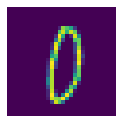

In [ ]:
test_random_sample()

Predicting on image sample 50 from test data
Prediction : 0
Actual : 0


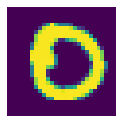

In [ ]:
test_random_sample()

Predicting on image sample 19 from test data
Prediction : 1
Actual : 1


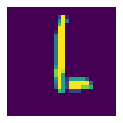

In [ ]:
test_random_sample()

Predicting on image sample 4 from test data
Prediction : 1
Actual : 1


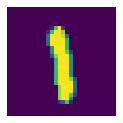

In [ ]:
test_random_sample()




### Visualizing layer outputs


- To get a better understanding of what each layer does to the input image and what it's individual output looks like,

- we create a function to pass a random test image through our trained network and

- plot the image when its passed through the Convolutional, MaxPool and ReLU Layers of our network.



In [ ]:
def layer_outputs(network, input):
    #Initialize the output
    output = input
    #Intitialize the layer number
    layer_n = 0
    #Iterate through layers in our network
    for layer in network:
        #Since we need only the Conv., MaxPool and ReLU layers, we specify layer_number<=3
        if layer_n <= 3:
            #Plot the image using plt.imshow(), drop the first dimension of our image
            #since we do not need for plotting the image
            plt.imshow(output[0,:,:])
            #Turning off the axis (not necessary)
            plt.axis('off')

        #Compute the output of the current layer
        output = layer.forward(output)
        #Incremenet the layer number on every iteration
        layer_n = layer_n + 1
        plt.show()

Plot displaying Layer outputs in the order:

**Input Image => Convolutional output => ReLU output => MaxPool output**

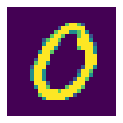

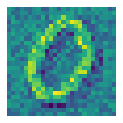

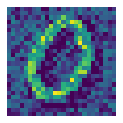

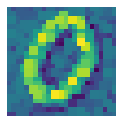

In [ ]:
sample_index = random.randint(0, 2115)
x_sample, y_sample = x_test[sample_index], y_test[sample_index]
layer_outputs(network, x_sample)

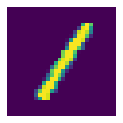

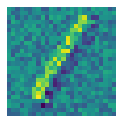

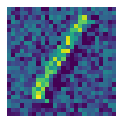

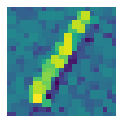

In [ ]:
sample_index = random.randint(0, 2115)
x_sample, y_sample = x_test[sample_index], y_test[sample_index]
layer_outputs(network, x_sample)
#Input Image => Convolutional output => ReLU output => MaxPool output

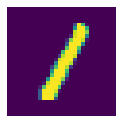

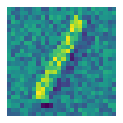

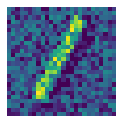

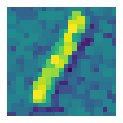

In [ ]:
sample_index = random.randint(0, 2115)
x_sample, y_sample = x_test[sample_index], y_test[sample_index]
layer_outputs(network, x_sample)
#Input Image => Convolutional output => ReLU output => MaxPool output




### Layer output dimensions



We create a function to visualize how our network changes the dimensions of our input image (1x28x28) when passed through every layer.




In [ ]:
def layer_shape(network, input):
    output = input
    #Performing forward pass to our network through every consecutive layer
    for layer in network:
        #Pass the image to every layer's forward method
        output = layer.forward(output)
        #Print layer name
        print(layer)
        #Print layer shape
        print(output.shape)

    #Locating the index in our output class probabilities with the highest value
    #to get the class label
    return output.argmax()

**Input (1x28x28) => Convolution (5 x 3x3 kernels shape) => Output (5, 26, 26) => ReLU => MaxPool (5 x 2x2 kernels shape) => Output (5, 25, 25)=> Reshape (input = 5x25x25) => Output (3125x1) => Dense (input = 3125,1) (output = 100) => TanH => Dense (input = 2, output = 1) => Softmax => predicted class probabilities)**

In [ ]:
print(np.argmax(y_sample))
layer_shape(network, x_sample)

# L4: Intro To Transfer Learning (AlexNet,Vgg16)

#### **Agenda:**
In this Lecture, we will learn about :
   - Recognition of world famous landmark
   - Standard CNN architecture like AlexNet and VGGNet
   - Transfer learning using VGGNet


###Problem Statement:

- Suppose you are working as Data Scientist in Google. You have been given with a task to automate the categorization of famous landmarks.

<center><img src='https://drive.google.com/uc?id=1-AXpfjw6eCpFvJRlbV5GGXnzCmin6vmL' ></center>

- The dataset is obtained by downloading the images of the 10 famous landmark from Google search.
- Using these images, you have to train a CNN model
- For inference, the CNN model will be fed with an image like Google lens and it will output the most probable landmark category

### What is google lens ?

Please follow this who are not familiar : https://lens.google/




### What should be the performance metric ?
Accuracy is obtained by dividing the number of correct predictions  by the total number of samples


### Importing python package

In [ ]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import pandas as pd
import random
import os
import glob
import tensorflow as tf
from tensorflow import keras # this allows <keras.> instead of <tf.keras.>
from tensorflow.keras import layers # this allows <layers.> instead of <tf.keras.layers.>
tf.keras.utils.set_random_seed(111) # set random seed

# To supress any warnings during the flow
import warnings
warnings.filterwarnings('ignore')

plt.rcParams.update({'font.size': 14})

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/',force_remount=True)

Mounted at /content/gdrive/


### Downloading the dataset

In [ ]:
!gdown 11LQILlalZGi_skLIipnpTyh-At77B_j6

Downloading...
From: https://drive.google.com/uc?id=11LQILlalZGi_skLIipnpTyh-At77B_j6
To: /content/New_landmark_images.zip
100% 112M/112M [00:03<00:00, 33.2MB/s]


In [ ]:
!unzip New_landmark_images.zip

Archive:  New_landmark_images.zip
   creating: New_landmark_images/
   creating: New_landmark_images/train/
   creating: New_landmark_images/train/01.Niagara_Falls/
  inflating: New_landmark_images/train/01.Niagara_Falls/176bf33159dd4780.jpg  
  inflating: New_landmark_images/train/01.Niagara_Falls/43e7e6b715dea27a.jpg  
  inflating: New_landmark_images/train/01.Niagara_Falls/4a18c9d51c84df27.jpg  
  inflating: New_landmark_images/train/01.Niagara_Falls/032a10a9b60eae53.jpg  
  inflating: New_landmark_images/train/01.Niagara_Falls/519776646d035f06.jpg  
  inflating: New_landmark_images/train/01.Niagara_Falls/6a6cd26155db4327.jpg  
  inflating: New_landmark_images/train/01.Niagara_Falls/7a1ddf7a6ae3436d.jpg  
  inflating: New_landmark_images/train/01.Niagara_Falls/7398dbeba39b5fb7.jpg  
  inflating: New_landmark_images/train/01.Niagara_Falls/54be916f53092ef8.jpg  
  inflating: New_landmark_images/train/01.Niagara_Falls/292419d3147c4a34.jpg  
  inflating: New_landmark_images/train/01.Nia

#### What kind of preprocessing need to be applied ?
 - The image is normalized so that min-max range is 0-1 instead of 0-255
 - All the images must be resized to (227,227,3)

In [ ]:
train_data = tf.keras.utils.image_dataset_from_directory("New_landmark_images/train/",shuffle =True, seed=123,image_size=(227, 227),batch_size=32)
val_data   = tf.keras.utils.image_dataset_from_directory("New_landmark_images/validation/",shuffle =False, seed=123,image_size=(227, 227),batch_size=32)
test_data  = tf.keras.utils.image_dataset_from_directory("New_landmark_images/test/",shuffle =False, seed=123,image_size=(227, 227),batch_size=32)

data_preprocess = tf.keras.Sequential(
    name="data_preprocess",
    layers=[ layers.Rescaling(1.0/255),]
)

# Perform Data Processing on the train, val, test dataset
train_ds = train_data.map(lambda x, y: (data_preprocess(x), y))
val_ds = val_data.map(lambda x, y: (data_preprocess(x), y))
test_ds = test_data.map(lambda x, y: (data_preprocess(x), y))

Found 737 files belonging to 10 classes.
Found 155 files belonging to 10 classes.
Found 43 files belonging to 10 classes.


In [ ]:
class_dirs = os.listdir("New_landmark_images/train/") # list all directories inside "train" folder
image_dict = {} # dict to store image array(key) for every class(value)
count_dict = {} # dict to store count of files(key) for every class(value)
# iterate over all class_dirs
for cls in class_dirs:
    # get list of all paths inside the subdirectory
    file_paths = glob.glob(f'New_landmark_images/train/{cls}/*')
    # count number of files in each class and add it to count_dict
    count_dict[cls] = len(file_paths)
    # select random item from list of image paths
    image_path = random.choice(file_paths)
    # load image using keras utility function and save it in image_dict
    image_dict[cls] = tf.keras.utils.load_img(image_path)

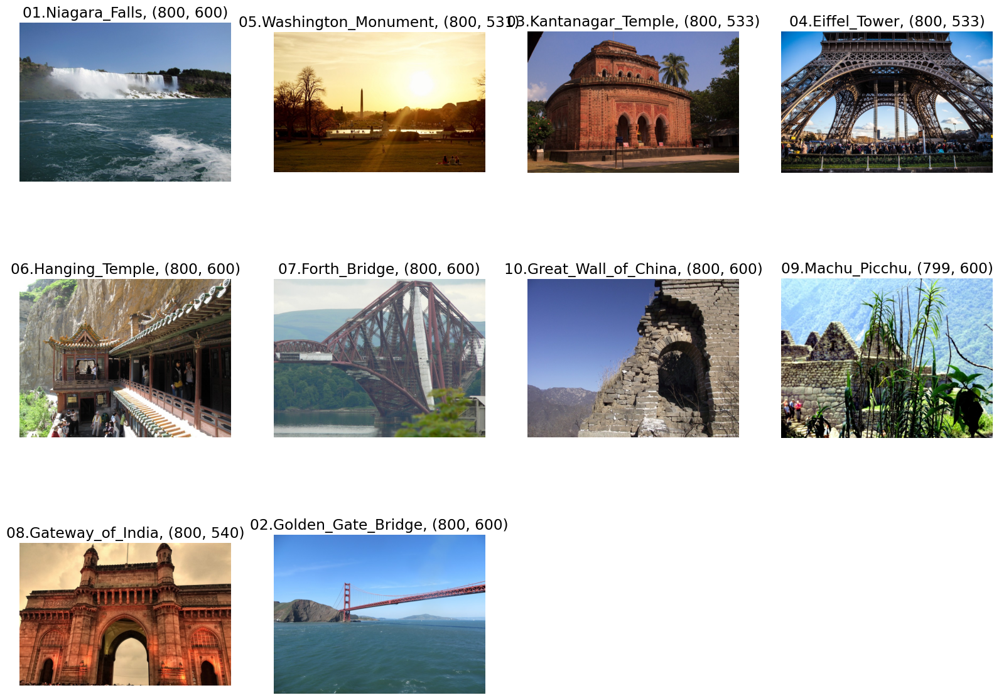

In [ ]:
## Viz Random Sample from each class

plt.figure(figsize=(20, 15))
# iterate over dictionary items (class label, image array)
for i, (cls,img) in enumerate(image_dict.items()):
    # create a subplot axis
    ax = plt.subplot(3, 4, i + 1)
    # plot each image
    plt.imshow(img)
    # set "class name" along with "image size" as title
    plt.title(f'{cls}, {img.size}')
    plt.axis("off")

- Is the dataset balanced ?
-- Yes
 > Each class in the training dataset has almost 70 images.
 > Each class in the validation dataset has almost 15 images.
 > Each class in the test dataset has almost 5 images.

Count of training samples per class:
                     class  count
0        01.Niagara_Falls     66
1  05.Washington_Monument     83
2    03.Kantanagar_Temple     88
3         04.Eiffel_Tower     64
4       06.Hanging_Temple     70
5         07.Forth_Bridge     82
6  10.Great_Wall_of_China     72
7         09.Machu_Picchu     55
8     08.Gateway_of_India     87
9   02.Golden_Gate_Bridge     70


<Axes: title={'center': 'Training Data Count per class'}, xlabel='class'>

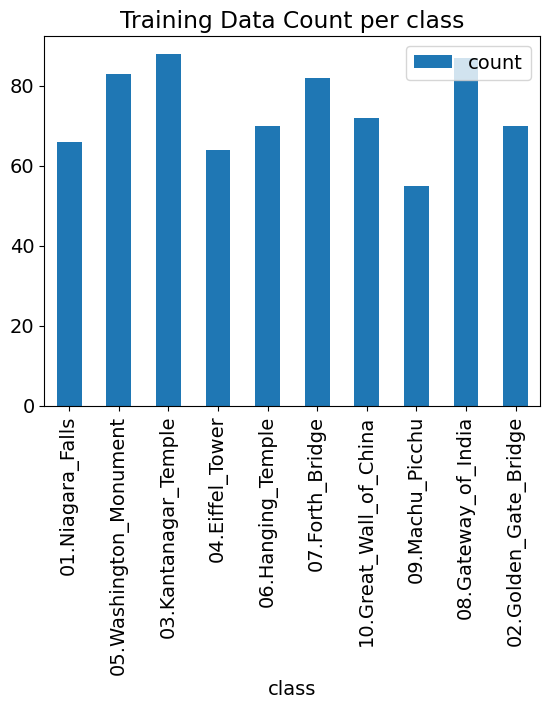

In [ ]:
## Let's now Plot the Data Distribution of Training Data across Classes
df_count_train = pd.DataFrame({
    "class": count_dict.keys(),     # keys of count_dict are class labels
    "count": count_dict.values(),   # value of count_dict contain counts of each class
})
print("Count of training samples per class:\n", df_count_train)

# draw a bar plot using pandas in-built plotting function
df_count_train.plot.bar(x='class', y='count', title="Training Data Count per class")


- How manys classes do we have here ?
 -  10


- Lets look at the names of these 10 labels

In [ ]:
print(train_data.class_names)

['01.Niagara_Falls', '02.Golden_Gate_Bridge', '03.Kantanagar_Temple', '04.Eiffel_Tower', '05.Washington_Monument', '06.Hanging_Temple', '07.Forth_Bridge', '08.Gateway_of_India', '09.Machu_Picchu', '10.Great_Wall_of_China']


- Now lets look into some images from each class

### Data Processing: Resizing, Standardization
- The input image is resized to (224,224,3) because VGGNet expects input image to be of (224,224,3) in size
- Also, we rescale the pixel values to lie between 0 and 1 by dividing it with 255. (since pixel values range from 0 to 255)


In [ ]:
BATCH_SIZE = 128
tf.random.set_seed(10)
np.random.seed(10)
train_ds = tf.keras.utils.image_dataset_from_directory("New_landmark_images/train/",shuffle =True, seed=123,image_size=(224, 224),batch_size=BATCH_SIZE)
val_ds   = tf.keras.utils.image_dataset_from_directory("New_landmark_images/validation/",shuffle =False, seed=123,image_size=(224, 224),batch_size=BATCH_SIZE)
test_ds = tf.keras.utils.image_dataset_from_directory("New_landmark_images/test/",shuffle =False, seed=123,image_size=(224, 224),batch_size=BATCH_SIZE)

data_preprocess = tf.keras.Sequential(
    name="data_preprocess",
    layers=[ layers.Rescaling(1.0/255),]
)

# Perform Data Processing on the train, val, test dataset
train_ds = train_ds.map(lambda x, y: (data_preprocess(x), y))
val_ds = val_ds.map(lambda x, y: (data_preprocess(x), y))
test_ds = test_ds.map(lambda x, y: (data_preprocess(x), y))

Found 737 files belonging to 10 classes.
Found 155 files belonging to 10 classes.
Found 43 files belonging to 10 classes.


In [ ]:
lenet_model = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(28,28,1)),
    tf.keras.layers.Conv2D(6, kernel_size=(5,5),
                        activation= 'sigmoid'),
    tf.keras.layers.AveragePooling2D(pool_size=(2,2), strides= (2,2)),
    tf.keras.layers.Conv2D(16, kernel_size=(5,5),
                        activation= 'sigmoid'),
    tf.keras.layers.AveragePooling2D(pool_size=(2,2), strides= (2,2)),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(120, activation= 'sigmoid'),
    tf.keras.layers.Dense(84, activation= 'sigmoid'),
    tf.keras.layers.Dense(10, activation= 'softmax'),

])

In [ ]:
lenet_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 24, 24, 6)         156       
                                                                 
 average_pooling2d_2 (Averag  (None, 12, 12, 6)        0         
 ePooling2D)                                                     
                                                                 
 conv2d_4 (Conv2D)           (None, 8, 8, 16)          2416      
                                                                 
 average_pooling2d_3 (Averag  (None, 4, 4, 16)         0         
 ePooling2D)                                                     
                                                                 
 flatten_1 (Flatten)         (None, 256)               0         
                                                                 
 dense_3 (Dense)             (None, 120)              

### VGG16

In [ ]:
# VGG 16 Model
# If the commented Conv2D layer is uncommented then it becomes VGG 19
# FC layers are commented so that faster training occur
vgg16_model = tf.keras.Sequential([
        tf.keras.layers.Input(shape = (224 ,224, 3)),
        tf.keras.layers.Conv2D(64, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'),
        tf.keras.layers.Conv2D(64, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'),
        tf.keras.layers.MaxPooling2D(pool_size=(2,2), strides= (2,2)),

        tf.keras.layers.Conv2D(128, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'),
        tf.keras.layers.Conv2D(128, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'),
        tf.keras.layers.MaxPooling2D(pool_size=(2,2), strides= (2,2)),

        tf.keras.layers.Conv2D(256, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'),
        tf.keras.layers.Conv2D(256, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'),
        tf.keras.layers.Conv2D(256, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'),
        #tf.keras.layers.Conv2D(256, kernel_size=(3,3), padding= 'same',
        #                activation= 'relu'),
        tf.keras.layers.MaxPooling2D(pool_size=(2,2), strides= (2,2)),

        tf.keras.layers.Conv2D(512, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'),
        tf.keras.layers.Conv2D(512, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'),
        tf.keras.layers.Conv2D(512, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'),
        #tf.keras.layers.Conv2D(512, kernel_size=(3,3),padding= 'same',
        #                activation= 'relu'),
        tf.keras.layers.MaxPooling2D(pool_size=(2,2), strides= (2,2)),

        tf.keras.layers.Conv2D(512, kernel_size=(3,3),padding= 'same',
                        activation= 'relu'),
        tf.keras.layers.Conv2D(512, kernel_size=(3,3),padding= 'same',
                        activation= 'relu'),
        tf.keras.layers.Conv2D(512, kernel_size=(3,3),padding= 'same',
                        activation= 'relu'),
        #tf.keras.layers.Conv2D(512, kernel_size=(3,3), padding= 'same',
        #                activation= 'relu'),
        tf.keras.layers.MaxPooling2D(pool_size=(2,2), strides= (2,2)),

        tf.keras.layers.Flatten(),
        #tf.keras.layers.Dense(4096, activation= 'relu'),
        #tf.keras.layers.Dropout(0.5),
        #tf.keras.layers.Dense(4096, activation= 'relu'),
        #tf.keras.layers.Dropout(0.5),
        tf.keras.layers.Dense(10, activation= 'softmax')
        ])



In [ ]:
vgg16_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 64)      1792      
                                                                 
 conv2d_1 (Conv2D)           (None, 224, 224, 64)      36928     
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 64)     0         
 )                                                               
                                                                 
 conv2d_2 (Conv2D)           (None, 112, 112, 128)     73856     
                                                                 
 conv2d_3 (Conv2D)           (None, 112, 112, 128)     147584    
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 128)      0         
 2D)                                                    

In [ ]:
import functools
from tensorflow.keras.optimizers import Adam,SGD
top5_acc = functools.partial(tf.keras.metrics.SparseTopKCategoricalAccuracy())

opt = SGD(learning_rate=0.005, momentum=0.99)
vgg16_model.compile(
    optimizer=opt,
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)
print(vgg16_model.optimizer.get_config())
history = vgg16_model.fit(train_ds,  epochs=5,
                    validation_data=val_ds
                   )

{'name': 'SGD', 'weight_decay': None, 'clipnorm': None, 'global_clipnorm': None, 'clipvalue': None, 'use_ema': False, 'ema_momentum': 0.99, 'ema_overwrite_frequency': None, 'jit_compile': True, 'is_legacy_optimizer': False, 'learning_rate': 0.005, 'momentum': 0.99, 'nesterov': False}
Epoch 1/5
6/6 [==============================] - 110s 10s/step - loss: 2.3025 - accuracy: 0.1072 - val_loss: 2.3025 - val_accuracy: 0.1161
Epoch 2/5
6/6 [==============================] - 13s 2s/step - loss: 2.3016 - accuracy: 0.1140 - val_loss: 2.3025 - val_accuracy: 0.0968
Epoch 3/5
6/6 [==============================] - 13s 2s/step - loss: 2.2999 - accuracy: 0.1180 - val_loss: 2.3026 - val_accuracy: 0.0968
Epoch 4/5
6/6 [==============================] - 13s 2s/step - loss: 2.2979 - accuracy: 0.1180 - val_loss: 2.3032 - val_accuracy: 0.0968
Epoch 5/5
6/6 [==============================] - 14s 2s/step - loss: 2.2963 - accuracy: 0.1180 - val_loss: 2.3046 - val_accuracy: 0.0968


In [ ]:
# # Save the entire model as a SavedModel.
# !mkdir -p saved_vgg16model_scratch
# vgg16_model.save('saved_vgg16model_scratch/vgg16_model')

In [ ]:
# Saving the Model
vgg16_model.save("vgg16_model_scratch.h5")

In [ ]:
# Downloading the saved model from Google drive
!gdown 1dwwgrguj9NDIgdnFfdnYZoMsBFVMD3xV

# Loading the model
vgg16_model_scratch = tf.keras.models.load_model("/content/vgg16_model_scratch.h5")

Downloading...
From: https://drive.google.com/uc?id=1dwwgrguj9NDIgdnFfdnYZoMsBFVMD3xV
To: /content/vgg16_model_scratch.h5
100% 120M/120M [00:00<00:00, 140MB/s]


In [ ]:
def training_plot(metrics, history):
  f, ax = plt.subplots(1, len(metrics), figsize=(5*len(metrics), 5))
  for idx, metric in enumerate(metrics):
    ax[idx].plot(history.history[metric], ls='dashed')
    ax[idx].set_xlabel("Epochs")
    ax[idx].set_ylabel(metric)
    ax[idx].plot(history.history['val_' + metric]);
    ax[idx].legend([metric, 'val_' + metric])

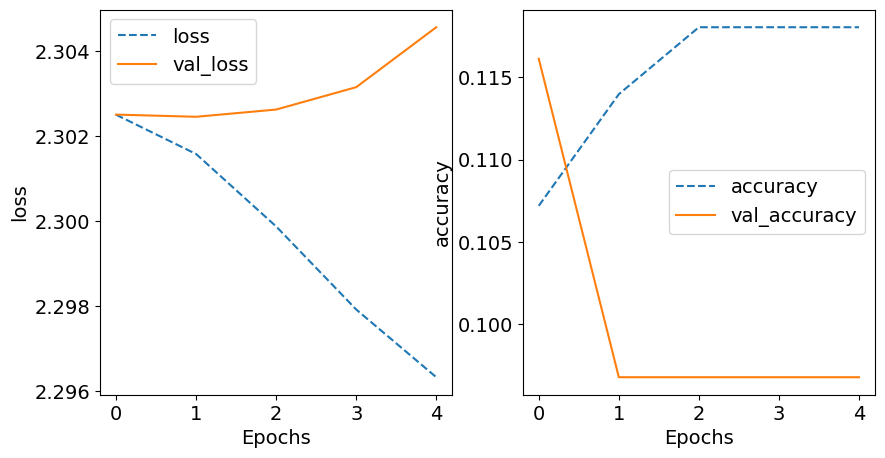

In [ ]:
training_plot(['loss', 'accuracy'], history)

In [ ]:
# Evaluate the model
loss, acc = vgg16_model_scratch.evaluate(test_ds, verbose=2)
print("Restored model, accuracy: {:5.2f}%".format(100 * acc))

1/1 - 6s - loss: 2.3041 - accuracy: 0.1163 - 6s/epoch - 6s/step
Restored model, accuracy: 11.63%


 VGG Pretrained

In [ ]:

pretrained_model = tf.keras.applications.VGG16(weights='imagenet', include_top=False, input_shape=[224,224, 3])
# "Get the first few blocks of pretrained model and freeze them"
#1. break this pretrained model into two halves. first half is what you will freeze, 2nd half you will keep as it is
#2. sequential api (1st half, 2nd half, flatten, dense)
pretrained_model.trainable=False
vgg16_model = tf.keras.Sequential([
    pretrained_model,
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(10, activation='softmax')
])



58889256/58889256 [==============================] - 4s 0us/step


In [ ]:
vgg16_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten_1 (Flatten)         (None, 25088)             0         
                                                                 
 dense_1 (Dense)             (None, 10)                250890    
                                                                 
Total params: 14,965,578
Trainable params: 250,890
Non-trainable params: 14,714,688
_________________________________________________________________


In [ ]:
import functools
top5_acc = functools.partial(tf.keras.metrics.SparseTopKCategoricalAccuracy())

vgg16_model.compile(
    optimizer='adam',
    loss = 'sparse_categorical_crossentropy',
    metrics=['accuracy']
)

In [ ]:
history = vgg16_model.fit(train_ds, epochs=5,
                    validation_data=val_ds)

Epoch 1/5
6/6 [==============================] - 8s 841ms/step - loss: 2.0363 - accuracy: 0.3582 - val_loss: 1.1580 - val_accuracy: 0.5871
Epoch 2/5
6/6 [==============================] - 6s 780ms/step - loss: 0.8127 - accuracy: 0.7286 - val_loss: 0.8087 - val_accuracy: 0.6581
Epoch 3/5
6/6 [==============================] - 6s 786ms/step - loss: 0.4382 - accuracy: 0.8765 - val_loss: 0.5655 - val_accuracy: 0.8065
Epoch 4/5
6/6 [==============================] - 7s 803ms/step - loss: 0.2620 - accuracy: 0.9308 - val_loss: 0.4914 - val_accuracy: 0.7935
Epoch 5/5
6/6 [==============================] - 6s 803ms/step - loss: 0.1719 - accuracy: 0.9661 - val_loss: 0.4588 - val_accuracy: 0.8387


- **By training VGG19 using transfer learning we were able to obtain validation accuracy of 0.8452 after 5 epochs where as VGGNet created from scratch had validation accuracy of 0.15**
- Hence using transfer learnng we obtain higher accuracy and require less training


In [ ]:
# Save the entire model as a SavedModel.
# !mkdir -p saved_vgg16model_pretrained
# vgg16_model.save('saved_vgg16model_pretrained/vgg16_model')

In [ ]:
# Saving the Model
vgg16_model_pretrained = vgg16_model.save("vgg16_model_pretrained.h5")

In [ ]:
# Download the saved model from Google Drive
!gdown 15SJVnO_XxBnHWy98kJe4k6sQ1u3a6tnA

#Loading the model
vgg16_model_pretrained = tf.keras.models.load_model("/content/vgg16_model_pretrained.h5")

Downloading...
From: https://drive.google.com/uc?id=15SJVnO_XxBnHWy98kJe4k6sQ1u3a6tnA
To: /content/vgg16_model_pretrained.h5
100% 61.9M/61.9M [00:00<00:00, 74.8MB/s]


In [ ]:
def training_plot(metrics, history):
  f, ax = plt.subplots(1, len(metrics), figsize=(5*len(metrics), 5))
  for idx, metric in enumerate(metrics):
    ax[idx].plot(history.history[metric], ls='dashed')
    ax[idx].set_xlabel("Epochs")
    ax[idx].set_ylabel(metric)
    ax[idx].plot(history.history['val_' + metric]);
    ax[idx].legend([metric, 'val_' + metric])

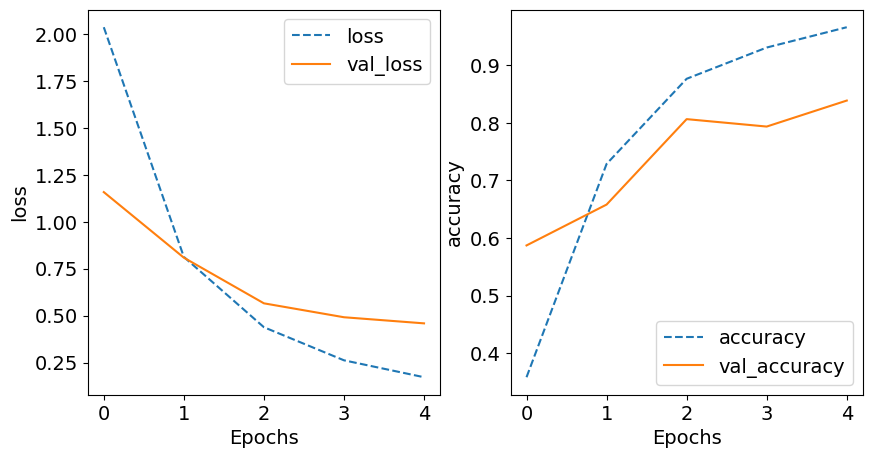

In [ ]:
training_plot(['loss', 'accuracy'], history)

In [ ]:
# Evaluate the model
loss, acc = vgg16_model_pretrained.evaluate(test_ds, verbose=2)
print("Restored model, accuracy: {:5.2f}%".format(100 * acc))

1/1 - 13s - loss: 0.6303 - accuracy: 0.7907 - 13s/epoch - 13s/step
Restored model, accuracy: 79.07%


In [ ]:
def plot_image(pred_array, true_label, img):
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])

  plt.imshow(img, cmap=plt.cm.binary)

  predicted_label = np.argmax(pred_array)
  if predicted_label == true_label:
    color = 'blue'
  else:
    color = 'red'

  plt.xlabel("{} {:2.0f}% ".format(class_names[predicted_label],
                                100*np.max(pred_array),
                                ),
                                color=color)


Now, let's visualize the model prediction on the test dataset

1/1 [==============================] - 0s 287ms/step


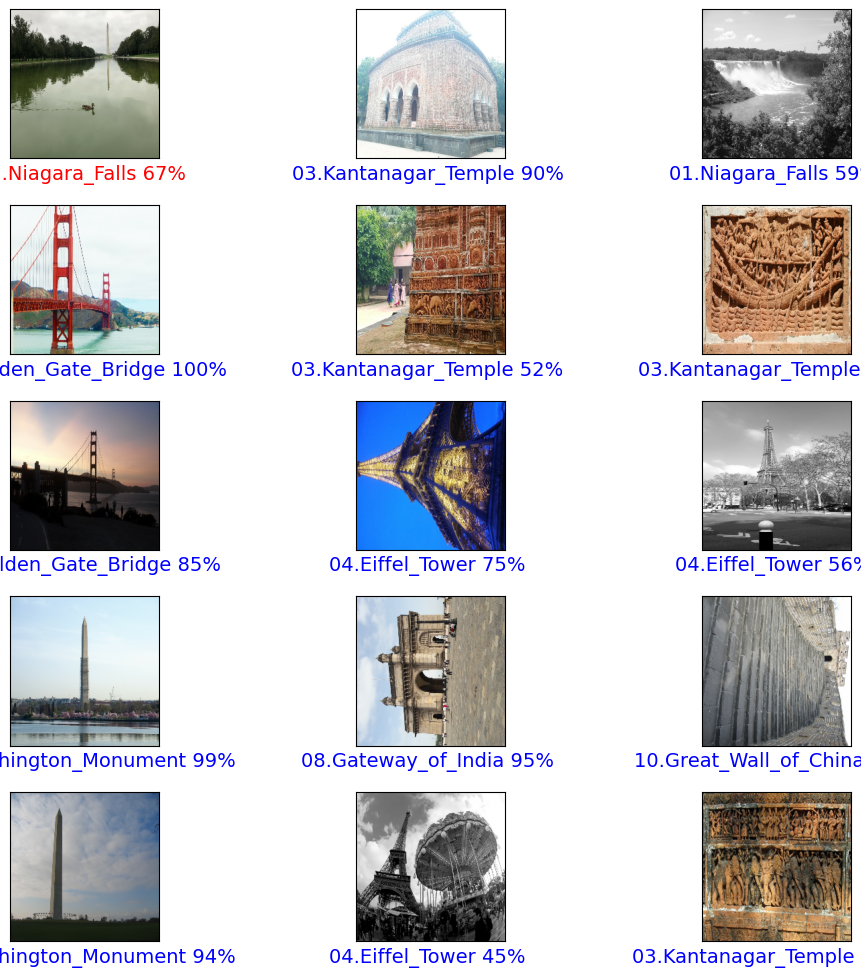

In [ ]:
true_categories = tf.concat([y for x, y in test_ds], axis=0)
images = tf.concat([x for x, y in test_ds], axis=0)
y_pred = vgg16_model.predict(test_ds)
class_names = test_data.class_names

# Randomly sample 15 test images and plot it with their predicted labels, and the true labels.
indices = random.sample(range(len(images)), 15)
# Color correct predictions in blue and incorrect predictions in red.
num_rows = 5
num_cols = 3
num_images = num_rows*num_cols
plt.figure(figsize=(4*num_cols, 2*num_rows))
for i,index in enumerate(indices):
  plt.subplot(num_rows, num_cols, i+1)
  plot_image(y_pred[index], true_categories[index], images[index])

plt.tight_layout()
plt.show()

# L5: Understanding Embeddings

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/',force_remount=True)

In [ ]:
cd /content/gdrive/My Drive/Colab Notebooks/


In [ ]:
!mkdir -p data
!pip install gdown
!gdown https://drive.google.com/uc?id=137RyRjvTBkBiIfeYBNZBtViDHQ6_Ewsp --output data/caltech101.tar.gz
!tar -xvzf data/caltech101.tar.gz --directory data
!mv data/101_ObjectCategories data/caltech101
!rm -rf data/caltech101/BACKGROUND_Google

### Importing Required libraries:

In [ ]:
import numpy as np
from numpy.linalg import norm
import pickle
from tqdm import tqdm, tqdm_notebook
import os
import random
import time
import math
import tensorflow as tf
import numpy as np
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import PIL
from PIL import Image
from sklearn.neighbors import NearestNeighbors
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
import glob
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline


## Inception

In [ ]:
def inception_module(layer_in, f1, f2_in, f2_out, f3_in, f3_out, f4_out):
	# 1x1 conv
	conv1 = Conv2D(f1, (1,1), padding='same', activation='relu')(layer_in)
	# 3x3 conv
	conv3 = Conv2D(f2_in, (1,1), padding='same', activation='relu')(layer_in)
	conv3 = Conv2D(f2_out, (3,3), padding='same', activation='relu')(conv3)
	# 5x5 conv
	conv5 = Conv2D(f3_in, (1,1), padding='same', activation='relu')(layer_in)
	conv5 = Conv2D(f3_out, (5,5), padding='same', activation='relu')(conv5)
	# 3x3 max pooling
	pool = MaxPooling2D((3,3), strides=(1,1), padding='same')(layer_in)
	pool = Conv2D(f4_out, (1,1), padding='same', activation='relu')(pool)
	# concatenate filters, assumes filters/channels last
	layer_out = concatenate([conv1, conv3, conv5, pool], axis=-1)
	return layer_out

<img src='https://miro.medium.com/max/1276/1*qVQbA9GYe5VKIQtAQWPM9w.jpeg'>


- The network is 22 layers deep when counting only layers with parameters (or 27 layers if we also count pooling).
- Please refer the link to see code of full model architecture:
https://www.analyticsvidhya.com/blog/2018/10/understanding-inception-network-from-scratch/

## ResNet

In [ ]:
def identity_block(x, filter):
    # copy tensor to variable called x_skip
    F1,F2,F3 = filter
    x_skip = x
    # Layer 1
    x = tf.keras.layers.Conv2D(F1, (1,1), padding = 'valid')(x)
    x = tf.keras.layers.BatchNormalization(axis=3)(x)
    x = tf.keras.layers.Activation('relu')(x)
    # Layer 2
    x = tf.keras.layers.Conv2D(F2, (3,3), padding = 'same')(x)
    x = tf.keras.layers.BatchNormalization(axis=3)(x)
    # Layer 3
    x = tf.keras.layers.Conv2D(F3, (1,1), padding = 'valid')(x)
    x = tf.keras.layers.BatchNormalization(axis=3)(x)
    # Add Residue
    x = tf.keras.layers.Add()([x, x_skip])
    x = tf.keras.layers.Activation('relu')(x)
    return x

In [ ]:
def convolutional_block(x, s,filter):
    # copy tensor to variable called x_skip
    x_skip = x
    F1,F2,F3 =filter
    # Layer 1
    x = tf.keras.layers.Conv2D(F1, (1,1), padding = 'valid', strides = (s,s))(x)
    x = tf.keras.layers.BatchNormalization(axis=3)(x)
    x = tf.keras.layers.Activation('relu')(x)
    # Layer 2
    x = tf.keras.layers.Conv2D(F2, (3,3), padding = 'same')(x)
    x = tf.keras.layers.BatchNormalization(axis=3)(x)
    x = tf.keras.layers.Activation('relu')(x)
    # Layer 3
    x = tf.keras.layers.Conv2D(F3, (1,1), padding = 'valid')(x)
    x = tf.keras.layers.BatchNormalization(axis=3)(x)
    # Processing Residue with conv(1,1)
    x_skip = tf.keras.layers.Conv2D(F3, (1,1),padding = 'valid', strides = (s,s))(x_skip)
    x_skip = tf.keras.layers.BatchNormalization(axis=3)(x_skip)
    # Add Residue
    x = tf.keras.layers.Add()([x, x_skip])
    x = tf.keras.layers.Activation('relu')(x)
    return x

### Resnet50 architecture:

<img src=https://d2beiqkhq929f0.cloudfront.net/public_assets/assets/000/046/985/original/Screenshot_2023-09-08_at_11.40.42_AM.png?1694153864 width=800>

In [ ]:
def ResNet_50(input_shape=(224, 224, 3)):

    X_input = Input(input_shape)

    X = tf.keras.layers.ZeroPadding2D((3, 3))(X_input)

    #stage 1


    X = tf.keras.layers.Conv2D(64, (7, 7), strides=(2, 2), kernel_initializer=glorot_uniform(seed=0))(X)
    X = tf.keras.layers.BatchNormalization(axis=3)(X)
    X = tf.keras.layers.Activation('relu')(X)
    X = tf.keras.layers.MaxPooling2D((3, 3), strides=(2, 2))(X)


    #stage 2

    X = convolutional_block(X, s=1, filters=[64, 64, 256])
    X = identity_block(X, [64, 64, 256])
    X = identity_block(X, [64, 64, 256])


    #stage 3


    X = convolutional_block(X,s=2, filters=[128, 128, 512])
    X = identity_block(X, [128, 128, 512])
    X = identity_block(X, [128, 128, 512])
    X = identity_block(X, [128, 128, 512])


    #stage 4

    X = convolutional_block(X,s=2, filters=[256, 256, 1024])
    X = identity_block(X, [256, 256, 1024])
    X = identity_block(X, [256, 256, 1024])
    X = identity_block(X, [256, 256, 1024])
    X = identity_block(X, [256, 256, 1024])
    X = identity_block(X, [256, 256, 1024])

    #stage 5

    X = convolutional_block(X,s=2, filters=[512, 512, 2048])
    X = identity_block(X, [512, 512, 2048])
    X = identity_block(X, [512, 512, 2048])


    X = tf.keras.layers.AveragePooling2D(pool_size=(2, 2), padding='same')(X)

    model = Model(inputs=X_input, outputs=X, name='ResNet50')

    return model

### Loading the Resnet50 model:

In [ ]:
model = ResNet50(weights='imagenet',
                         include_top=False,
                         input_shape=(224, 224, 3),
                         pooling='avg'
                        )

In [ ]:
model.summary()



## Feature Extraction :

Let's define a function to extract image features given an image and a model.

In [ ]:
def extract_features(img_path, model):
    input_shape = (224, 224, 3)
    img = image.load_img(img_path,
                         target_size=(input_shape[0], input_shape[1]))
    img_array = image.img_to_array(img)
    expanded_img_array = np.expand_dims(img_array, axis=0)
    preprocessed_img = preprocess_input(expanded_img_array)
    features = model.predict(preprocessed_img)
    flattened_features = features.flatten()
    normalized_features = flattened_features / norm(flattened_features)
    return normalized_features

Let's see the feature length the model generates by running on an example image. If you don't have the usual cat image available locally, let's download it!

In [ ]:
try:
  import google.colab
  IS_COLAB_ENV = True
except:
  IS_COLAB_ENV = False

In [ ]:
IMG_PATH = 'cat.jpg'
if IS_COLAB_ENV:
  !curl https://drive.google.com/file/d/1rOaOGw-SFH_lp8Sx8wRAksU79M8Wz8k4/view?usp=sharing --output cat.jpg
  IMG_PATH = 'cat.jpg'

In [ ]:
features = extract_features(IMG_PATH, model)
print("Total length of features for one image: ", len(features))

- Now, we will see how much time it takes to extract features of one image.
- For the cat image, it should ideally be around 81 ms.
- Depending on your image size, the final time may be different and it depends on the time to read, resize, preprocess, and extract features.

In [ ]:
%timeit features = extract_features('cat.jpg', model)

## Benchmarking time taken to extract features over the entire dataset

The time taken to extract features is dependent on a few factors such as image size, computing power etc.

A better benchmark would be running the network over an entire dataset.

A simple change to the existing code will allow this.

Let's make a handy function to recursively get all the image files under a root directory.

In [ ]:
extensions = ['.jpg', '.JPG', '.jpeg', '.JPEG', '.png', '.PNG']

def get_file_list(root_dir):
    file_list = []
    for root, directories, filenames in os.walk(root_dir):
        for filename in filenames:
            if any(ext in filename for ext in extensions):
                filepath = os.path.join(root, filename)
                if os.path.exists(filepath):
                  file_list.append(filepath)
                else:
                  print(filepath)
    return file_list

Now, let's run the extraction over the entire dataset and time it.

In [ ]:
# path to the your datasets
root_dir = 'data/caltech101'
filenames = sorted(get_file_list(root_dir))
print(len(filenames))

Now, let's run the extraction over the entire dataset and time it.

In [ ]:
BATCH_SIZE = 128
generator = tf.keras.utils.image_dataset_from_directory(root_dir,
                                            shuffle=False,
                                           batch_size=BATCH_SIZE,
                                            image_size=(224,224))

num_images = len(generator.file_paths)
num_epochs = int(math.ceil(num_images / BATCH_SIZE))

start_time = time.time()
feature_list = []
feature_list = model.predict(generator, num_epochs)
end_time = time.time()

In [ ]:
for i, features in enumerate(feature_list):
    feature_list[i] = features / norm(features)

feature_list = feature_list.reshape(len(feature_list), -1)

print("Num images   = ", len(generator.file_paths))
print("Shape of feature_list = ", feature_list.shape)
print("Time taken in min = ", (end_time - start_time)/60)

By now, we have generated features from the entire dataset of images.

With the benchmarking experiments squared away, let's save the features as intermediate files to use later.

In [ ]:
pickle.dump(generator.class_names, open('./data/class_ids-caltech101.pickle',
                                    'wb'))
pickle.dump(generator.file_paths, open('./data/filenames-caltech101.pickle', 'wb'))
pickle.dump(
    feature_list,
    open('./data/features-caltech101-' + 'resnet50' + '.pickle', 'wb'))

That’s all folks! We’re done with the feature extraction part

## Similarity Search:
- Given a QUERY image, our aim is to find another photo in our dataset similar to the current one.

- We begin by loading the precomputed features:


In [ ]:
filenames = pickle.load(open('./data/filenames-caltech101.pickle', 'rb'))
feature_list = pickle.load(open('./data/features-caltech101-resnet50.pickle',
                                'rb'))
class_ids = pickle.load(open('./data/class_ids-caltech101(1).pickle', 'rb'))

In [ ]:
num_images = len(filenames)
num_features_per_image = len(feature_list[0])
print("Number of images = ", num_images)
print("Number of features per image = ", num_features_per_image)

In [ ]:
feature_list.shape

In [ ]:
len(class_ids)

## How we find similar images after feature extraction ?

Using Knearest Neighbors :
- We’ll use Python’s machine learning library scikit-learn for
finding nearest neighbors of the query features; that is, features that represent a query image.

- We train a nearest-neighbor model using the brute-force algorithm to find the nearest five neighbors based on Euclidean distance

In [ ]:
random_index = random.randint(0, num_images)

In [ ]:
from sklearn.neighbors import NearestNeighbors

neighbors = NearestNeighbors(n_neighbors=5, algorithm='brute', metric='euclidean').fit(feature_list)
distances, indices = neighbors.kneighbors([feature_list[random_index]])

- Now you have both the indices and distances of the nearest five neighbors of the image at random_index.
- Notice the quick execution of the first step — the training step. Unlike training most machine learning models, which can take from several minutes to hours on large datasets,
  - instantiating the nearest-neighbor model is instantaneous because at training time there isn’t much processing.

- This is also called lazy learning because all the processing is deferred to classification or inference time.


Now, let's look at the time it takes to search for the nearest neighbors for the selected random image using the trained model with the Brute force algorithm.

In [ ]:
%timeit distances, indices = neighbors.kneighbors([feature_list[random_index]])

In [ ]:
plt.imshow(mpimg.imread(filenames[random_index]))

In [ ]:
plt.imshow(mpimg.imread(filenames[indices[0][0]]))

In [ ]:
plt.imshow(mpimg.imread(filenames[indices[0][1]]))

In [ ]:
plt.imshow(mpimg.imread(filenames[indices[0][2]]))

In [ ]:
for i in range(5):
    print(distances[0][i])

In [ ]:
# Helper function to get the classname
def classname(str):
    return str.split('/')[-2]


# Helper function to get the classname and filename
def classname_filename(str):
    return str.split('/')[-2] + '/' + str.split('/')[-1]


# Helper functions to plot the nearest images given a query image
def plot_images(filenames, distances):
    images = []
    for filename in filenames:
        images.append(mpimg.imread(filename))
    plt.figure(figsize=(20, 10))
    columns = 4
    for i, image in enumerate(images):
        ax = plt.subplot(len(images) / columns + 1, columns, i + 1)
        if i == 0:
            ax.set_title("Query Image\n" + classname_filename(filenames[i]))
        else:
            ax.set_title("Similar Image\n" + classname_filename(filenames[i]) +
                         "\nDistance: " +
                         str(float("{0:.2f}".format(distances[i]))))
        plt.imshow(image)



In [ ]:
for i in range(10):
    random_image_index = random.randint(0, 8000)
    distances, indices = neighbors.kneighbors(
        [feature_list[random_image_index]])
    # Don't take the first closest image as it will be the same image
    similar_image_paths = [filenames[random_image_index]] + \
        [filenames[indices[0][i]] for i in range(1, 4)]
    plot_images(similar_image_paths, distances[0])

In [ ]:
# Calculating some stats
print("Median distance between all photos: ", np.median(distances))
print("Max distance between all photos: ", np.max(distances))
print("Median distance among most similar photos: ",
      np.median(distances[:, 2]))

### Calculating Accuracy of the Brute Force Model :

In [ ]:
# Helper function that calculates accuracy using the nearest neighbors brute force algorithm
def calculate_accuracy(feature_list):
    num_nearest_neighbors = 5
    correct_prediction = 0
    incorrect_prediction = 0
    neighbors = NearestNeighbors(n_neighbors=num_nearest_neighbors,
                                 algorithm='brute',
                                 metric='euclidean').fit(feature_list)
    start = time.time()
    for i in range(len(feature_list)):
        distances, indices = neighbors.kneighbors([feature_list[i]])
        for j in range(1, num_nearest_neighbors):
            if (classname(filenames[i]) == classname(
                    filenames[indices[0][j]])):
                correct_prediction += 1
            else:
                incorrect_prediction += 1
    end = time.time()
    accuracy = round(
        100.0 * correct_prediction /
        (1.0 * correct_prediction + incorrect_prediction), 2), end - start
    return accuracy

In [ ]:
print("Accuracy on original feature set : ",
      calculate_accuracy(feature_list[:]))

## Visualizing Image Clusters with t-SNE:

Let’s step up the game by visualizing the entire dataset!

- To do this, we need to reduce the dimensions of the feature vectors because it’s not possible to plot a 2,048-dimension vector (the feature-length) in two dimensions (the paper).
- The t-distributed stochastic neighbor embedding (t-SNE) algorithm reduces the high-dimensional feature vector to 2D, providing a bird’s-eye view of the dataset, which is helpful in recognizing clusters and nearby images.
- t-SNE is difficult to scale to large datasets, so it is a good idea to reduce the dimensionality using Principal Component Analysis (PCA) and then call t-SNE:

In [ ]:
# Perform PCA over the features
num_feature_dimensions=150 # Set the number of features
pca = PCA(n_components = num_feature_dimensions)
pca.fit(feature_list)
feature_list_compressed = pca.transform(feature_list)

Time taken to search similar images for one image using PCA:

In [ ]:
neighbors = NearestNeighbors(n_neighbors=5, algorithm='brute', metric='euclidean').fit(feature_list_compressed)
distances, indices = neighbors.kneighbors([feature_list_compressed[random_index]])
%timeit distances, indices = neighbors.kneighbors([feature_list_compressed[random_index]])

In [ ]:
# For speed and clarity, we'll analyze about first half of the dataset.
selected_features = feature_list_compressed[:4000]
selected_class_ids = class_ids[:4000]
selected_filenames = filenames[:4000]
tsne_results = TSNE(n_components=2,verbose=1,metric='euclidean').fit_transform(selected_features)
# Plot a scatter plot from the generated t-SNE results
colormap = plt.cm.get_cmap('coolwarm')
scatter_plot = plt.scatter(tsne_results[:,0],tsne_results[:,1],c=selected_class_ids, cmap=colormap)
plt.colorbar(scatter_plot)
plt.show()

In [ ]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from matplotlib.cbook import get_sample_data


def plot_images_in_2d(x, y, image_paths, axis=None, zoom=1):
    if axis is None:
        axis = plt.gca()
    x, y = np.atleast_1d(x, y)
    for x0, y0, image_path in zip(x, y, image_paths):
        image = Image.open(image_path)
        image.thumbnail((100, 100), Image.ANTIALIAS)
        img = OffsetImage(image, zoom=zoom)
        anno_box = AnnotationBbox(img, (x0, y0),
                                  xycoords='data',
                                  frameon=False)
        axis.add_artist(anno_box)
    axis.update_datalim(np.column_stack([x, y]))
    axis.autoscale()

In [ ]:
def show_tsne(x, y, selected_filenames):
    fig, axis = plt.subplots()
    fig.set_size_inches(22, 22, forward=True)
    plot_images_in_2d(x, y, selected_filenames, zoom=0.3, axis=axis)
    plt.show()

In [ ]:
show_tsne(tsne_results[:, 0], tsne_results[:, 1], selected_filenames)


Neat! There is a clearly demarcated cluster of human faces, flowers, vintage cars, ships, bikes, and a somewhat spread-out cluster of land and marine animals.

## Accuracy of Brute Force over the PCA compressed Caltech101 features


In [ ]:
pca_dimensions = [1, 2, 3, 4, 5, 10, 20, 50, 75, 100, 150, 200]
pca_accuracy = []
pca_time = []

for dimensions in pca_dimensions:
    pca = PCA(n_components=dimensions)
    pca.fit(feature_list)
    feature_list_compressed = pca.transform(feature_list[:])
    # Calculate accuracy over the compressed features
    accuracy, t = calculate_accuracy(feature_list_compressed[:])
    pca_time.append(t)
    pca_accuracy.append(accuracy)
    print("For PCA Dimensions = ", dimensions, ",\tAccuracy = ", accuracy, "%",
          ",\tTime = ", pca_time[-1])

### PCA + Annoy:

- Annoy (Approximate Nearest Neighbors Oh Yeah) is a C++ library with Python bindings for searching nearest neighbors.
- Synonymous with speed, it was released by Spotify and is used in production to serve their music recommendations.

- To use annoy, install it using pip: pip3 install annoy

In [ ]:
!pip3 install Annoy

In [ ]:
from annoy import AnnoyIndex

First, we build a search index with two hyperparameters - the number of dimensions of the dataset, and the number of trees.

In [ ]:
# Time the indexing for Annoy
t = AnnoyIndex(150)  # Length of item vector that will be indexed
starttime = time.time()
for i in range(num_images):
    feature = feature_list_compressed[i]
    t.add_item(i, feature)
endtime = time.time()
print(endtime - starttime)
t.build(40)  # 40 trees
t.save('data/caltech101index.ann')

Annoy on one image:
Now let’s find out the time it takes to search the 5 nearest neighbors of one image.

In [ ]:
random_image_index = 1001

In [ ]:
u = AnnoyIndex(150)
%timeit u.get_nns_by_vector(feature_list_compressed[random_image_index], 5, include_distances=True)
indexes = u.get_nns_by_vector(feature_list_compressed[random_image_index],
                              5,
                              include_distances=True)

- Now **THAT is blazing fast!** To put this in perspective, for such a modestly sized dataset, this can serve almost 15000 requests on a single CPU core.

- Considering most CPUs have multiple cores, it should be able to handle 100K+ requests on a single system. The best part is that it lets you share the same index in memory between multiple processes. Hence, the biggest index can be equivalent to the size of your overall RAM, making it possible to serve multiple requests on a single system.



Helper function to time the search for multiple images for Annoy.

Perform the search for the same image multiple times to get an average value.

In [ ]:
def calculate_annoy_time():
    for i in range(0, 100):
        indexes = u.get_nns_by_vector(feature_list_compressed[random_image_index],
                                      5,
                                      include_distances=True)

Annoy on a set of images:

Time the search for multiple images for Annoy.

In [ ]:
%time calculate_annoy_time()

# L6: CNN for Medical Diagnosis

### **How we are going to solve the problem :**
- In previous classes you have studied about state-of-the-art models like VGG16, ResNet, etc.
- Models like these are computationally heavy and cannot be deployed on mobile devices

### Which model to use here ?

- We are going to introduce mobilenet in this session
    - MobileNet achieves sky high accuracies and is 100x smaller compared to these models
    - MobileNet is used on mobile apps for object detection, image classficiation, etc. and provide low latency outputs for any use case
    

<center><img src='https://drive.google.com/uc?id=10Do0zifY8E3gyyPSZQQsMyiOrzc92FSn' width=700>

MobileNet Architecture</center>

- We will again through the Architecture in detail but before that -
- Lets check our DATA !

In [ ]:
# Importing required libraries

import warnings
import numpy as np
import seaborn as sns
import tensorflow as tf
import matplotlib.cm as cm
import matplotlib.pyplot as plt
warnings.filterwarnings('ignore')

Here we will also see how to utilize TPUs efficiently-

What are TPUs?
  - TPUs are tensor processing units developed by Google to accelerate operations on a Tensorflow Graph.
    - Each TPU packs up to 180 teraflops of floating-point performance and 64 GB of high-bandwidth memory onto a single board.
    - These are Google's custom-developed application-specific integrated circuits (ASICs) used to accelerate machine learning workloads.
  - TPUs were only available on Google cloud but now they are available for free in Colab.

In [ ]:
#tf.distribute.Strategy is a TensorFlow API to distribute training across multiple GPUs,
#multiple machines, or TPUs. Using this API, you can distribute your existing models and
#training code with minimal code changes.
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver.connect()
    print("Device:", tpu.master())
    strategy = tf.distribute.TPUStrategy(tpu)
except:
    strategy = tf.distribute.get_strategy()
print("Number of replicas:", strategy.num_replicas_in_sync)

Device: grpc://10.52.223.82:8470
Number of replicas: 8



- Below, we define key configuration parameters we'll use in this example.
- To run on TPU, this example must be on Colab with the TPU runtime selected.

In [ ]:
AUTOTUNE = tf.data.AUTOTUNE

# Specifying our training batch size
BATCH_SIZE = 32 * strategy.num_replicas_in_sync

# Specifying the image size
IMAGE_SIZE = [224, 224]

# List containing class names, which will be used to index on our model output
# 0 = NORMAL, 1 = PNEUMONIA
CLASS_NAMES = ["NORMAL", "PNEUMONIA"]

###Download dataset using google cloud link:

Here the dataset is present in the TFRecord file format format:

What is TFRecord file format format ?
- A TFRecord file stores your data as a sequence of binary strings.
- It is Tensorflow’s own binary storage format.
- Advantages of tf.record format :
    - Binary data takes up less space on disk,
    - takes less time to copy
    - can be read much more efficiently from disk.
    - If you are working with large datasets, using a binary file format for storage of your data can have a significant impact on the performance of your import pipeline


In [ ]:
train_images = tf.data.TFRecordDataset(
    "gs://download.tensorflow.org/data/ChestXRay2017/train/images.tfrec"
)
train_paths = tf.data.TFRecordDataset(
    "gs://download.tensorflow.org/data/ChestXRay2017/train/paths.tfrec"
)

ds = tf.data.Dataset.zip((train_images, train_paths))

In [ ]:
COUNT_NORMAL = len([filename for filename in train_paths if "NORMAL" in filename.numpy().decode("utf-8")])
print("Normal images count in training set: " + str(COUNT_NORMAL))

COUNT_PNEUMONIA = len([filename for filename in train_paths if "PNEUMONIA" in filename.numpy().decode("utf-8")])
print("Pneumonia images count in training set: " + str(COUNT_PNEUMONIA))

print('Total Count of images:', COUNT_NORMAL+COUNT_PNEUMONIA )

Normal images count in training set: 1349
Pneumonia images count in training set: 3883
Total Count of images: 5232


- Notice that there are way more images that are classified as pneumonia than normal.
- This shows that we have an **imbalance** in our data i.e our model can be biased towards high majority class (Pneumonia in our case)

### **How we are going to solve the class imbalance here ?**

#### Can we apply augmentation here ?

- Here Data augmentation will not be useful because X-ray scans are only taken in a specific orientation, and variations such as flips and rotations will not exist in real X-ray images.

- We will correct for this imbalance later using class weights

In [ ]:
TRAIN_IMG_COUNT = COUNT_NORMAL + COUNT_PNEUMONIA
# Scaling by total/2 helps keep the loss to a similar magnitude.
# The sum of the weights of all examples stays the same.

weight_for_0 = (1 / COUNT_NORMAL) * (TRAIN_IMG_COUNT)  / 2.0
weight_for_1 = (1 / COUNT_PNEUMONIA) * (TRAIN_IMG_COUNT) / 2.0

class_weight = {0: weight_for_0, 1: weight_for_1}

print("Weight for class 0: {:.2f}".format(weight_for_0))
print("Weight for class 1: {:.2f}".format(weight_for_1))

Weight for class 0: 1.94
Weight for class 1: 0.67


- The weight for class 0 (Normal) is a lot higher than the weight for class 1 (Pneumonia).
- Because there are less normal images, each normal image will be weighted more to balance the data as the CNN works best when the training data is balanced.

### Creating (Image, Label) pair :

- We want to map each filename to the corresponding (image, label) pair. The following methods will help us do that.

- As we only have two labels, we will encode the label so that `1` or `True` indicates pneumonia and `0` or `False` indicates normal.

In [ ]:
def get_label(file_path):
    # convert the path to a list of path components
    parts = tf.strings.split(file_path, "/")
    # The second to last is the class-directory
    return parts[-2] == "PNEUMONIA"


def decode_img(img):
    # convert the compressed string to a 3D uint8 tensor
    img = tf.image.decode_jpeg(img, channels=3)
    # resize the image to the desired size.
    return tf.image.resize(img, IMAGE_SIZE)


def process_path(image, path):
    label = get_label(path)
    # load the raw data from the file as a string
    img = decode_img(image)
    return img, label


ds = ds.map(process_path, num_parallel_calls = AUTOTUNE)

Let's split the data into a training and validation datasets.

In [ ]:
ds = ds.shuffle(10000)
train_ds = ds.take(4300)
val_ds = ds.skip(4300)

Let's visualize the shape of an (image, label) pair.

In [ ]:
for image, label in train_ds.take(1):
    print("Image shape: ", image.numpy().shape)

Image shape:  (224, 224, 3)


Load and format the test data as well.

In [ ]:
test_images = tf.data.TFRecordDataset(
    "gs://download.tensorflow.org/data/ChestXRay2017/test/images.tfrec"
)
test_paths = tf.data.TFRecordDataset(
    "gs://download.tensorflow.org/data/ChestXRay2017/test/paths.tfrec"
)

COUNT_NORMAL = len([filename for filename in test_paths if "NORMAL" in filename.numpy().decode("utf-8")])
print("Normal images count in test set: " + str(COUNT_NORMAL))

COUNT_PNEUMONIA = len([filename for filename in test_paths if "PNEUMONIA" in filename.numpy().decode("utf-8")])
print("Pneumonia images count in test set: " + str(COUNT_PNEUMONIA))

Normal images count in test set: 234
Pneumonia images count in test set: 390


In [ ]:
test_ds = tf.data.Dataset.zip((test_images, test_paths))

test_ds = test_ds.map(process_path, num_parallel_calls=AUTOTUNE)
test_ds_batch = test_ds.batch(BATCH_SIZE)

## Visualize the dataset

- First, let's use buffered prefetching so we can yield data from disk without having I/O
become blocking.

- Please note that large image datasets should not be cached in memory.
- We do it here because the dataset is not very large and we want to train on TPU.

In [ ]:
def prepare_for_training(ds, cache=True):
    # This is a small dataset, only load it once, and keep it in memory.
    # use `.cache(filename)` to cache preprocessing work for datasets that don't
    # fit in memory.

    ds = ds.cache()
    ds = ds.batch(BATCH_SIZE)

    # `prefetch` lets the dataset fetch batches in the background while the model
    # is training.
    ds = ds.prefetch(buffer_size=AUTOTUNE)

    return ds

Call the next batch iteration of the training data.

In [ ]:
train_ds_batch = prepare_for_training(train_ds)
val_ds_batch = prepare_for_training(val_ds)

image_batch, label_batch = next(iter(train_ds_batch))

Define the method to show the images in the batch.

In [ ]:
def show_batch(image_batch, label_batch):
    plt.figure(figsize=(10, 10))
    for n in range(25):
        ax = plt.subplot(5, 5, n + 1)
        plt.imshow(image_batch[n] / 255)
        if label_batch[n]:
            plt.title("PNEUMONIA")
        else:
            plt.title("NORMAL")
        plt.axis("off")

As the method takes in NumPy arrays as its parameters, call the numpy function on the
batches to return the tensor in NumPy array form.

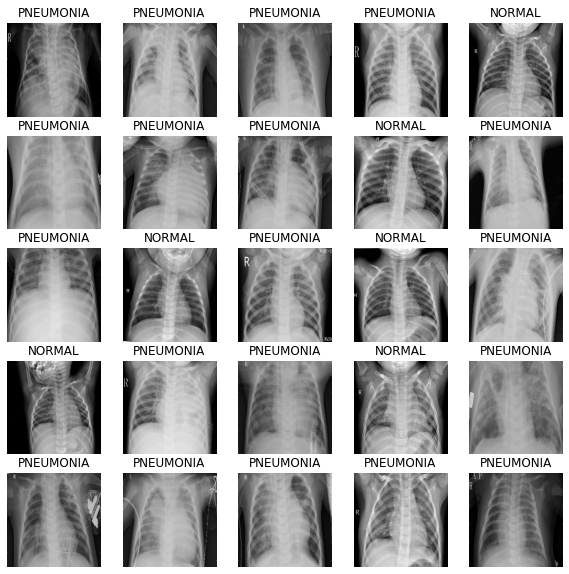

In [ ]:
show_batch(image_batch.numpy(), label_batch.numpy())

## MobileNet

In [ ]:
import tensorflow as tf

#import all necessary layers
from tensorflow.keras.layers import Input, DepthwiseConv2D
from tensorflow.keras.layers import Conv2D, BatchNormalization
from tensorflow.keras.layers import ReLU, AvgPool2D, Flatten, Dense

from tensorflow.keras import Model

In [ ]:
# MobileNet block
def mobilnet_block (x, filters, strides):

    x = DepthwiseConv2D(kernel_size = 3, strides = strides, padding = 'same')(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)

    x = Conv2D(filters = filters, kernel_size = 1, strides = 1)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)

    return x

In [ ]:
#stem of the model
input = Input(shape = (224, 224, 3))
x = Conv2D(filters = 32, kernel_size = 3, strides = 2, padding = 'same')(input)
x = BatchNormalization()(x)
x = ReLU()(x)

In [ ]:
# main part of the model
x = mobilnet_block(x, filters = 64, strides = 1)
x = mobilnet_block(x, filters = 128, strides = 2)
x = mobilnet_block(x, filters = 128, strides = 1)
x = mobilnet_block(x, filters = 256, strides = 2)
x = mobilnet_block(x, filters = 256, strides = 1)
x = mobilnet_block(x, filters = 512, strides = 2)
for _ in range (5):
     x = mobilnet_block(x, filters = 512, strides = 1)
x = mobilnet_block(x, filters = 1024, strides = 2)
x = mobilnet_block(x, filters = 1024, strides = 1)
x = AvgPool2D (pool_size = 7, strides = 1, data_format='channels_first')(x)
output = Dense (units = 1000, activation = 'softmax')(x)
model = Model(inputs=input, outputs=output)
model.summary()

Model: "model_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_11 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 conv2d_28 (Conv2D)          (None, 112, 112, 32)      896       
                                                                 
 batch_normalization_54 (Bat  (None, 112, 112, 32)     128       
 chNormalization)                                                
                                                                 
 re_lu_54 (ReLU)             (None, 112, 112, 32)      0         
                                                                 
 depthwise_conv2d_26 (Depthw  (None, 112, 112, 32)     320       
 iseConv2D)                                                      
                                                                 
 batch_normalization_55 (Bat  (None, 112, 112, 32)     128

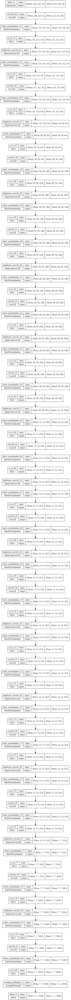

In [ ]:
#plot the model
tf.keras.utils.plot_model(model, to_file='model.png', show_shapes=True, show_dtype=False,show_layer_names=True, rankdir='TB', expand_nested=False, dpi=96)

## Pretrained MobileNet

In [ ]:
def build_model():

    mobilenet_model = tf.keras.applications.MobileNetV2(
        weights ='imagenet',
        include_top = False,
        input_shape = (224,224,3)
    )

    #Freezing the pretrained mobilenet layers except the last  layer
    # Known as fintuning the model

    for layer in mobilenet_model.layers[:-2]:
        layer.trainable = False


    # for layer in mobilenet_model.layers:
    #     layer.trainable = False


    #Output of base model
    x = mobilenet_model.output
    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    x = tf.keras.layers.Dense(128, activation = "relu")(x)
    output = tf.keras.layers.Dense(1, activation = 'sigmoid')(x)
    pretrained_model = tf.keras.Model(inputs = mobilenet_model.input, outputs = output)

    return pretrained_model

In [ ]:
finetuned_mobilenet = build_model()

In [ ]:
# Visualizing our model layers and parameters
finetuned_mobilenet.summary()

Model: "model_11"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_12 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_12[0][0]']               
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                                          

### Defining callbacks

- The checkpoint callback saves the best weights of the model, so next time we want to use the model,
- we do not have to spend time training it.
-The early stopping callback stops
the training process when the model starts becoming stagnant, or even worse, when the
model starts overfitting.

In [ ]:
# from google.colab import drive
# drive.mount('/content/gdrive/',force_remount=True)

In [ ]:
checkpoint_cb = tf.keras.callbacks.ModelCheckpoint("xray_model.h5", save_best_only=True)

early_stopping_cb = tf.keras.callbacks.EarlyStopping(
    patience=3, restore_best_weights=True
)

We also want to tune our learning rate.
  - Too high of a learning rate will cause the model
to diverge.
  - Too small of a learning rate will cause the model to be too slow. We
implement the exponential learning rate scheduling method below.

In [ ]:
def exponential_decay(lr0, s):
    def exponential_decay_fn(epoch):
        return lr0 * 0.1 **(epoch / s)
    return exponential_decay_fn

exponential_decay_fn = exponential_decay(0.01, 20)

lr_scheduler = tf.keras.callbacks.LearningRateScheduler(exponential_decay_fn)

In [ ]:
initial_learning_rate = 0.01

lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate, decay_steps=100000, decay_rate=0.96, staircase=True
)

lr_scheduler = tf.keras.callbacks.LearningRateScheduler(exponential_decay_fn)

### Training the model:

In [ ]:
with strategy.scope():
  finetuned_mobilenet = build_model()
  METRICS = [
  tf.keras.metrics.BinaryAccuracy(),
  tf.keras.metrics.Precision(name="precision"),
  tf.keras.metrics.Recall(name="recall"),
  ]
  finetuned_mobilenet.compile(
  optimizer=tf.keras.optimizers.Adam(),
  loss="binary_crossentropy",
  metrics=METRICS,
  )

  history = finetuned_mobilenet.fit(
  train_ds_batch,
  epochs = 10,
  validation_data = val_ds_batch,
  class_weight = class_weight,
  callbacks=[checkpoint_cb,early_stopping_cb,lr_scheduler]
  )

Epoch 1/10
17/17 [==============================] - 46s 2s/step - loss: 1.0123 - binary_accuracy: 0.7840 - precision: 0.9262 - recall: 0.7681 - val_loss: 0.2306 - val_binary_accuracy: 0.9024 - val_precision: 0.8999 - val_recall: 0.9785 - lr: 0.0100
Epoch 2/10
17/17 [==============================] - 3s 153ms/step - loss: 0.2799 - binary_accuracy: 0.8923 - precision: 0.9618 - recall: 0.8892 - val_loss: 0.2771 - val_binary_accuracy: 0.8412 - val_precision: 0.8274 - val_recall: 0.9957 - lr: 0.0089
Epoch 3/10
17/17 [==============================] - 4s 227ms/step - loss: 0.2120 - binary_accuracy: 0.9065 - precision: 0.9782 - recall: 0.8930 - val_loss: 0.2991 - val_binary_accuracy: 0.8176 - val_precision: 0.8056 - val_recall: 0.9971 - lr: 0.0079
Epoch 4/10
17/17 [==============================] - 6s 393ms/step - loss: 0.1902 - binary_accuracy: 0.9181 - precision: 0.9815 - recall: 0.9060 - val_loss: 0.3540 - val_binary_accuracy: 0.8026 - val_precision: 0.7920 - val_recall: 0.9986 - lr: 0.007

## Plotting model performance

Let's plot the model accuracy and loss for the training and the validating set. Note that
no random seed is specified for this notebook. For your notebook, there might be slight
variance.

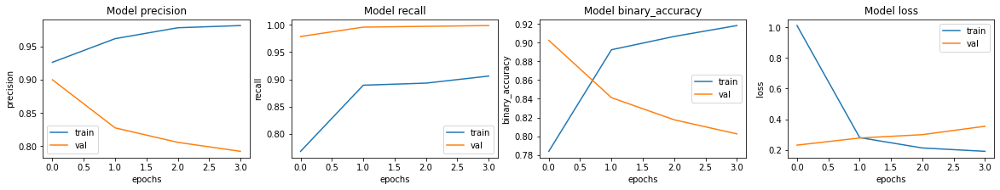

In [ ]:
fig, ax = plt.subplots(1, 4, figsize=(20, 3))
ax = ax.ravel()

for i, met in enumerate(["precision", "recall", "binary_accuracy", "loss"]):
    ax[i].plot(history.history[met])
    ax[i].plot(history.history["val_" + met])
    ax[i].set_title("Model {}".format(met))
    ax[i].set_xlabel("epochs")
    ax[i].set_ylabel(met)
    ax[i].legend(["train", "val"])

### Loading the Model



In [ ]:
loaded_mobilenet = tf.keras.models.load_model('xray_model.h5')

## Evaluate model

Let's evaluate the model on our test data!

In [ ]:
loaded_mobilenet.evaluate(test_ds_batch, return_dict=True)

3/3 [==============================] - 3s 437ms/step - loss: 0.6547 - binary_accuracy: 0.6939 - precision: 0.6749 - recall: 0.9846


{'loss': 0.6546863913536072,
 'binary_accuracy': 0.6939102411270142,
 'precision': 0.6748681664466858,
 'recall': 0.9846153855323792}

- We see that our accuracy on our test data is 69%, which is lower than the accuracy for our validating set. This may indicate overfitting.
### Try **finetuning the model** further to decrease overfitting to the training and validation sets.
- [Refer lecture 2 to deal with overfitting.]

- Our recall is greater than our precision, indicating that almost all pneumonia images are correctly identified but some normal images are falsely identified.
- We should aim to increase our precision.
   - link to refer for solutions:<br>
    1. https://stats.stackexchange.com/questions/134599/how-to-classify-a-unbalanced-dataset-by-convolutional-neural-networks-cnn
    2. https://www.tensorflow.org/tutorials/structured_data/imbalanced_data

Predicting on a test image using our trained MobileNet Model

This image is 34.41 percent NORMAL
This image is 65.59 percent PNEUMONIA
CPU times: user 4 µs, sys: 1e+03 ns, total: 5 µs
Wall time: 10.5 µs


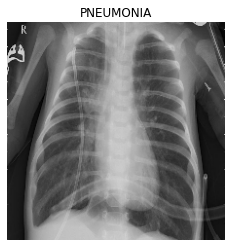

In [ ]:
for image, label in test_ds_batch.take(2):
      plt.imshow(image[2] / 255.0)
      plt.title(CLASS_NAMES[label[2].numpy()])
      plt.axis('off')
prediction = finetuned_mobilenet.predict(test_ds_batch.take(2))[2]
scores = [1 - prediction, prediction]
for score, name in zip(scores, CLASS_NAMES):
    print("This image is %.2f percent %s" % ((100 * score), name))
%time

## Confusion Matrix

In [ ]:
label_list = []
prediction_list = []

for image, label in test_ds:
    image = tf.expand_dims(image, axis = 0)
    prediction = finetuned_mobilenet.predict(image)
    label = tf.where(label, 1, 0)

    if prediction > 0.5 :
        prediction = 1
    else :
        prediction = 0

    prediction_list.append(prediction)
    label_list.append(label)

In [ ]:
test_confusion_matrix = tf.math.confusion_matrix(label_list, prediction_list)

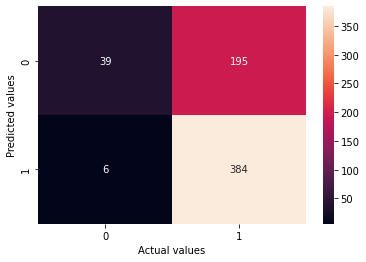

In [ ]:
ax = sns.heatmap(test_confusion_matrix, annot = True, fmt ='g')
ax.set(xlabel = 'Predicted values', ylabel = 'Actual values')

plt.show()

## GradCAM

In [ ]:
for i in range(len(finetuned_mobilenet.layers)):
    layer = finetuned_mobilenet.layers[i]
    if 'conv' not in layer.name:
        continue
    print(i , layer.name , layer.output.shape)

4 expanded_conv_depthwise (None, 112, 112, 32)
5 expanded_conv_depthwise_BN (None, 112, 112, 32)
6 expanded_conv_depthwise_relu (None, 112, 112, 32)
7 expanded_conv_project (None, 112, 112, 16)
8 expanded_conv_project_BN (None, 112, 112, 16)


Last convolutional layer for GRADCAM is expanded_conv_project_BN

In [ ]:
last_conv_layer_name = finetuned_mobilenet.layers[8].name
last_conv_layer_name

'expanded_conv_project_BN'

In [ ]:
!pip install tf-explain

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


This image is 34.41 percent NORMAL
This image is 65.59 percent PNEUMONIA


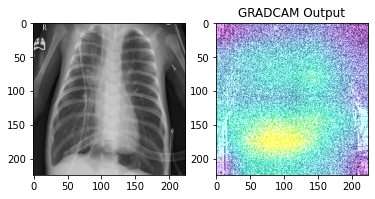

In [ ]:
from tf_explain.core.grad_cam import GradCAM
import random

for image, label in test_ds_batch.take(2):

    data = ([image[2].numpy()], None)
    # print('Original label',CLASS_NAMES[label[2].numpy()])
    image = image[2] / 255

prediction = finetuned_mobilenet.predict(test_ds_batch.take(2))[2]
scores = [1 - prediction, prediction]

for score, name in zip(scores, CLASS_NAMES):
    print("This image is %.2f percent %s" % ((100 * score), name))

# Start explainer
explainer = GradCAM()
grid = explainer.explain(data, finetuned_mobilenet,class_index = 0)

#subplot(r,c) provide the no. of rows and columns
f, axarr = plt.subplots(1, 2)

axarr[0].imshow(image)
axarr[1].imshow(grid)
# axarr[0].title.set_text(f"{float(prediction)*100:.2f}% penumonia predicted")
axarr[1].title.set_text('GRADCAM Output')
plt.show()

## Loading pretrained efficientnet:
https://keras.io/api/applications/efficientnet/

In [ ]:
with strategy.scope():
    pretrained_model = tf.keras.applications.EfficientNetB6(weights='imagenet', include_top=False, input_shape=[*IMAGE_SIZE, 3])
    pretrained_model.trainable = True # fine-tuning

    model = tf.keras.Sequential([
        # convert image format from int [0,255] to the format expected by this model
        tf.keras.layers.Lambda(lambda data: tf.keras.applications.efficientnet.preprocess_input(tf.cast(data, tf.float32)), input_shape=[*IMAGE_SIZE, 3]),
        pretrained_model,
        tf.keras.layers.GlobalAveragePooling2D(),
        tf.keras.layers.Dense(2, activation='softmax')
    ])

## Transformers (ViT)

In [ ]:
patches = tf.image.extract_patches(
        images=images,
        sizes=[1, self.patch_size, self.patch_size, 1],
        strides=[1, self.patch_size, self.patch_size, 1],
        rates=[1, 1, 1, 1],
        padding="VALID",
)

<img src=https://d2beiqkhq929f0.cloudfront.net/public_assets/assets/000/047/000/original/Screenshot_2023-09-08_at_12.23.45_PM.png?1694156046 width=800>

- Here if you observed The input image is broken into patches that are treated as the sequence input to the Transformer.
- The patches are represented by concatenating the patch pixel values and the patch position within the image:
   

In [ ]:
encoded = (tf.keras.layers.Dense(...)(patch) +
               tf.keras.layers.Embedding(...)(position))

- Note that the patch position is the ordinal number (5th, 6th, etc.) of the patch and is treated as a categorical variable.
- A learnable embedding is employed to capture close‐ ness relationships between patches that have related content.
- The patch representation is passed through multiple transformer blocks, each of which consists of an attention head (to learn which parts of the input to focus on)

In [ ]:

x1 = tf.keras.layers.LayerNormalization()(encoded)
#Just for sake of basic overview
attention_output = tf.keras.layers.MultiHeadAttention(
    num_heads=num_heads, key_dim=projection_dim, dropout=0.1
)(x1, x1)

The attention output is used to add emphasis to the patch representation:

In [ ]:

# Skip connection 1.
x2 = tf.keras.layers.Add()([attention_output, encoded])
x3 = tf.keras.layers.LayerNormalization()(x2)# Layer normalization 2.



and passed through a set of dense layers:

In [ ]:

# multilayer perceptron (mlp), a set of dense layers.
x3 = mlp(x3, hidden_units=transformer_units,
          dropout_rate=0.1)
# Skip connection 2 forms input to next block
encoded = tf.keras.layers.Add()([x3, x2])

# L7: Object Localisation and Detection -1

### Problem Statement:

- With increasing number of mass shooting incidents at schools, Malls and other public places across US, there is a need of always on and effective Monitoring systems that can identify potential dangers and alert beforehand.
- Law enforcement agencies that guard public places currently rely on technology like walk-through or handheld magnetometers, which detect changes in local magnetic fields.

- You are working as a Machine Learning Engineer at Omnilert AI.
- Your team is planning to create an AI-powered visual gun detection System that can identify threats and immediately trigger multi-channel alerts and automated pre-defined safety protocols.

- You are given the responsibility of developing ML powered system that can be used to connet with existing video surveillance cameras to reliably and rapidly recognize firearms.

<img src ='https://drive.google.com/uc?id=1iqs1yW5qmJpHNgudRKeJMhpgYoWtp2yj' width=350 height=350>

### Let's Load and Explore the Dataset for our Business case:

In [ ]:
!gdown 151WbWURL8IPXqhxi8vLCx7pmtvchegpZ

Downloading...
From: https://drive.google.com/uc?id=151WbWURL8IPXqhxi8vLCx7pmtvchegpZ
To: /content/PistolData_merged.zip
100% 78.7M/78.7M [00:00<00:00, 97.0MB/s]


In [ ]:
!unzip -q PistolData_merged.zip

In [ ]:
ls

__MACOSX/  PistolData_merged/  PistolData_merged.zip  sample_data/


In [ ]:
datapath = 'PistolData_merged/'
!ls {datapath}

pistol_annotations  pistol_images


In [ ]:
import os
annot_files = sorted(os.listdir(f'{datapath}pistol_annotations'))
img_files = sorted(os.listdir(f'{datapath}pistol_images'))

print(f'Total files: {len(annot_files)}')
print(f'Top 5: {annot_files[:5]}')
print(f'Top 5: {img_files[:5]}')

Total files: 3703
Top 5: ['1.txt', '10.txt', '100.txt', '1000.txt', '1001.txt']
Top 5: ['1.jpg', '10.jpg', '100.jpg', '1000.jpg', '1001.jpg']


#### Let's see what is the content of annotation files:

In [ ]:
for annot_file in annot_files[0:5]:
  with open(f'{datapath}pistol_annotations/{annot_file}','r') as f:
      print(f.readlines())

['1 0.4253846153846154 0.2447973713033954 0.22153846153846152 0.2814895947426068']
['1 0.4983922829581993 0.4907407407407407 0.3665594855305466 0.4506172839506173']
['1 0.6466602129719264 0.28387096774193543 0.08131655372700872 0.05935483870967742']
['1 0.5747967479674796 0.39390243902439026 0.27804878048780485 0.3341463414634146']
['1 0.5061538461538462 0.4229559748427673 0.3353846153846154 0.3050314465408805']




 <img src='https://drive.google.com/uc?id=1yOPZUmtpW-7yjg3q8Ev84H-C_l86bPYL'>

- contains 4 points which represent the location of Gun in the corresponding image as [x_center, y_center, w, h]

#### let's plot the co-ordinates on image:

[1.0, 0.4253846153846154, 0.2447973713033954, 0.22153846153846152, 0.2814895947426068]
ImgResolution (416, 416, 3)
[1.0, 0.5188888888888888, 0.6283333333333333, 0.22, 0.27]
ImgResolution (416, 416, 3)
[1.0, 0.5672727272727273, 0.27322404371584696, 0.4290909090909091, 0.5027322404371584]
ImgResolution (416, 416, 3)
[1.0, 0.6140684410646388, 0.23177083333333331, 0.49809885931558934, 0.2864583333333333]
ImgResolution (416, 416, 3)
[1.0, 0.6994535519125683, 0.37999999999999995, 0.07650273224043716, 0.23636363636363636]
ImgResolution (416, 416, 3)


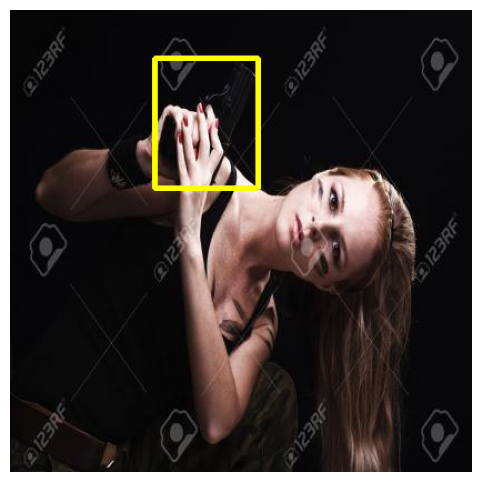

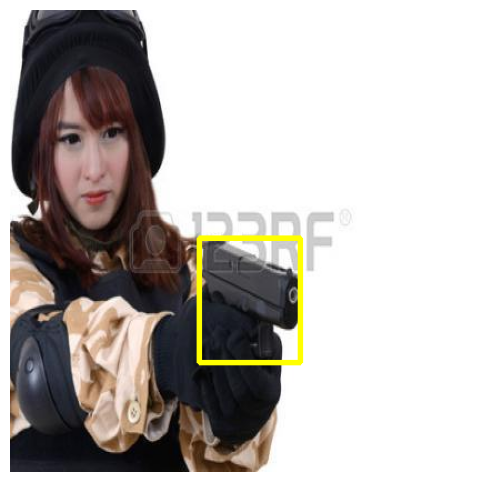

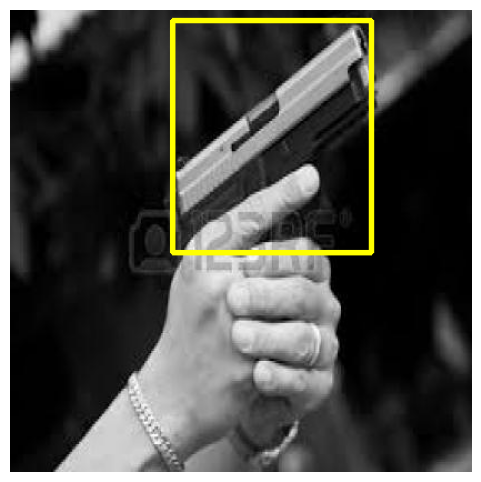

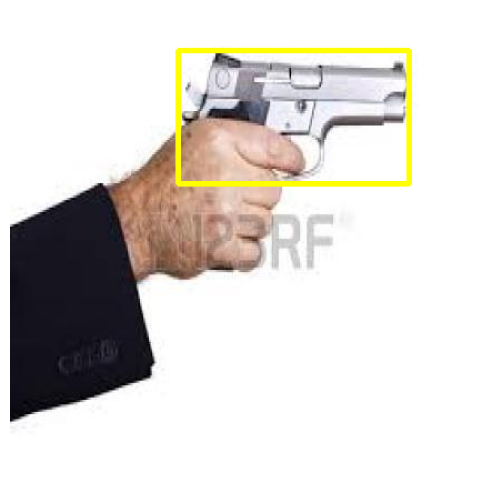

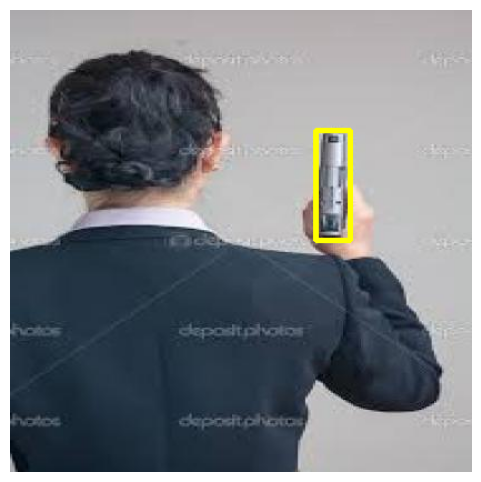

In [ ]:
import matplotlib.pyplot as plt
import cv2


img_h = 416
img_w = 416

def cv_coords(box):
  '''
  This function will convert B.B cordinates from (X_center,Y_center,width,height) format
  to (x_start,y_start,x_end,y_end) required for cv2 to annotate rectangle on objects
  '''
  x,y,w,h= box[1],box[2],box[3],box[4]
  x1, y1 = int((x-w/2)*img_w), int((y-h/2)*img_h)
  x2, y2 = int((x+w/2)*img_w), int((y+h/2)*img_h)
  return x1, y1, x2, y2


def plot_img_and_box(img, bbox):
  plt.figure(figsize=(6,6))
  print("ImgResolution",img.shape)
  bbox = cv_coords(bbox)
  start_point = (bbox[0],bbox[1])
  end_point = (bbox[2],bbox[3])
  img = cv2.rectangle(img,start_point,end_point,(255,255,0), 3)
  plt.axis('off')
  plt.imshow(img)

for i in range(5):
  img_path = f'{datapath}pistol_images/{i+1}.jpg'
  label_path = f'{datapath}pistol_annotations/{i+1}.txt'


  img = plt.imread(img_path)

  with open(label_path,'r') as f:
    bbox = (f.readlines())
    bbox = [float(element) for element in bbox[0].split(" ")]
    print(bbox)
  plot_img_and_box(img, bbox)

##  **Classification + Localization**

### Let's load the dataset into arrays:

In [ ]:
from tqdm.auto import tqdm
import numpy as np


def return_bbox(label_path):
  ''' read and return bbox from text file'''
  with open(label_path,'r') as f:
    bbox = (f.readlines())
    bbox = [float(element) for element in bbox[0].split(" ")]
    return bbox[0],bbox[1:]

def return_image_label(filename):
  '''
  read and return image as well as corresponding label and bbox from image file
  '''
  try:
    img_path = f'{datapath}pistol_images/{filename}.jpg'
    image = plt.imread(img_path)
    label_path = f'{datapath}pistol_annotations/{filename}.txt'
    class_label,bbox_label = return_bbox(label_path)
    return True,image,class_label,bbox_label
  except Exception as e:
    print("Exception: ",filename, str(e))
    return False,None,None, None


### Looping over all the files present in directory to extract image, labels and bbox
images, class_labels, bbox_labels = [], [],[]
for filename in tqdm(annot_files):
  filename = filename[:-4]
  status, image, class_label, bbox_label= return_image_label(filename)
  if status==True and image.shape==(416,416,3):
    images.append(image)
    class_labels.append(class_label)
    bbox_labels.append(bbox_label)


images,class_labels,bbox_labels = np.array(images),np.array(class_labels),np.array(bbox_labels)
images.shape, class_labels.shape, bbox_labels.shape

  0%|          | 0/3703 [00:00<?, ?it/s]

((3703, 416, 416, 3), (3703,), (3703, 4))

In [ ]:
class_labels

array([1., 1., 1., ..., 1., 1., 1.])

In [ ]:
bbox_labels

array([[0.42538462, 0.24479737, 0.22153846, 0.28148959],
       [0.49839228, 0.49074074, 0.36655949, 0.45061728],
       [0.64666021, 0.28387097, 0.08131655, 0.05935484],
       ...,
       [0.66423077, 0.51078799, 0.45153846, 0.815197  ],
       [0.49666667, 0.49450549, 0.92666667, 0.79120879],
       [0.48653846, 0.45345188, 0.97153846, 0.90481172]])

#### Frequency Distribution of Gun and No Gun class

In [ ]:
np.unique(class_labels, return_counts=True)

(array([0., 1.]), array([ 999, 2704]))

- there are **999** images with **no guns** while **2704** images **with Guns** present in frame

#### Now we will divide our dataset into train and test splits

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train_class, y_test_class, y_train_box, y_test_box  = train_test_split(
    images, class_labels, bbox_labels, test_size=0.30, random_state=42)
X_train.shape, X_test.shape, y_train_class.shape, y_test_class.shape,y_train_box.shape, y_test_box.shape,

((2592, 416, 416, 3),
 (1111, 416, 416, 3),
 (2592,),
 (1111,),
 (2592, 4),
 (1111, 4))

In [ ]:
y_train_box

array([[0.41620112, 0.56560284, 0.24022346, 0.10992908],
       [0.        , 0.        , 0.        , 0.        ],
       [0.48333333, 0.50518519, 0.75555556, 0.89481481],
       ...,
       [0.496875  , 0.5       , 0.98125   , 0.95      ],
       [0.5       , 0.47757848, 0.996875  , 0.95067265],
       [0.517     , 0.51201201, 0.694     , 0.96996997]])

In [ ]:
y_train_class

array([1., 0., 1., ..., 1., 1., 1.])

#### Let's create the architecture for generating BBOX Co-ordinates along with Class probability as discussed above:

In [ ]:
import tensorflow as tf

ResNet101 = tf.keras.applications.ResNet101(weights='imagenet',include_top=False,
                            input_tensor=tf.keras.layers.Input(shape=(416,416,3)))

ResNet101.trainable = False             # make trainable parameter as false

# add some trainable Dense layers
res_output = ResNet101.output
flat = tf.keras.layers.Flatten()(res_output)

# Classification head
x1 = tf.keras.layers.Dense(128,activation='relu')(flat)
x1 = tf.keras.layers.Dense(64,activation='relu')(x1)
x1 = tf.keras.layers.Dense(32,activation='relu')(x1)

# classification output: single class
clas_out = tf.keras.layers.Dense(1,activation='sigmoid',name='class_output')(x1)

# Regression head
x1 = tf.keras.layers.Dense(128,activation='relu')(flat)
x1 = tf.keras.layers.Dense(64,activation='relu')(x1)
x1 = tf.keras.layers.Dense(32,activation='relu')(x1)

# Regression output: 4 B.B Co-ordinates
reg_out = tf.keras.layers.Dense(4,activation='sigmoid', name='box_output')(x1)

ResNet101_final = tf.keras.models.Model(ResNet101.input,[reg_out,clas_out])

171446536/171446536 [==============================] - 9s 0us/step


In [ ]:
ResNet101_final.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 416, 416, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 422, 422, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 208, 208, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 208, 208, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                          

### Model Configurations and Loss function mappings:

> Indented block



 <img src='https://drive.google.com/uc?id=1b95a0OuOQditpxSr-aGt5eVTTkSG3pre' width=700 height=350>

In [ ]:
# loss for Classification + Regression
losses = { "class_output":"binary_crossentropy",
          "box_output":"mean_squared_error"}

# loss weight: Optional
loss_weights = {"box_output":4.0,
          "class_output":1.0}

# metrics for both head to track
metrics = {"box_output":"mse",
          "class_output":"accuracy"}

# Optimizer
opt = tf.keras.optimizers.Adam(learning_rate=1e-4)

# Compile model
ResNet101_final.compile(optimizer=opt,loss=losses,loss_weights=loss_weights,metrics=metrics)

#### Let's train the model

In [ ]:
# tensorboard setup for visualization
log_dir = "pistol_Log"
!rm -rf log_dir
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir)

# start training the model
history = ResNet101_final.fit(x=X_train, y={"class_output":y_train_class, "box_output":y_train_box},
                              validation_data=(X_test, {"class_output":y_test_class, "box_output":y_test_box}),
                              batch_size=32,
                              epochs=10,
                              callbacks=(tensorboard_callback)
                           )

Epoch 1/10
81/81 [==============================] - 85s 800ms/step - loss: 0.2548 - box_output_loss: 0.0450 - class_output_loss: 0.0748 - box_output_mse: 0.0450 - class_output_accuracy: 0.9765 - val_loss: 0.1358 - val_box_output_loss: 0.0264 - val_class_output_loss: 0.0303 - val_box_output_mse: 0.0264 - val_class_output_accuracy: 0.9955
Epoch 2/10
81/81 [==============================] - 66s 814ms/step - loss: 0.0988 - box_output_loss: 0.0241 - class_output_loss: 0.0026 - box_output_mse: 0.0241 - class_output_accuracy: 0.9985 - val_loss: 0.0830 - val_box_output_loss: 0.0168 - val_class_output_loss: 0.0157 - val_box_output_mse: 0.0168 - val_class_output_accuracy: 0.9973
Epoch 3/10
81/81 [==============================] - 65s 808ms/step - loss: 0.0718 - box_output_loss: 0.0177 - class_output_loss: 9.4645e-04 - box_output_mse: 0.0177 - class_output_accuracy: 0.9996 - val_loss: 0.0654 - val_box_output_loss: 0.0128 - val_class_output_loss: 0.0141 - val_box_output_mse: 0.0128 - val_class_out

- Both Class Loss and BBox loss are decreasing continously as expected.
- Let's Visualize the training on tensorboard

In [ ]:
# !pip install tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir={log_dir}

<IPython.core.display.Javascript object>

#### Our Localization model is ready. Let's use it for inference and learn evaluation methods:

### Prediction and Evaluation

Let's predict Image from our testset

In [ ]:
def predict(input_img_arr, model ,mode='single'):
  if mode is 'single':
    input_img_arr = np.expand_dims(input_img_arr, axis = 0)
    pred_box, class_prob = model.predict(input_img_arr)
    return pred_box[0], class_prob[0]

  else:
    pred_box, class_prob = model.predict(input_img_arr)
    return pred_box, class_prob

predict(X_test[0], ResNet101_final)

(array([0.53958523, 0.3081458 , 0.07448691, 0.22560748], dtype=float32),
 array([1.], dtype=float32))

In [ ]:
predict(X_test[0:4], ResNet101_final, "batch")

(array([[5.3958511e-01, 3.0814546e-01, 7.4486807e-02, 2.2560771e-01],
        [4.1671807e-01, 4.3104801e-01, 2.1861598e-01, 3.7124982e-01],
        [1.7963430e-04, 7.8867655e-05, 1.8680481e-04, 2.7463898e-06],
        [7.2263286e-04, 8.7296641e-05, 1.7045537e-04, 5.9578946e-07]],
       dtype=float32), array([[1.0000000e+00],
        [9.9999785e-01],
        [3.5026903e-17],
        [3.5760831e-17]], dtype=float32))

### Evaluate MSE and BCE on test set

In [ ]:
eval_res = ResNet101_final.evaluate(X_test, {"class_output":y_test_class, "box_output":y_test_box})

35/35 [==============================] - 19s 532ms/step - loss: 0.0630 - box_output_loss: 0.0099 - class_output_loss: 0.0234 - box_output_mse: 0.0099 - class_output_accuracy: 0.9973


In [ ]:
print(f'''Total Loss: {eval_res[0]}\nBBox MSE Loss{eval_res[1]}\nClass BCE Loss: {eval_res[2]}\nBBox MSE: {eval_res[3]}\nAccuracy Score: {eval_res[4]}\n''')

Total Loss: 0.06298098713159561
BBox MSE Loss0.00990129355341196
Class BCE Loss: 0.023375799879431725
BBox MSE: 0.00990129355341196
Accuracy Score: 0.9972997307777405



Plot Predicted Bounding Boxes Against Ground Truth Boxes

Ground Truth:  [0.50625    0.45416667 0.9125     0.89166667]
Predicted Bbox : [0.47375596 0.4802968  0.92174673 0.96721107]
ImgResolution (416, 416, 3)


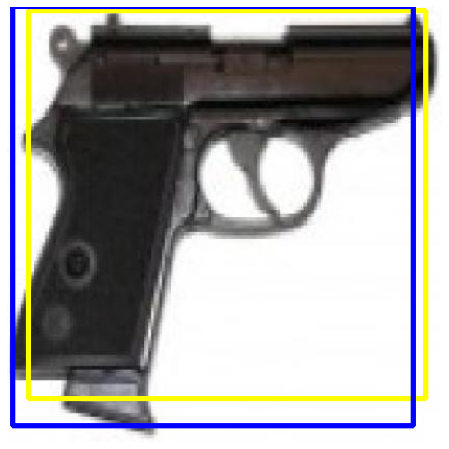

In [ ]:
import matplotlib.pyplot as plt
import cv2


def cv_coords(box):
  '''
  This function will convert B.B cordinates from (X_center,Y_center,width,height)  format
  to (x_start,y_start,x_end,y_end) required for cv2 to create rectangle
  '''
  x,y,w,h= box[0],box[1],box[2],box[3]
  x1, y1 = int((x-w/2)*img_w), int((y-h/2)*img_h)
  x2, y2 = int((x+w/2)*img_w), int((y+h/2)*img_h)
  return x1, y1, x2, y2



def plot_prediction(img, label, pred):
  img = img.copy()
  plt.figure(figsize=(8,8))
  print("ImgResolution",img.shape)

  # annotate ground truth
  bbox = cv_coords(label)
  start_point = (bbox[0],bbox[1])
  end_point = (bbox[2],bbox[3])
  img = cv2.rectangle(img,start_point,end_point,(255,255,0), 3)
  cv2.putText(img, 'Ground Truth', (start_point[0],start_point[1]-5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,0))


  # annotate prediction
  bbox = cv_coords(pred)
  start_point = (bbox[0],bbox[1])
  end_point = (bbox[2],bbox[3])
  img = cv2.rectangle(img,start_point,end_point,(0,0,255), 3)
  cv2.putText(img, 'Prediction', (start_point[0],start_point[1]-5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,0))


  plt.axis('off')
  plt.imshow(img)

# set index which will be used for prediction and plot
index = 500

label = y_test_box[index]

img = X_test[index]
pred_box, class_prob = predict(img, ResNet101_final)

print("Ground Truth: ",label )
print("Predicted Bbox :", pred_box)

plot_prediction(img, label, pred_box)

Ground Truth:  [0.5125     0.49166667 0.95       0.96666667]
Predicted Bbox : [0.46633035 0.5589273  0.9450195  0.96038187]
ImgResolution (416, 416, 3)


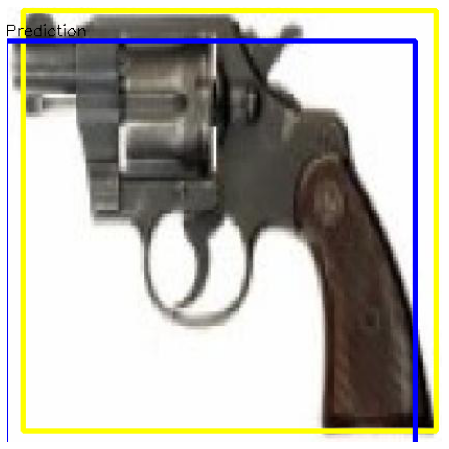

In [ ]:
index = 101

label = y_test_box[index]

img = X_test[index]
pred_box, class_prob = predict(img, ResNet101_final)

print("Ground Truth: ",label )
print("Predicted Bbox :", pred_box)

plot_prediction(img, label, pred_box)

Ground Truth:  [0. 0. 0. 0.]
Predicted Bbox : [1.5601865e-03 1.4866996e-04 2.8225625e-04 1.4089792e-05]
ImgResolution (416, 416, 3)


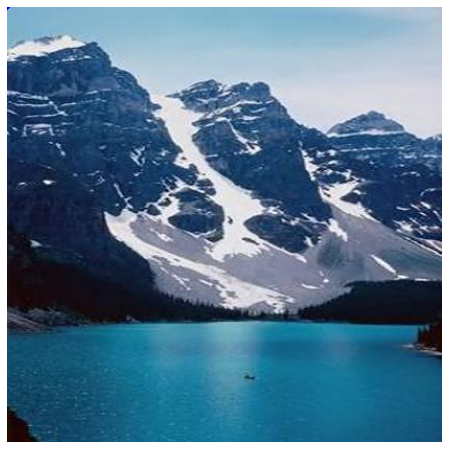

In [ ]:
index = 5

label = y_test_box[index]

img = X_test[index]
pred_box, class_prob = predict(img, ResNet101_final)

print("Ground Truth: ",label )
print("Predicted Bbox :", pred_box)

plot_prediction(img, label, pred_box)

## IOU

Ground Truth:  [0.21939954 0.43021583 0.26096998 0.23741007]
Predicted Bbox : [0.27369243 0.33731556 0.2626449  0.27189463]
ImgResolution (416, 416, 3)


0.38374425772851495

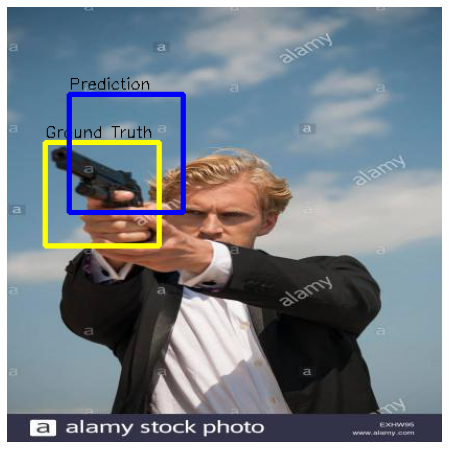

In [ ]:
def compute_iou(label_box, pred_box):
  # determine the (x, y)-coordinates of the intersection rectangle
  gt = [0,0,0,0]
  x1,y1,x2,y2 = cv_coords(label_box)
  gt[0],gt[1],gt[2],gt[3] = x1,y1,x2,y2

  pred = [0,0,0,0]
  x1,y1,x2,y2=cv_coords(pred_box)
  pred[0],pred[1],pred[2],pred[3] = x1,y1,x2,y2

  inter_box_top_left = [max(gt[0], pred[0]), max(gt[1], pred[1])]
  inter_box_bottom_right = [min(gt[0]+gt[2], pred[0]+pred[2]), min(gt[1]+gt[3], pred[1]+pred[3])]

  inter_box_w = inter_box_bottom_right[0] - inter_box_top_left[0]
  inter_box_h = inter_box_bottom_right[1] - inter_box_top_left[1]

  intersection = inter_box_w * inter_box_h
  union = gt[2] * gt[3] + pred[2] * pred[3] - intersection

  iou_area = intersection / (union+10e-3)
  return iou_area


index = 100

label = y_train_box[index]

img = X_train[index]
pred_box, class_prob = predict(img, ResNet101_final)

print("Ground Truth: ",label )
print("Predicted Bbox :", pred_box)

plot_prediction(img, label, pred_box)
compute_iou(label, pred_box)

#### Mean IOU:
- We can also calcualte mean IoU by simply calculating IoU for all the Images in test set and taking Average:

In [ ]:
def mean_intersection_over_union(X_test,gt_box, pred_box):
    iou = []
    for ind in range(len(X_test)):
      iou_area = compute_iou(gt_box[ind],pred_box[ind] )
      iou.append(iou_area)
    iou = np.array(iou)
    return np.mean(iou)

gt_box = y_train_box
pred_box = predict(X_train, ResNet101_final, 'batch')[0]

train_meanIOU = mean_intersection_over_union(X_train, gt_box, pred_box)

print(f'Mean IoU Train: {train_meanIOU}')

Mean IoU Train: 0.7423182413946467


In [ ]:
gt_box = y_test_box
pred_box = predict(X_test, ResNet101_final, 'batch')[0]

test_meanIOU = mean_intersection_over_union(X_test, gt_box, pred_box)

print(f'Mean IoU Test: {test_meanIOU}')

Mean IoU Test: 0.44792014324682944


## Multi object detection
### NMS

In [ ]:
# ### Implement NMS
def non_max_suppress(conf, xy_min, xy_max, threshold=.4):
    _, _, classes = conf.shape
    boxes = [(_conf, _xy_min, _xy_max) for _conf, _xy_min, _xy_max in zip(conf.reshape(-1, classes), xy_min.reshape(-1, 2), xy_max.reshape(-1, 2))]

    # Iterate each class
    for c in range(classes):
        # Sort boxes
        boxes.sort(key=lambda box: box[0][c], reverse=True)
        # Iterate each box
        for i in range(len(boxes) - 1):
            box = boxes[i]
            if box[0][c] == 0:
                continue
            for _box in boxes[i + 1:]:
                # Take iou threshold into account
                if compute_iou(box[1], box[2], _box[1], _box[2]) >= threshold:
                    _box[0][c] = 0
    return boxes


## RPN

Code Implentation of Backbone for FasterRCNN(VGG:

<img src='https://drive.google.com/uc?id=1sJ1LQ3FU5Ldqz_Q1VY-Yo-ZfJUwxjpxL' width=800>

In [ ]:
def partial_vgg(input_tensor=None):

    input_shape = (None, None, 3)

    img_input = Input(shape=input_shape)

    # Block 1
    x = Conv2D(64, (3, 3), activation='relu', padding='same', name='block1_conv1')(img_input)
    x = Conv2D(64, (3, 3), activation='relu', padding='same', name='block1_conv2')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block1_pool')(x)
    print(x)

    # Block 2
    x = Conv2D(128, (3, 3), activation='relu', padding='same', name='block2_conv1')(x)
    x = Conv2D(128, (3, 3), activation='relu', padding='same', name='block2_conv2')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block2_pool')(x)
    print(x)

    # Block 3
    x = Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv1')(x)
    x = Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv2')(x)
    x = Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv3')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block3_pool')(x)
    print(x)

    # Block 4
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv1')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv2')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv3')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block4_pool')(x)
    print(x)

    # Block 5
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv1')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv2')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv3')(x)
    # x = MaxPooling2D((2, 2), strides=(2, 2), name='block5_pool')(x)

    # We are not using fully connected layers (3 fc layers) as we need feature maps as output from this network.

    return x

Code Implementation OF RPN:

In [ ]:
""
#RPN layer
def rpn_layer(base_layers, num_anchors):

    #cnn_used for creating feature maps: vgg, num_anchors: 9
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(base_layers)

    #classification layer: num_anchors (9) channels for 0, 1 sigmoid activation output
    x_class = Conv2D(num_anchors, (1, 1), activation='sigmoid')(x)

    #regression layer: num_anchors*4 (36) channels for computing the regression of bboxes
    x_regr = Conv2D(num_anchors * 4, (1, 1), activation='linear')(x)

    return [x_class, x_regr, base_layers] #classification of object(0 or 1),compute bounding boxes, base layers vgg

Code Implementation of ROI Pooling Layer:

In [ ]:
class RoiPoolingConv(Layer):
  '''ROI pooling layer for 2D inputs.
    See Spatial Pyramid Pooling in Deep Convolutional Networks for Visual Recognition,
    K. He, X. Zhang, S. Ren, J. Sun
    # Arguments
        pool_size: int
            Size of pooling region to use. pool_size = 7 will result in a 7x7 region.
        num_rois: number of regions of interest to be used
    # Input shape
        list of two 4D tensors [X_img,X_roi] with shape:
        X_img:
        `(1, rows, cols, channels)`
        X_roi:
        `(1,num_rois,4)` list of rois, with ordering (x,y,w,h)
    # Output shape
        3D tensor with shape:
        `(1, num_rois, channels, pool_size, pool_size)`
    '''

    def __init__(self, pool_size, num_rois, **kwargs):

        self.dim_ordering = K.image_dim_ordering()
        self.pool_size = pool_size
        self.num_rois = num_rois

        super(RoiPoolingConv, self).__init__(**kwargs)

    def build(self, input_shape):
        self.nb_channels = input_shape[0][3]

    def compute_output_shape(self, input_shape):
        return None, self.num_rois, self.pool_size, self.pool_size, self.nb_channels

    def call(self, x, mask=None):

        assert(len(x) == 2)

        # x[0] is image with shape (rows, cols, channels)
        img = x[0]

        # x[1] is roi with shape (num_rois,4) with ordering (x,y,w,h)
        rois = x[1]

        input_shape = K.shape(img)

        outputs = []

        for roi_idx in range(self.num_rois):

            x = rois[0, roi_idx, 0]
            y = rois[0, roi_idx, 1]
            w = rois[0, roi_idx, 2]
            h = rois[0, roi_idx, 3]

            x = K.cast(x, 'int32')
            y = K.cast(y, 'int32')
            w = K.cast(w, 'int32')
            h = K.cast(h, 'int32')

            # Resized roi of the image to pooling size (7x7)
            rs = tf.image.resize_images(img[:, y:y+h, x:x+w, :], (self.pool_size, self.pool_size))
            outputs.append(rs)


        final_output = K.concatenate(outputs, axis=0)

        # Reshape to (1, num_rois, pool_size, pool_size, nb_channels) : (1, 4, 7, 7, 3)
        final_output = K.reshape(final_output, (1, self.num_rois, self.pool_size, self.pool_size, self.nb_channels))

        # permute_dimensions is similar to transpose
        final_output = K.permute_dimensions(final_output, (0, 1, 2, 3, 4))

        return final_output


    def get_config(self):
        config = {'pool_size': self.pool_size,
                  'num_rois': self.num_rois}
        base_config = super(RoiPoolingConv, self).get_config()
        return dict(list(base_config.items()) + list(config.items()))

In [ ]:
#Classifier layer

def classifier_layer(base_layers, input_rois, num_rois, nb_classes = 4):

    # base_layers: vgg
    #input_rois: `(1,num_rois,4)` list of rois, with ordering (x,y,w,h)
    #num_rois: number of rois to be processed in one time (4 in here)

    input_shape = (num_rois,7,7,512)

    pooling_regions = 7

    # out_roi_pool.shape = (1, num_rois, channels, pool_size, pool_size)
    # num_rois (4) 7x7 roi pooling
    out_roi_pool = RoiPoolingConv(pooling_regions, num_rois)([base_layers, input_rois])

    # Flatten the convlutional layer and connected to 2 FC and 2 dropout
    out = Flatten(name='flatten')(out_roi_pool) #expanded into a vector with 25,088 (7×7×512) channels.
    out = Dense(4096, activation='relu', name='fc1')(out)
    out = Dropout(0.5)(out)
    out = Dense(4096, activation='relu', name='fc2')(out)
    out = Dropout(0.5)(out)

    # two output layer- classifier and regressor
    # for classify the class name of the object
    out_class = Dense(nb_classes, activation='softmax', kernel_initializer='zero'), name='dense_class_{}'.format(nb_classes)(out)

    #for bboxes coordinates regression
    out_regr = Dense(4 * (nb_classes-1), activation='linear', kernel_initializer='zero'), name='dense_regress_{}'.format(nb_classes)(out)

    return [out_class, out_regr]

# L8: Object Localisation and Detection -2

## Problem Statement:
You are working as a Machine learning Engineer in Tesla as part of the Autonomous driving team focused on building prototype ML model to identify and detect location of:
- Traffic Lights, Stop signs
- Other Vehicles such as Car, Bicycles, Truck etc
- Pedestrian(People)
- Animals

on the road in realtime using the Camera installed in the deck of the owners car.

### Real time constraints:

- Our Object Detection Algorithm needs to be Fast enough to **run inference in RealTime** on commodity hardware(CPU only) and **highly accurate to ensure safety.**


Let's see how we can achieve this Balance using new family of Object Detection Algorithms: **Single Stage Detectors**.



<img src ='https://drive.google.com/uc?id=1Ty9Bjh4HiCgSbXbNQ8gTGA_z4ggxZbf8'>

## Yolo

In [ ]:
def _conv_block(inp, convs, skip=True):
	x = inp
	count = 0
	for conv in convs:
		if count == (len(convs) - 2) and skip:
			skip_connection = x
		count += 1
		if conv['stride'] > 1: x = ZeroPadding2D(((1,0),(1,0)))(x) #padding as darknet prefer left and top
		x = Conv2D(conv['filter'],
				   conv['kernel'],
				   strides=conv['stride'],
				   padding='valid' if conv['stride'] > 1 else 'same', #  padding as darknet prefer left and top
				   name='conv_' + str(conv['layer_idx']),
				   use_bias=False if conv['bnorm'] else True)(x)
		if conv['bnorm']: x = BatchNormalization(epsilon=0.001, name='bnorm_' + str(conv['layer_idx']))(x)
		if conv['leaky']: x = LeakyReLU(alpha=0.1, name='leaky_' + str(conv['layer_idx']))(x)
	return add([skip_connection, x]) if skip else x

In [ ]:
def make_yolov3_model():
	input_image = Input(shape=(None, None, 3))
	# Layer  0 => 4
	x = _conv_block(input_image, [{'filter': 32, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 0},
								  {'filter': 64, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 1},
								  {'filter': 32, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 2},
								  {'filter': 64, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 3}])
	# Layer  5 => 8
	x = _conv_block(x, [{'filter': 128, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 5},
						{'filter':  64, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 6},
						{'filter': 128, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 7}])
	# Layer  9 => 11
	x = _conv_block(x, [{'filter':  64, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 9},
						{'filter': 128, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 10}])
	# Layer 12 => 15
	x = _conv_block(x, [{'filter': 256, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 12},
						{'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 13},
						{'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 14}])
	# Layer 16 => 36
	for i in range(7):
		x = _conv_block(x, [{'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 16+i*3},
							{'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 17+i*3}])
	skip_36 = x
	# Layer 37 => 40
	x = _conv_block(x, [{'filter': 512, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 37},
						{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 38},
						{'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 39}])
	# Layer 41 => 61
	for i in range(7):
		x = _conv_block(x, [{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 41+i*3},
							{'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 42+i*3}])
	skip_61 = x
	# Layer 62 => 65
	x = _conv_block(x, [{'filter': 1024, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 62},
						{'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 63},
						{'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 64}])
	# Layer 66 => 74
	for i in range(3):
		x = _conv_block(x, [{'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 66+i*3},
							{'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 67+i*3}])
	# Layer 75 => 79
	x = _conv_block(x, [{'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 75},
						{'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 76},
						{'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 77},
						{'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 78},
						{'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 79}], skip=False)
	# Layer 80 => 82
	yolo_82 = _conv_block(x, [{'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 80},
							  {'filter':  255, 'kernel': 1, 'stride': 1, 'bnorm': False, 'leaky': False, 'layer_idx': 81}], skip=False)
	# Layer 83 => 86
	x = _conv_block(x, [{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 84}], skip=False)
	x = UpSampling2D(2)(x)
	x = concatenate([x, skip_61])
	# Layer 87 => 91
	x = _conv_block(x, [{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 87},
						{'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 88},
						{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 89},
						{'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 90},
						{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 91}], skip=False)
	# Layer 92 => 94
	yolo_94 = _conv_block(x, [{'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 92},
							  {'filter': 255, 'kernel': 1, 'stride': 1, 'bnorm': False, 'leaky': False, 'layer_idx': 93}], skip=False)
	# Layer 95 => 98
	x = _conv_block(x, [{'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True,   'layer_idx': 96}], skip=False)
	x = UpSampling2D(2)(x)
	x = concatenate([x, skip_36])
	# Layer 99 => 106
	yolo_106 = _conv_block(x, [{'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 99},
							   {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 100},
							   {'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 101},
							   {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 102},
							   {'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 103},
							   {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 104},
							   {'filter': 255, 'kernel': 1, 'stride': 1, 'bnorm': False, 'leaky': False, 'layer_idx': 105}], skip=False)
	model = Model(input_image, [yolo_82, yolo_94, yolo_106])
	return model

## Yolo Pretrained

#### Let's Start with downloading the dataset and explore:

In [ ]:
!gdown 1Y5OHRq4KPVZuvY2BnuUnsEXq9o_GuzBM

Downloading...
From: https://drive.google.com/uc?id=1Y5OHRq4KPVZuvY2BnuUnsEXq9o_GuzBM
To: /content/selfdriving cars data.zip
100% 946M/946M [00:08<00:00, 107MB/s] 


In [ ]:
!ls

 sample_data  'selfdriving cars data.zip'


In [ ]:
!unzip -q '/content/selfdriving cars data.zip'

In [ ]:
!ls 'selfdriving cars data'

images	labels_train.csv  labels_trainval.csv  labels_val.csv


In [ ]:
from glob import glob

print("Sample Images: ")
glob('/content/selfdriving cars data/images/*jpg')[:5]

Sample Images: 


['/content/selfdriving cars data/images/1478899035854106975.jpg',
 '/content/selfdriving cars data/images/1478020383696274836.jpg',
 '/content/selfdriving cars data/images/1478732702893512106.jpg',
 '/content/selfdriving cars data/images/1478900302974589393.jpg',
 '/content/selfdriving cars data/images/1479499538043380876.jpg']

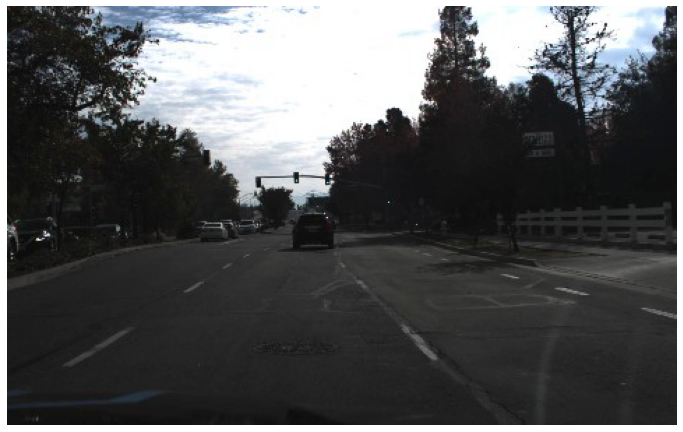

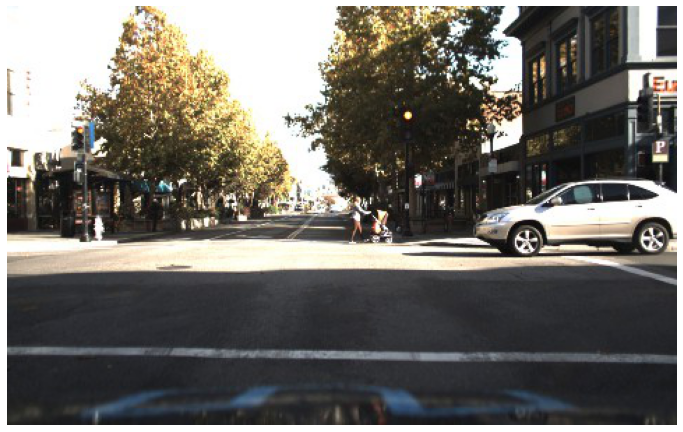

In [ ]:
## let's plot top two images in dataset
import matplotlib.pyplot as plt

for image_path in glob('/content/selfdriving cars data/images/*jpg')[:2]:
  plt.figure(figsize=(12,8))
  img = plt.imread(image_path)
  plt.imshow(img)
  plt.axis('off')
  plt.show()


### Let's get the Model Files and config as well:

In [ ]:
!gdown 1g7BocB3bO9l3qk8pzBmn7F32A9ib3Tf2

Downloading...
From: https://drive.google.com/uc?id=1g7BocB3bO9l3qk8pzBmn7F32A9ib3Tf2
To: /content/YoloV5_ONNX.zip
100% 31.3M/31.3M [00:00<00:00, 60.7MB/s]


In [ ]:
!unzip -q '/content/YoloV5_ONNX.zip'

In [ ]:
ls

 coco.names.txt  'selfdriving cars data'/      YoloV5_ONNX.zip
 __MACOSX/       'selfdriving cars data.zip'   yolov5s.onnx
 sample_data/     yolov5n.onnx


- The files ending with ONNX are our saved Model Files.

> Indented block


- coco.names contains all the 90 Class Labels which were used to train the Yolo Model.

Let's checkout the content of coco.names file:

In [ ]:
# Load class names.
classesFile = "/content/coco.names.txt"
classes = None

with open(classesFile, 'rt') as f:
      classes = f.read().rstrip('\n').split('\n')

# print ID and value of classes in COCO
print(dict(enumerate(classes)))

{0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorbike', 4: 'aeroplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'sofa', 58: 'pottedplant', 59: 'bed', 60: 'diningtable', 61: 'toilet', 62: 'tvmonitor', 63: 'laptop', 64: 'mouse', 65: 'remote', 66: 'keyboard', 67: 'cell phone', 68: 'mi

As You can see it contains 90 different classes of which some are similar to what we want to detect in our Use-Case

#### Let's setup config for model

In [ ]:
import cv2
import numpy as np

# input image width and height
INPUT_WIDTH = 640
INPUT_HEIGHT = 640

# probability threshold to filter boxes with object or no object
OBJECT_SCORE_THRESHOLD = 0.5

# # probability threshold to detect and Assign Class
CLASS_CONFIDENCE_THRESHOLD = 0.45

# IOU AREA Threshold to suppress redundant boxes using NMS
NMS_THRESHOLD = 0.45

# Text parameters used for annotating label on Image
FONT_FACE = cv2.FONT_HERSHEY_SIMPLEX
FONT_SCALE = 0.4
THICKNESS = 1
BOX_COLOR = (0,255,255)
FONT_COLOR= (0,0,0)


In [ ]:
def draw_label(im, label, x, y):
    """Function used for Drawing text/label onto image at location."""

    # Get text size.
    text_size = cv2.getTextSize(label, FONT_FACE, FONT_SCALE, THICKNESS)
    dim, baseline = text_size[0], text_size[1]

    # Use text size to create a BLACK rectangle.
    cv2.rectangle(im, (x,y), (x + dim[0], y - (dim[1]+baseline) ), (255,255,255), cv2.FILLED);

    # Display text inside the rectangle.
    cv2.putText(im, label, (x, y - dim[1]+baseline ), FONT_FACE, FONT_SCALE, FONT_COLOR, THICKNESS, cv2.LINE_AA)

In [ ]:
def yolo_forward_pass(input_image, net):
      """Performs forward pass to generate prediction using image and Loaded Yolo Model as parameters """
      # Create a 4D blob from a frame
      blob = cv2.dnn.blobFromImage(input_image, 1/255,  (INPUT_WIDTH, INPUT_HEIGHT), [0,0,0], 1, crop=False)

      # Sets the input to the network.
      net.setInput(blob)

      # Run the forward pass to get output of the output layers.
      outputs = net.forward(net.getUnconnectedOutLayersNames())

      return outputs

In [ ]:
def post_process_outputs(input_image, outputs):
      """ Takes Model Prediction outputs from forward pass function and performs post-processing tasks:
      1. Removing predictions with Low Confidence score
      2. Filtering only classes required for our task such as Vehicles, Human, traffic light stop sgn etc
      3. Perform NMS to suppress redundant or Duplicate boxes
      4. Annotate/draw remaining boxes on the Image
      """
      # Lists to hold respective values while unwrapping.
      class_ids = []
      confidences = []
      boxes = []

      # Rows
      rows = outputs[0].shape[1]
      image_height, image_width = input_image.shape[:2]

      # Resizing factor.
      x_factor = image_width / INPUT_WIDTH
      y_factor =  image_height / INPUT_HEIGHT

      # Iterate through detections.
      for r in range(rows):
            row = outputs[0][0][r]
            confidence = row[4]

            # Discard bad detections and continue.
            if confidence >= OBJECT_SCORE_THRESHOLD:
                  classes_scores = row[5:]

                  # Get the index of max class score.
                  class_id = np.argmax(classes_scores)

                  #  Continue if the class score is above threshold.
                  if (classes_scores[class_id] > CLASS_CONFIDENCE_THRESHOLD):
                        confidences.append(confidence)
                        class_ids.append(class_id)
                        cx, cy, w, h = row[0], row[1], row[2], row[3]

                        left = int((cx - w/2) * x_factor)
                        top = int((cy - h/2) * y_factor)
                        width = int(w * x_factor)
                        height = int(h * y_factor)

                        box = np.array([left, top, width, height])
                        boxes.append(box)

      # filter redundant Boxes using NMS Threshold
      indices = cv2.dnn.NMSBoxes(boxes, confidences, CLASS_CONFIDENCE_THRESHOLD, NMS_THRESHOLD)

      # plot remaining boxes
      for i in indices:
            box = boxes[i]
            left = box[0]
            top = box[1]
            width = box[2]
            height = box[3]

            # Draw bounding box.
            cv2.rectangle(input_image, (left, top), (left + width, top + height), BOX_COLOR, 2*THICKNESS)

            # Class label.
            label = "{}:{:.2f}".format(classes[class_ids[i]], confidences[i])

            # Draw label.
            draw_label(input_image, label, left, top)

      return input_image


In [ ]:
sample_images = ['/content/selfdriving cars data/images/1478732518231513348.jpg',
 '/content/selfdriving cars data/images/1478900224707428956.jpg',
 '/content/selfdriving cars data/images/1478898970726449449.jpg',
 '/content/selfdriving cars data/images/1478895374457789828.jpg',
 '/content/selfdriving cars data/images/1479504796899191419.jpg',
 '/content/selfdriving cars data/images/1479498467969466999.jpg']

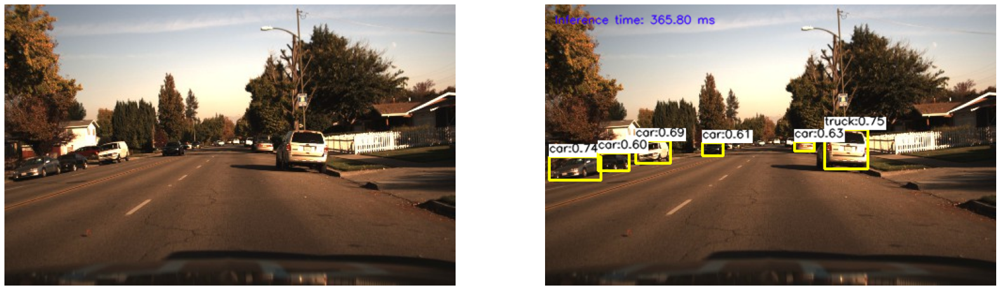

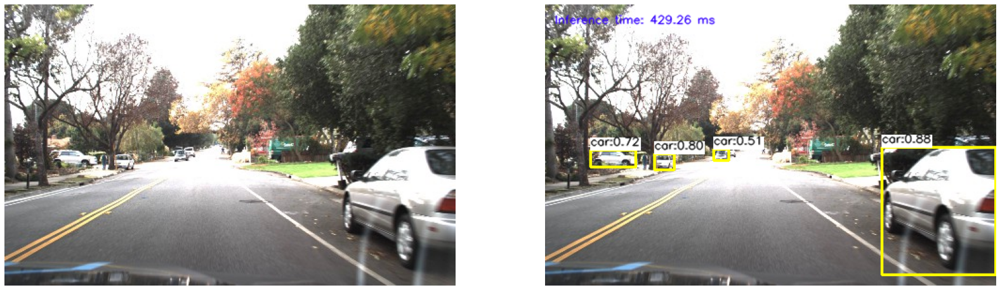

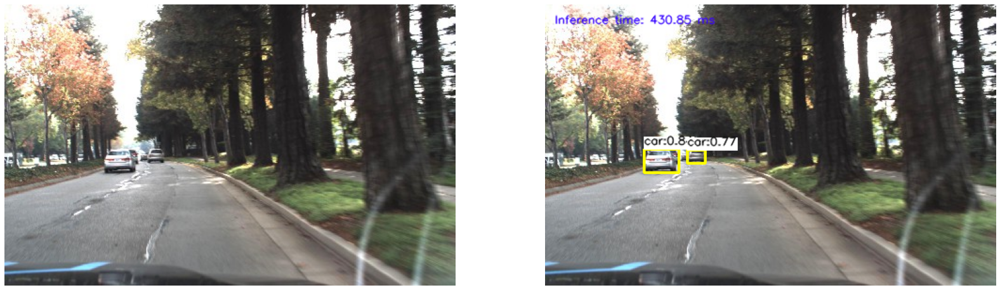

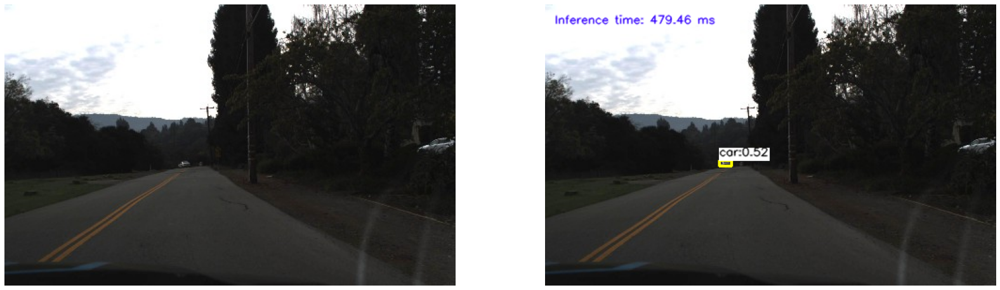

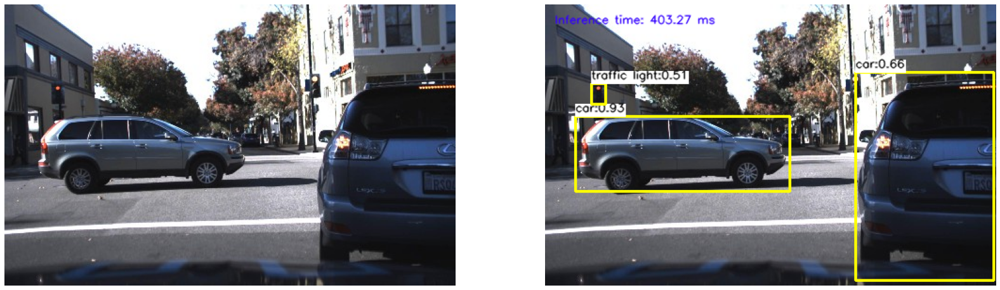

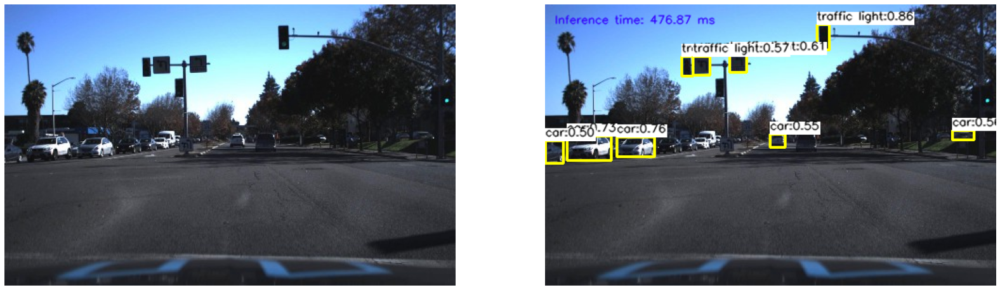

In [ ]:
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt


# Load class names.
classesFile = "/content/coco.names.txt"
classes = None

with open(classesFile, 'rt') as f:
      classes = f.read().rstrip('\n').split('\n')

# Load the model using cv2.dnn.readNet: Yolo V5 Nano Model
modelWeights = "/content/yolov5n.onnx"
net = cv2.dnn.readNet(modelWeights)

for image_path in sample_images:
  # Load image
  frame = cv2.imread(image_path)


  # Process image:
  detections = yolo_forward_pass(frame, net)
  pred_img = post_process_outputs(frame.copy(), detections)

  """
  Annotate efficiency information. The function getPerfProfile returns the overall time for inference(t)
  and the timings for each of the layers(in layersTimes).
  """
  t, _ = net.getPerfProfile()
  label = 'Inference time: %.2f ms' % (t * 1000.0 /  cv2.getTickFrequency())
  cv2.putText(pred_img, label, (10, 20), FONT_FACE, FONT_SCALE,  (255, 0, 50), THICKNESS, cv2.LINE_AA)

  fig = plt.figure(figsize=(28,16))
  ax1 = fig.add_subplot(1,2,1)
  frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB )
  ax1.imshow(frame)
  ax1.axis('off')


  ax2 = fig.add_subplot(1,2,2)
  pred_img = cv2.cvtColor(pred_img, cv2.COLOR_BGR2RGB )
  ax2.imshow(pred_img)
  ax2.axis('off')

  plt.show()


## Video

### Video Inference: (Optional)

Let's Run our Inference on Video:

In [ ]:
#https://drive.google.com/file/d/1KyOIRWMBE-oX7em0bhTPkBbbM5mAlKII/view?usp=sharing
!gdown 1KyOIRWMBE-oX7em0bhTPkBbbM5mAlKII

Downloading...
From: https://drive.google.com/uc?id=1KyOIRWMBE-oX7em0bhTPkBbbM5mAlKII
To: /content/Vid_Self-Driving_Demo.mp4
100% 41.4M/41.4M [00:00<00:00, 100MB/s]


In [ ]:
!ls

 coco.names.txt  'selfdriving cars data'       yolov5n.onnx
 __MACOSX	 'selfdriving cars data.zip'   YoloV5_ONNX.zip
 sample_data	  Vid_Self-Driving_Demo.mp4    yolov5s.onnx


In [ ]:
import cv2

# path where video is stored
vid_path = 'Vid_Self-Driving_Demo.mp4'


In [ ]:
## Count number of Frames for progress Bar
def count_frames(video_path, manual=False):
  '''
  This function calculate total count of frames in video
  '''
  def manual_count(handler):
      frames = 0
      while True:
          status, frame = handler.read()
          if not status:
              break
          frames += 1
      return frames

  stream = cv2.VideoCapture(video_path)
  # Slow, inefficient but 100% accurate method
  if manual:
      frames = manual_count(stream)
  # Fast, efficient but inaccurate method
  else:
      try:
          frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
      except:
          frames = manual_count(cap)
  stream.release()
  return frames


frame_count = count_frames(vid_path, manual=True)
print("Total Frames: ", frame_count)

Total Frames:  2801


In [ ]:
import numpy as np
from google.colab.patches import cv2_imshow
from tqdm.auto import tqdm

stream = cv2.VideoCapture(vid_path)
ret, img_src = stream.read()

output = cv2.VideoWriter('output.mp4', cv2.VideoWriter_fourcc(*'DIVX'),30 , (img_src.shape[1],img_src.shape[0]))


# Load class names.
classesFile = "/content/coco.names.txt"
classes = None

with open(classesFile, 'rt') as f:
      classes = f.read().rstrip('\n').split('\n')


# Load the model using cv2.dnn.readNet: Yolo V5 Small
modelWeights = "/content/yolov5s.onnx"
net = cv2.dnn.readNet(modelWeights)


# Initiate the progress bar
with tqdm(total=frame_count-1) as pbar:
  # start looping over video stream to extract frame and run inference
  while True:
      # Read frame from camera
      ret, image_np = stream.read()
      if not ret:
        break

      # Load image
      frame = cv2.imread(image_path)

      # Process image:
      detections = yolo_forward_pass(image_np, net)
      img = post_process_outputs(image_np.copy(), detections)

      """
      Annotate efficiency information. Method getPerfProfile of net object returns the overall time for inference(t)
      and the timings for each of the layers(in layersTimes).
      """
      t, _ = net.getPerfProfile()
      label = 'Inference time: %.2f ms' % (t * 1000.0 /  cv2.getTickFrequency())
      cv2.putText(img, label, (10, 20), FONT_FACE, FONT_SCALE,  (0, 255, 200), THICKNESS, cv2.LINE_AA)
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)



      # Display output: Doesn't work in colab Environment: Uncomment to play the follwing video in standard environment
      #cv2.imshow( cv2.resize(image_np_with_detections, (800, 600)))
      output.write(img)

      # update the progress bar
      pbar.update(1)

      if cv2.waitKey(25) & 0xFF == ord('q'):
          break

  stream.release()
  output.release()
  cv2.destroyAllWindows()
  print("Processing Complete. Download and Play the Video File named 'Output.mp4' ")

  0%|          | 0/2800 [00:00<?, ?it/s]

Processing Complete. Download and Play the Video File named 'Output.mp4' 


In [ ]:
ls

 coco.names.txt  'selfdriving cars data'/      YoloV5_ONNX.zip
 __MACOSX/       'selfdriving cars data.zip'   yolov5s.onnx
 output.mp4       Vid_Self-Driving_Demo.mp4
 sample_data/     yolov5n.onnx


In [ ]:
from google.colab import files
files.download('output.mp4')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# L9: Object Segmentation

### Problem statement

- You are a machine learning researcher at google, working in pixel mobile team
- You are enhancing the portrait effect of google pixel phone with using single camera and no extra optical hardware
- Your task is to build an algorithm that separates out body/ background from selfies, we want to blur out the background

### The Training Dataset


In [ ]:
import os
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf

- Now lets look at the dataset of our business case

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/',force_remount=True)
path ='/content/gdrive/My Drive/Segmentation/'

Mounted at /content/gdrive/


In [ ]:
images = np.load(path+'data/img_uint8.npy')

mask =  np.load(path+'data/msk_uint8.npy')

print(f'Training X data: {images.shape}, Ground Truth: {mask.shape}')

print(f'max pixel value: {mask.max()} , min pixel value: {mask.min()}')

Training X data: (18698, 128, 128, 3), Ground Truth: (18698, 128, 128, 1)
max pixel value: 255 , min pixel value: 0


need to change mask from pixel to classwise
- so changing 255 to 1
- where 1 denotes Person mask
- and 0 denotes background

In [ ]:
mask[mask>0] = 1
Y_t = tf.keras.utils.to_categorical(mask)
Y_t.shape

(18698, 128, 128, 2)

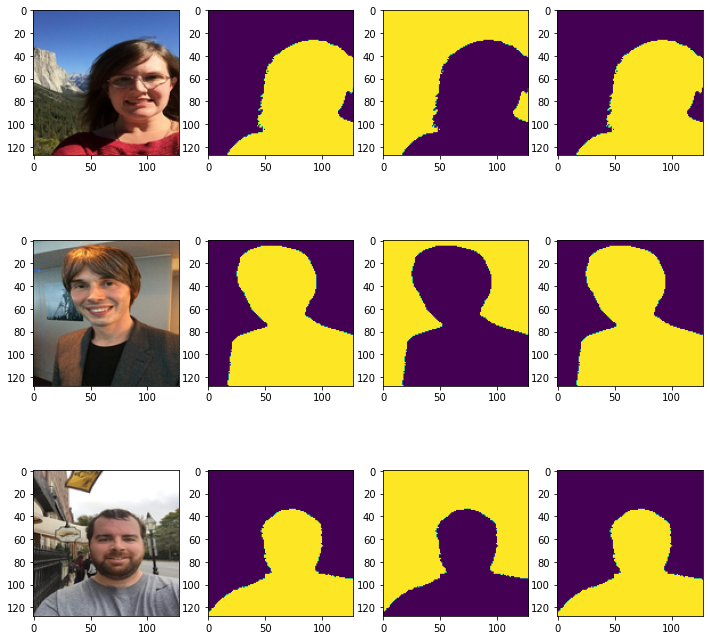

In [ ]:
fig,ax = plt.subplots(3,4,figsize=(12,12))

for idx1 in range(0,3):
    ax[idx1][0].imshow(images[idx1])
    ax[idx1][1].imshow(mask[idx1,:,:,0])
    ax[idx1][2].imshow(Y_t[idx1,:,:,0])
    ax[idx1][3].imshow(Y_t[idx1,:,:,1])

plt.show()

## FCN

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(images,Y_t, test_size=0.33, random_state=42)

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard
import tensorflow as tf
import datetime

# Clear any logs from previous runs
!rm -rf ./logs/

In [ ]:
def FCN8():
    VGG16 = tf.keras.applications.VGG16(weights="imagenet", include_top=False,input_tensor=tf.keras.Input(shape=(128, 128, 3)))
    VGG16.trainable  = False
    x = VGG16(VGG16.input)

    #Decoder
    o = tf.keras.layers.Conv2D( 4096 , ( 7 , 7 ) , activation='relu' , padding='same', name="conv6")(x)
    conv7 = tf.keras.layers.Conv2D( 4096 , ( 1 , 1 ) , activation='relu' , padding='same', name="conv7")(o)
    print(o.shape,conv7.shape)
    ## 4 times upsamping for pool4 layer
    conv7_4 = tf.keras.layers.Conv2DTranspose( 2 , kernel_size=(4,4) ,  strides=(4,4) , use_bias=False)(conv7)

    ## 2 times upsampling for pool411

    pool4 = VGG16.get_layer('block4_pool').output
    pool411 = tf.keras.layers.Conv2D( 2 , ( 1 , 1 ) , activation='relu' , padding='same', name="pool4_11")(pool4)
    pool411_2 = tf.keras.layers.Conv2DTranspose(2 , kernel_size=(2,2) ,  strides=(2,2) , use_bias=False)(pool411)

    pool3 = VGG16.get_layer('block3_pool').output
    pool311 = tf.keras.layers.Conv2D(2 , ( 1 , 1 ) , activation='relu' , padding='same', name="pool3_11")(pool3)
    o = tf.keras.layers.Add(name="add")([pool411_2, pool311])

    print(o.shape,conv7_4.shape)
    o = tf.keras.layers.Add(name="add1")([o, conv7_4 ])
    o = tf.keras.layers.Conv2DTranspose(2 , kernel_size=(8,8) ,  strides=(8,8) , use_bias=False)(o)
    o = tf.keras.layers.Activation('softmax')(o)

    model = tf.keras.Model(VGG16.input, o)

    return model



In [ ]:
fcn = FCN8()

fcn.summary()

58900480/58889256 [==============================] - 0s 0us/step
(None, 4, 4, 4096) (None, 4, 4, 4096)
(None, 16, 16, 2) (None, 16, 16, 2)
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 128, 128, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 128, 128, 64  3

In [ ]:
def dice_coefficient(y_true, y_pred, smooth=1):
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
    return  (2. * intersection + smooth) / (tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f) + smooth)

In [ ]:
fcn.compile(loss= 'categorical_crossentropy', optimizer="adam", metrics=["accuracy",dice_coefficient])

In [ ]:
#For tensorboard to store the performance metrics

# !rm -rf ./logs/

# log_dir = path+"/data/logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
# tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [ ]:
# trains the FCN-8 model

# hist = fcn.fit(X_train,y_train,batch_size = 32,epochs = 20,validation_data=(X_test, y_test),callbacks=[tensorboard_callback] )

In [ ]:
%tensorboard --logdir /content/gdrive/MyDrive/Segmentation/data/logs/fit

Reusing TensorBoard on port 6006 (pid 314), started 0:28:08 ago. (Use '!kill 314' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
fcn = tf.keras.models.load_model(path+'fcn.h5', custom_objects={'dice_coefficient':dice_coefficient})

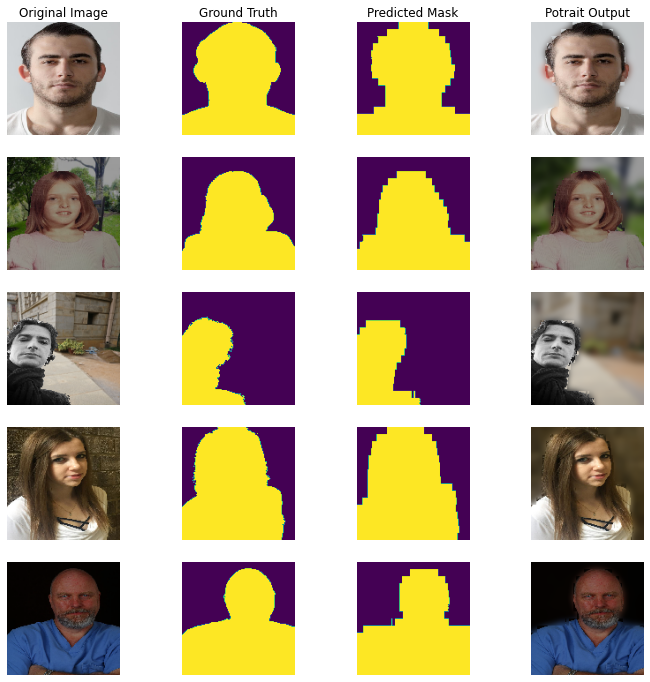

In [ ]:
preds = fcn.predict(X_test[:5])
preds = np.argmax(preds,axis=-1)
y_true = np.argmax(y_test[:5],axis=-1)

fig,ax = plt.subplots(5,4,figsize=(12,12))

for idx1 in range(0,5):
    if idx1==0:
            ax[idx1][0].set_title('Original Image')
            ax[idx1][1].set_title('Ground Truth')
            ax[idx1][2].set_title('Predicted Mask')
            ax[idx1][3].set_title('Potrait Output')

    ax[idx1][0].imshow(X_test[idx1])
    ax[idx1][1].imshow(y_true[idx1])
    ax[idx1][2].imshow(preds[idx1])

    blurred_img = cv2.GaussianBlur(X_test[idx1].copy(), (21, 21), 0)
    out = np.where(preds[idx1][:,:,None]==np.array([1]), X_test[idx1].copy(), blurred_img)

    ax[idx1][3].imshow(out)

    ax[idx1][0].axis('off')
    ax[idx1][1].axis('off')
    ax[idx1][2].axis('off')
    ax[idx1][3].axis('off')

plt.show()


## UNET

In [ ]:
def UNet():

    inputs = tf.keras.Input(shape=(128,128,3))
    conv1 = tf.keras.layers.Conv2D(64,3,padding='same',activation='relu')(inputs)
    conv1 = tf.keras.layers.Conv2D(64,3,padding='same',activation='relu')(inputs)
    maxp1 = tf.keras.layers.MaxPooling2D(2)(conv1)

    conv2 = tf.keras.layers.Conv2D(128,3,padding='same',activation='relu')(maxp1)
    conv2 = tf.keras.layers.Conv2D(128,3,padding='same',activation='relu')(conv2)
    maxp2 = tf.keras.layers.MaxPooling2D(2)(conv2)

    conv3 = tf.keras.layers.Conv2D(256,3,padding='same',activation='relu')(maxp2)
    conv3 = tf.keras.layers.Conv2D(256,3,padding='same',activation='relu')(conv3)
    maxp3 = tf.keras.layers.MaxPooling2D(2)(conv3)

    conv4 = tf.keras.layers.Conv2D(512,3,padding='same',activation='relu')(maxp3)
    conv4 = tf.keras.layers.Conv2D(512,3,padding='same',activation='relu')(conv4)
    maxp4 = tf.keras.layers.MaxPooling2D(2)(conv4)

    conv5 = tf.keras.layers.Conv2D(1024,3,padding='same',activation='relu')(maxp4)
    conv5 = tf.keras.layers.Conv2D(1024,3,padding='same',activation='relu')(conv5)

    conv_up1 = tf.keras.layers.UpSampling2D()(conv5)
    conv_up1 = tf.keras.layers.Conv2D(512,3,padding='same',activation='relu')(conv_up1)
    conv_up1 = tf.keras.layers.Concatenate()([conv_up1,conv4])
    conv_up1 = tf.keras.layers.Conv2D(512,3,padding='same',activation='relu')(conv_up1)

    conv_up2 = tf.keras.layers.UpSampling2D()(conv_up1)
    conv_up2 = tf.keras.layers.Conv2D(256,3,padding='same',activation='relu')(conv_up2)
    conv_up2 = tf.keras.layers.Concatenate()([conv_up2,conv3])
    conv_up2 = tf.keras.layers.Conv2D(256,3,padding='same',activation='relu')(conv_up2)

    conv_up3 = tf.keras.layers.UpSampling2D()(conv_up2)
    conv_up3 = tf.keras.layers.Conv2D(128,3,padding='same',activation='relu')(conv_up3)
    conv_up3 = tf.keras.layers.Concatenate()([conv_up3,conv2])
    conv_up3 = tf.keras.layers.Conv2D(128,3,padding='same',activation='relu')(conv_up3)


    conv_up4 = tf.keras.layers.UpSampling2D()(conv_up3)
    conv_up4 = tf.keras.layers.Conv2D(64,3,padding='same',activation='relu')(conv_up4)
    conv_up4 = tf.keras.layers.Concatenate()([conv_up4,conv1])
    conv_up4 = tf.keras.layers.Conv2D(64,3,padding='same',activation='relu')(conv_up4)
    conv_up4 = tf.keras.layers.Conv2D(2,3,padding='same',activation='softmax')(conv_up4)

    return tf.keras.Model(inputs,conv_up4)

In [ ]:
unet = UNet()
unet.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_1 (Conv2D)              (None, 128, 128, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 max_pooling2d (MaxPooling2D)   (None, 64, 64, 64)   0           ['conv2d_1[0][0]']               
                                                                                              

In [ ]:
# TensorBoard callback to store performance metrics of the model while training

# log_dir = path+"logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
# tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)


In [ ]:
unet.compile(loss= 'categorical_crossentropy', optimizer="adam", metrics=["accuracy",dice_coefficient])

In [ ]:
# trains the UNet model

# hist = unet.fit(X_train,y_train,batch_size = 32,epochs = 20,validation_data=(X_test, y_test),callbacks=[tensorboard_callback] )

In [ ]:
%tensorboard --logdir /content/gdrive/MyDrive/Segmentation/logs/fit

Reusing TensorBoard on port 6007 (pid 409), started 0:23:23 ago. (Use '!kill 409' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
unet = tf.keras.models.load_model(path+'unet.h5', custom_objects={'dice_coefficient':dice_coefficient})

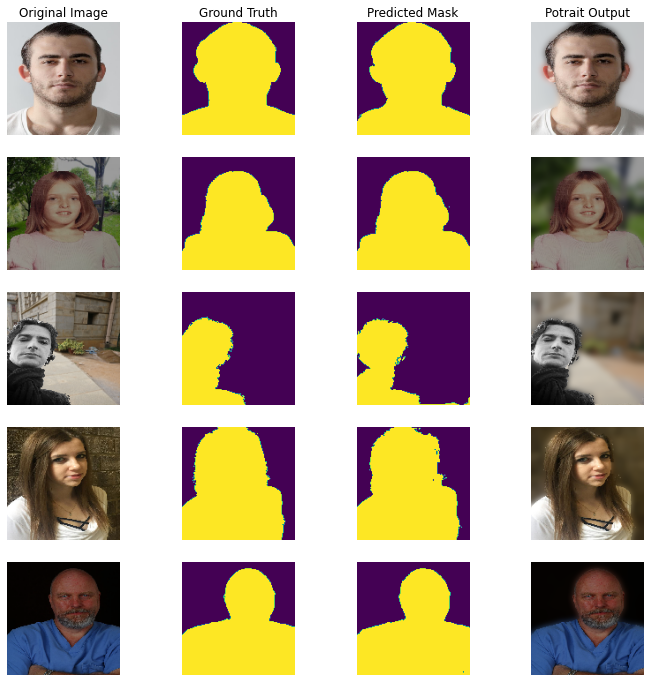

In [ ]:
preds = unet.predict(X_test[:5])
preds = np.argmax(preds,axis=-1)
y_true = np.argmax(y_test[:5],axis=-1)

fig,ax = plt.subplots(5,4,figsize=(12,12))

for idx1 in range(0,5):
    if idx1==0:
        ax[idx1][0].set_title('Original Image')
        ax[idx1][1].set_title('Ground Truth')
        ax[idx1][2].set_title('Predicted Mask')
        ax[idx1][3].set_title('Potrait Output')

    ax[idx1][0].imshow(X_test[idx1])
    ax[idx1][1].imshow(y_true[idx1])
    ax[idx1][2].imshow(preds[idx1])

    blurred_img = cv2.GaussianBlur(X_test[idx1].copy(), (21, 21), 0)
    out = np.where(preds[idx1][:,:,None]==np.array([1]), X_test[idx1].copy(), blurred_img)

    ax[idx1][3].imshow(out)

    ax[idx1][0].axis('off')
    ax[idx1][1].axis('off')
    ax[idx1][2].axis('off')
    ax[idx1][3].axis('off')
plt.show()


To use pretrained unet: https://github.com/qubvel/segmentation_models

# L10: Siamese Network

## Problem Statement
- You are working as Data scientist in HDFC bank.
  - You have a new account holder in your bank and would like to set his signature for verification.
- You have only one sample signature from the member.
- Being a DataScientist , How can you use a neural network to perform the signature verification?

<center><img src = 'https://drive.google.com/uc?id=1wcp9rW4zygc8UYb6KgGz_jGT7oYt7Cf1' height=300 width=400>

In [ ]:
# Installing Cudnn
!apt-cache policy libcudnn8

# Install latest version
!apt install --allow-change-held-packages libcudnn8=8.4.1.50-1+cuda11.6

# Export env variables
!export PATH=/usr/local/cuda-11.4/bin${PATH:+:${PATH}}
!export LD_LIBRARY_PATH=/usr/local/cuda-11.4/lib64:$LD_LIBRARY_PATH
!export LD_LIBRARY_PATH=/usr/local/cuda-11.4/include:$LD_LIBRARY_PATH
!export LD_LIBRARY_PATH=$LD_LIBRARY_PATH:/usr/local/cuda/extras/CUPTI/lib64

# Install tensorflow
!pip install tflite-model-maker==0.4.0
!pip uninstall -y tensorflow && pip install -q tensorflow==2.8.0
!pip install pycocotools==2.0.4
!pip install opencv-python-headless==4.6.0.66
!pip install tensorflow-io==0.25.0
!pip install tensorflow-addons

libcudnn8:
  Installed: 8.9.6.50-1+cuda11.8
  Candidate: 8.9.6.50-1+cuda12.2
  Version table:
     8.9.6.50-1+cuda12.2 600
        600 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages
 *** 8.9.6.50-1+cuda11.8 600
        600 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages
        100 /var/lib/dpkg/status
     8.9.5.30-1+cuda12.2 600
        600 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages
     8.9.5.30-1+cuda11.8 600
        600 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages
     8.9.5.29-1+cuda12.2 600
        600 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages
     8.9.5.29-1+cuda11.8 600
        600 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages
     8.9.4.25-1+cuda12.2 600
        600 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  

### Importing Libraries

In [ ]:
import sys
import numpy as np
import pickle
import os
import matplotlib.pyplot as plt
import pandas as pd
%matplotlib inline

import cv2 as cv
import time
import itertools
import random


import tensorflow as tf
import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam, RMSprop
from tensorflow.keras.layers import Conv2D, ZeroPadding2D, Activation, Input, concatenate, Dropout
from tensorflow.keras.models import Model

from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Concatenate
from tensorflow.keras.layers import Lambda, Flatten, Dense
from tensorflow.keras.initializers import glorot_uniform
import tensorflow_io as tfio
from tensorflow.keras.applications import resnet
from tensorflow.keras import layers
from tensorflow.keras.utils import plot_model
from google.colab.patches import cv2_imshow
import matplotlib.image as mpimg
from tensorflow.keras import applications
from tensorflow.keras import metrics


from tensorflow.keras.regularizers import l2
from tensorflow.keras import backend as K
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
import datetime
import warnings
import matplotlib.image as mpimg
from functools import reduce
warnings.filterwarnings('ignore')


## Download Dataset:

- First install **gdown** using pip command(skip in colab-preinstalled)

    - **gdown** is used to download files from Google drive

In [ ]:
!pip install gdown

- Now downloading the Dataset using gdown and file id

In [ ]:
!gdown --id 0B29vNACcjvzVc1RfVkg5dUh2b1E

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=0B29vNACcjvzVc1RfVkg5dUh2b1E
To: /content/BHSig260.zip
100% 48.5M/48.5M [00:00<00:00, 113MB/s]


### About the Dataset:

- The dataset consists of 2 directories Hindi and Bengali Signatures.
- The Hindi directory consists of 160 sub-directories which are the signatures of 160 people
- The Bengali directory consists of 100 sub-directories which are the signatures of 100 people.
- Each person has 24 genuine Signatures followerd by  30 forged signatures.

Creating a directory to store the data

In [ ]:
!mkdir signatures

Un-zipping the data and saving in the directory

In [ ]:
! unzip BHSig260.zip -d signatures

Streaming output truncated to the last 5000 lines.
  inflating: signatures/BHSig260/Bengali/091/B-S-91-G-20.tif  
  inflating: signatures/BHSig260/Bengali/091/B-S-91-G-19.tif  
  inflating: signatures/BHSig260/Bengali/091/B-S-91-G-18.tif  
  inflating: signatures/BHSig260/Bengali/091/B-S-91-G-17.tif  
  inflating: signatures/BHSig260/Bengali/091/B-S-91-G-16.tif  
  inflating: signatures/BHSig260/Bengali/091/B-S-91-G-15.tif  
  inflating: signatures/BHSig260/Bengali/091/B-S-91-G-14.tif  
  inflating: signatures/BHSig260/Bengali/091/B-S-91-G-13.tif  
  inflating: signatures/BHSig260/Bengali/091/B-S-91-G-12.tif  
  inflating: signatures/BHSig260/Bengali/091/B-S-91-G-11.tif  
  inflating: signatures/BHSig260/Bengali/091/B-S-91-G-10.tif  
  inflating: signatures/BHSig260/Bengali/091/B-S-91-G-09.tif  
  inflating: signatures/BHSig260/Bengali/091/B-S-91-G-08.tif  
  inflating: signatures/BHSig260/Bengali/091/B-S-91-G-07.tif  
  inflating: signatures/BHSig260/Bengali/091/B-S-91-G-06.tif  
  in

For this task, we are using only the Hindi Signatures

In [ ]:
path = "./signatures/BHSig260/Hindi/"

Get the list of all directories and sort them

In [ ]:
dir_list = next(os.walk(path))[1]
dir_list.sort()

In [ ]:
dir_list

['001',
 '002',
 '003',
 '004',
 '005',
 '006',
 '007',
 '008',
 '009',
 '010',
 '011',
 '012',
 '013',
 '014',
 '015',
 '016',
 '017',
 '018',
 '019',
 '020',
 '021',
 '022',
 '023',
 '024',
 '025',
 '026',
 '027',
 '028',
 '029',
 '030',
 '031',
 '032',
 '033',
 '034',
 '035',
 '036',
 '037',
 '038',
 '039',
 '040',
 '041',
 '042',
 '043',
 '044',
 '045',
 '046',
 '047',
 '048',
 '049',
 '050',
 '051',
 '052',
 '053',
 '054',
 '055',
 '056',
 '057',
 '058',
 '059',
 '060',
 '061',
 '062',
 '063',
 '064',
 '065',
 '066',
 '067',
 '068',
 '069',
 '070',
 '071',
 '072',
 '073',
 '074',
 '075',
 '076',
 '077',
 '078',
 '079',
 '080',
 '081',
 '082',
 '083',
 '084',
 '085',
 '086',
 '087',
 '088',
 '089',
 '090',
 '091',
 '092',
 '093',
 '094',
 '095',
 '096',
 '097',
 '098',
 '099',
 '100',
 '101',
 '102',
 '103',
 '104',
 '105',
 '106',
 '107',
 '108',
 '109',
 '110',
 '111',
 '112',
 '113',
 '114',
 '115',
 '116',
 '117',
 '118',
 '119',
 '120',
 '121',
 '122',
 '123',
 '124',
 '125',


For each person segregate the genuine signatures from the forged signatures
Genuine signatures are stored in the list **orig_groups**
Forged signatures are stored in the list **forged_groups**

---
Here, First 30 signatures in each folder are **forged**
Next 24 signatures are **genuine**




In [ ]:
orig_groups, forg_groups = [], []
for directory in dir_list:
    images = os.listdir(path+directory)
    images.sort()
    images = [path+directory+'/'+x for x in images]
    forg_groups.append(images[:30])
    orig_groups.append(images[30:])

In [ ]:
len(orig_groups[0]),len(forg_groups[0])

(24, 30)

Lets quickly check to confirm we have data of all the 160 individuals

In [ ]:
len(orig_groups), len(forg_groups)

(160, 160)

In [ ]:
orig_lengths = [len(x) for x in orig_groups]
forg_lengths = [len(x) for x in forg_groups]

Quick check to confirm that there are 24 Genuine signatures for each individual

In [ ]:
print(orig_lengths)

[24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24]


In [ ]:
print(forg_lengths)

[30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30, 30]


To train a model for Signature verification, we need a **input image** and a **validation image** to check whether the validation image is a forgery or not.

In our Dataset, we have a file a **Hindi_pairs.txt**. It consists of image pairs and their respective label.

For example,

- **001/H-S-1-G-01.tif** is Genuine signature of a person
- **001/H-S-1-F-01.tif** is Forgery signature of the same person

So the label of this pair will be 0
- If both the images are Genuine signature of the person, then the label will be 1


Now let's use this dataset and visualize the pairs for better understanding

In [ ]:
pairs = pd.read_csv(path+"Hindi_pairs.txt",delimiter=" ",header=None)

In [ ]:
pairs.head()

,0,1,2
0,001/H-S-1-G-01.tif,001/H-S-1-F-01.tif,0
1,001/H-S-1-G-02.tif,001/H-S-1-F-01.tif,0
2,001/H-S-1-G-03.tif,001/H-S-1-F-01.tif,0
3,001/H-S-1-G-04.tif,001/H-S-1-F-01.tif,0
4,001/H-S-1-G-05.tif,001/H-S-1-F-01.tif,0


In [ ]:
pairs.shape

(8964, 3)

In [ ]:
inp_imgs = []
val_imgs = []
labels = []

In [ ]:
for idx,row in pairs.iterrows():
  inp = row[0]
  val = row[1]
  label = row[2]
  inp_imgs.append(path+inp)
  val_imgs.append(path+val)
  labels.append(label)

In [ ]:
len(inp_imgs),len(val_imgs),len(labels)

(8964, 8964, 8964)

All the images will be converted to the same size before processing

In [ ]:
img_h, img_w = 180,180

### Let's Visualize the Original and Forged Signature of a person

Function to randomly select a signature from train set and print two genuine copies and one forged copy

In [ ]:
def visualize_sample_signature():

    # Randomly selecting original and forged images
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (20, 20))
    k = np.random.randint(len(pairs))
    inp = inp_imgs[k]
    val = val_imgs[k]

    # Reading the image
    inp_img = mpimg.imread(inp)
    val_img  = mpimg.imread(val)

    # Displaying the image
    ax1.imshow(inp_img,cmap='gray')
    ax2.imshow(val_img,cmap='gray')

    ax1.set_title('Input Image')
    ax2.set_title('Validation Image')
    print("Label: {}".format(labels[k]))

Label: 1


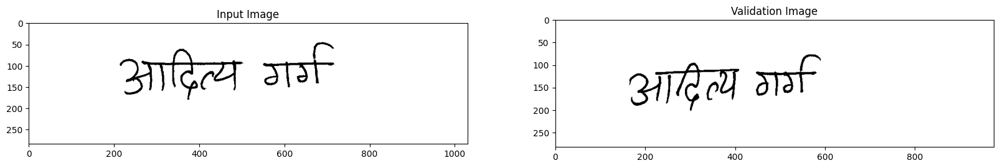

In [ ]:
visualize_sample_signature()

###Preparing data
Siamese Network has two identical sub-networks, one for the **input image** and other for the **validation image**.

For contrastive loss functions, the dataset should be in the form
- (anchor_image,positive_image,1)
- (anchor_image,negative_image,0)

> Since anchor image and positive image are same, it is similar. So the label is 1

> Anchor image and negative image are dis-similar. So the label is 0


In [ ]:
pairs_data = tf.data.Dataset.from_tensor_slices((inp_imgs,val_imgs))
pairs_labels = tf.data.Dataset.from_tensor_slices(labels)
data = tf.data.Dataset.zip((pairs_data,pairs_labels))

In [ ]:
data

<ZipDataset element_spec=((TensorSpec(shape=(), dtype=tf.string, name=None), TensorSpec(shape=(), dtype=tf.string, name=None)), TensorSpec(shape=(), dtype=tf.int32, name=None))>

###Preprocessing the data
Let's start preprocessing the Dataset required for **contrastive loss**.

In [ ]:
def preprocess_image(filename):

    image_string = tf.io.read_file(filename)
    # Decodes a .tiff encoded image tensor of RGBA format (Output shape-[height,width,4])
    image = tfio.experimental.image.decode_tiff(image_string)
    # Selecting only the 3 channels of the image - RGB
    r, g, b = image[:, :, 0], image[:, :, 1], image[:, :, 2]
    # Combines multiple tensors
    image = tf.stack([r,g,b],axis=-1)
    # Resizing the image
    image = tf.image.resize(image, (180,180))
    return image

In [ ]:
preprocess_image('./signatures/BHSig260/Hindi/001/H-S-1-G-01.tif').shape

TensorShape([180, 180, 3])

**preprocess_image()**

- Reads Image
- Converts .tiff to tensor
- resizes the image to size (180,180)

**preprocess_twin**
- Returns **(input_image,validation_image,label)**


Function to preprocess image and return the tuple consisting of

(input_image,validation_image,label)

In [ ]:
# We will use the same preprocess_image() function to preprocess the image
def preprocess_twin(img_pair,label):
  input_img = img_pair[0]
  validation_img = img_pair[1]
  return {
      'input_img':preprocess_image(input_img),
      'validation_img':preprocess_image(validation_img)
    }, label

In [ ]:
example = data.as_numpy_iterator().next()

In [ ]:
len(example)

2

In [ ]:
example[0][0]

b'./signatures/BHSig260/Hindi/001/H-S-1-G-01.tif'

Installing tensorflow_io for decoding .tiff images using tensorflow

- **.shuffle()** - shuffles the samples in the dataset.

- **.map()** - transforms items in the dataset

In [ ]:
data = data.map(preprocess_twin)
data = data.cache()
data = data.shuffle(buffer_size=len(data))

#### Training and Testing Partition of data

In [ ]:
# Training Partition
train_data = data.take(round(len(data)*0.8))
train_data = train_data.batch(4)
train_data = train_data.prefetch(2)

In [ ]:
val_data = data.skip(round(len(data)*0.8))
val_data = val_data.take(round(len(data)*0.15))
val_data = val_data.batch(4)
val_data = val_data.prefetch(2)

In [ ]:
# Testing partition
test_data = data.skip(round(len(data)*0.95))
test_data = test_data.take(round(len(data)*0.5))
test_data = test_data.batch(4)
test_data = test_data.prefetch(2)

In [ ]:
len(train_data),len(val_data),len(test_data)

(1793, 337, 112)

## Siamese Network

###What should be the base CNN network?
- You can create Convolutions network from scratch extract features embeddings from the image.

- we can take the advantage of **pretrained models**

- Pretrained-models(Transfer learning) - You can also use pre-trained models like VGG16, Resnet50 to extract the feature embeddings.

- We will use the  pre-trained model **Resnet50** to train the embeddings to identify similar and dissimilar signatures
- ResNet-50 is a CNN that is 50 layers deep. It has been trained on millions of images from imagenet database and handles vanishing gradient problem in very deep CNNs.

In [ ]:
input_dim = (180,180,3)

In [ ]:
img1=Input(180,180,3)
img2=Input(180,180,3)
e1=cnn()(img1)
e2=cnn()(img2)

model=Model(inputs=[img1.img2],outputs=[e1,e2])


In [ ]:
base_cnn = resnet.ResNet50(
    weights="imagenet", input_shape=input_dim, include_top=False
)

base_cnn.trainable=False

glob_pool = layers.GlobalAveragePooling2D()(base_cnn.output)
dense1 = layers.Dense(128)(glob_pool)
output = layers.Dense(128)(dense1)

embedding = Model(base_cnn.input, output, name="Embedding")

# trainable = False
# for layer in base_cnn.layers:
#     if layer.name == "conv5_block1_out":
#         trainable = True
#     layer.trainable = trainable

94781440/94765736 [==============================] - 1s 0us/step


## How to compare the embeddings?:

- For that we will distance metric called 'Euclidean distance' to find how similar the two signatures are.

- But you can also use Cosine similarity

Function to Calculate Euclidean distance to calculate similariity between the input image and the validation image:



In [ ]:
def euclidean_distance(vects):
    # Compute Euclidean Distance between two vectors
    x, y = vects
    return K.sqrt(K.sum(K.square(x - y), axis=1, keepdims=True))

## Building the Siamese Model

In [ ]:
# Building Model for feature extraction

# Shape of the Input
img_a = Input(shape=input_dim,name='input_img')
img_b = Input(shape=input_dim,name='validation_img')


# Extracting embeddings of the image
feat_vecs_a = embedding(img_a)
feat_vecs_b = embedding(img_b)

# Calculating euclidean distance between the images
distance = Lambda(euclidean_distance)([feat_vecs_a, feat_vecs_b])
model = Model([img_a, img_b],distance)
model.summary()


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_img (InputLayer)         [(None, 180, 180, 3  0           []                               
                                )]                                                                
                                                                                                  
 validation_img (InputLayer)    [(None, 180, 180, 3  0           []                               
                                )]                                                                
                                                                                                  
 Embedding (Functional)         (None, 128)          23866496    ['input_img[0][0]',              
                                                                  'validation_img[0][0]']     

Plotting the architecture of the siamese model

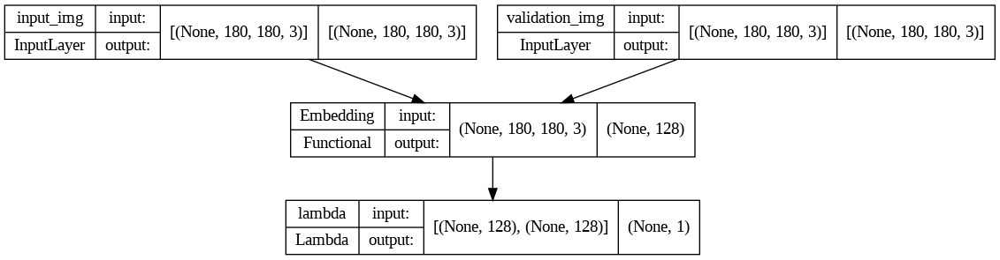

In [ ]:
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

## Contrastive Loss and model performance

In [ ]:
def contrastive_loss(y, preds, margin=1):

	y = tf.cast(y, preds.dtype)
	squaredPreds = K.square(preds)
	squaredMargin = K.square(K.maximum(margin - preds, 0))
	loss = K.mean(y * squaredPreds + (1 - y) * squaredMargin)
	return loss

Training the model with **Adam** optimizer and **contrastive** loss

In [ ]:
model.compile(loss=contrastive_loss, optimizer='adam')

In [ ]:
!mkdir Weights_binary

In [ ]:
callbacks = [
    ModelCheckpoint('./Weights_binary/signet-bhsig260-{epoch:03d}.h5', verbose=1, save_weights_only=True)
]

In [ ]:
results = model.fit(train_data,
                              steps_per_epoch = 50,
                              epochs = 20,
                              validation_data = val_data,
                              validation_steps = 50,
                              callbacks=callbacks
)

Epoch 1/20
50/50 [==============================] - ETA: 0s - loss: 1.4194
Epoch 1: saving model to ./Weights_binary/signet-bhsig260-001.h5
50/50 [==============================] - 161s 137ms/step - loss: 1.4194 - val_loss: 1.0187
Epoch 2/20
49/50 [============================>.] - ETA: 0s - loss: 1.1471
Epoch 2: saving model to ./Weights_binary/signet-bhsig260-002.h5
50/50 [==============================] - 4s 91ms/step - loss: 1.1448 - val_loss: 1.1223
Epoch 3/20
49/50 [============================>.] - ETA: 0s - loss: 0.7900
Epoch 3: saving model to ./Weights_binary/signet-bhsig260-003.h5
50/50 [==============================] - 3s 70ms/step - loss: 0.7871 - val_loss: 0.6120
Epoch 4/20
49/50 [============================>.] - ETA: 0s - loss: 0.7448
Epoch 4: saving model to ./Weights_binary/signet-bhsig260-004.h5
50/50 [==============================] - 5s 97ms/step - loss: 0.7353 - val_loss: 0.6473
Epoch 5/20
49/50 [============================>.] - ETA: 0s - loss: 1.1338
Epoch 5: s

In [ ]:
# Downloading Best Model Weights
!gdown 1uuE37aN36fnp5s-7iSLShQSJw9sT_1Vs

Downloading...
From: https://drive.google.com/uc?id=1uuE37aN36fnp5s-7iSLShQSJw9sT_1Vs
To: /content/signet-bhsig260-020.h5
100% 95.7M/95.7M [00:01<00:00, 62.6MB/s]


In [ ]:
model.load_weights("/content/signet-bhsig260-020.h5")

Now, Let's compute the best threshold where the accuracy is maximum.

> **Accuracy = (tp + tn) / (tp + tn + fp + fn)**

- **TP** stands for True Positive, which is a case where the model correctly predicts a positive class when the true class is positive.

- **TN** stands for True Negative, which is a case where the model correctly predicts a negative class when the true class is negative.

- **FP** stands for False Positive, which is a case where the model incorrectly predicts a positive class when the true class is negative.

- **FN** stands for False Negative, which is a case where the model incorrectly predicts a negative class when the true class is positive.

> In other words, TP and TN represent correct predictions, while FP and FN represent incorrect predictions.

In [ ]:
# Finding out at which threshold, the accuracy is maximum
def compute_accuracy_thresh(predictions, labels):

    dmax = np.max(predictions)
    dmin = np.min(predictions)
    nsame = np.sum(labels == 1)
    ndiff = np.sum(labels == 0)

    step = 0.01
    max_acc = 0
    best_thresh = -1
    best_labels = None

    for d in np.arange(dmin, dmax+step, step):
        best_labels = (predictions <= d).astype(int)

    # Calculate tp, tn, fp, fn using best_labels and ground truth labels
        tp = np.sum((best_labels == 1) & (labels == 1))
        tn = np.sum((best_labels == 0) & (labels == 0))
        fp = np.sum((best_labels == 1) & (labels == 0))
        fn = np.sum((best_labels == 0) & (labels == 1))
        accuracy = (tp + tn) / (tp + tn + fp + fn)

        if accuracy > max_acc:
          max_acc = accuracy
          best_thresh = d

    return max_acc, best_thresh

In [ ]:
# Train predictions
pred_train = []

# Train y
tr_y_train = []

In [ ]:
for i in range(len(train_data)):
    img_pair, label = train_data.as_numpy_iterator().next()
    tr_y_train.append(label.reshape(-1,1))
    pred_train.append(model.predict([img_pair]))

In [ ]:
pred_train[99]

array([[1.3527336],
       [1.3368633],
       [2.0049372],
       [1.1511508]], dtype=float32)

In [ ]:
tr_y_train[99]

array([[0],
       [0],
       [0],
       [0]], dtype=int32)

In [ ]:
# Train accuracy, threshold
tr_acc, threshold = compute_accuracy_thresh(np.array(pred_train),np.array(tr_y_train))
tr_acc, threshold

(0.9255437813720022, 0.7347928345203405)

In [ ]:
# Test predictions
pred_test = []

# Test y
tr_y_test = []

In [ ]:
for i in range(len(test_data)):
    img_pair, label = test_data.as_numpy_iterator().next()
    tr_y_test.append(label.reshape(-1,1))
    pred_test.append(model.predict([img_pair])[0][0])

Now, we will compute the test accuracy using the train threshold

In [ ]:
# Computing Test Accuracy with the train threshold
def compute_accuracy_thresh_test(predictions, labels,d):

    best_labels = (predictions <= threshold).astype(int)
    tp = np.sum((best_labels == 1) & (labels == 1))
    tn = np.sum((best_labels == 0) & (labels == 0))
    fp = np.sum((best_labels == 1) & (labels == 0))
    fn = np.sum((best_labels == 0) & (labels == 1))
    accuracy = (tp + tn) / (tp + tn + fp + fn)

    return accuracy

In [ ]:
# Test Accuracy
test_acc= compute_accuracy_thresh_test(np.array(pred_test), np.array(tr_y_test),threshold)
test_acc

0.6186224489795918

### Prediction on Test image pairs

In [ ]:
def predict_score():
    '''Predict distance score and classify test images as Genuine or Forged'''
    test_point, test_label = test_data.as_numpy_iterator().next()
    img1, img2 = test_point['input_img'][0],test_point['validation_img'][0]

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (10, 10))
    ax1.imshow(img1.astype('uint8'), cmap='gray')
    ax2.imshow(img2.astype('uint8'), cmap='gray')

    ax1.set_title('Genuine')
    if test_label[0] == 1:
        ax2.set_title('Genuine')
    else:
        ax2.set_title('Forged')
    ax1.axis('off')
    ax2.axis('off')
    plt.show()
    result = model.predict([test_point])
    diff = result[0][0]
    print("Difference Score = ", diff)
    if diff > threshold:
        print("Its a Forged Signature")
    else:
        print("Its a Genuine Signature")

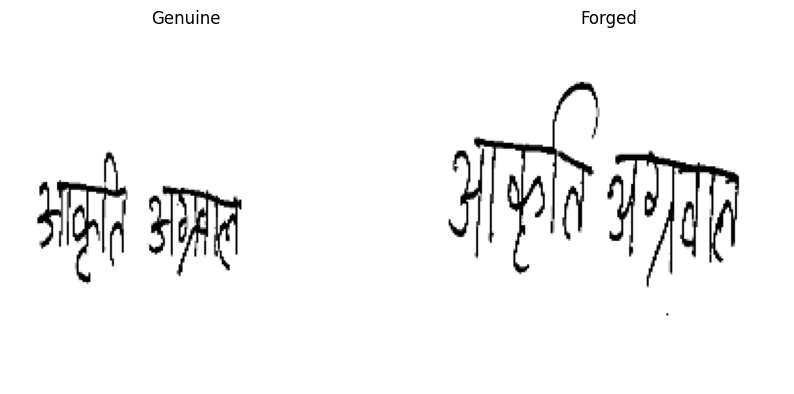

Difference Score =  2.386475
Its a Forged Signature


In [ ]:
predict_score()

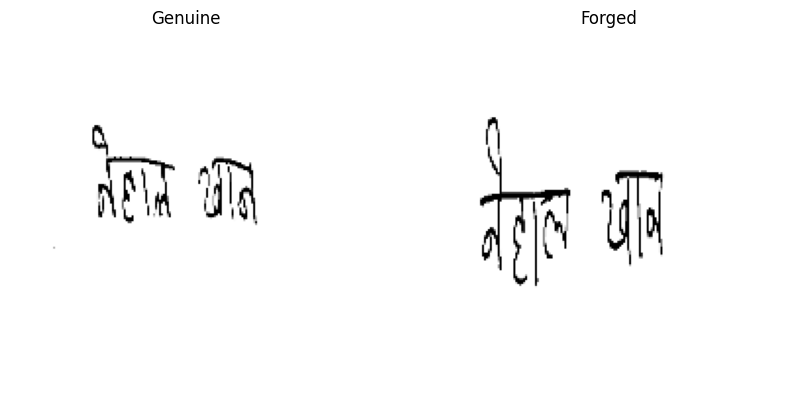

Difference Score =  1.0656228
Its a Forged Signature


In [ ]:
predict_score()

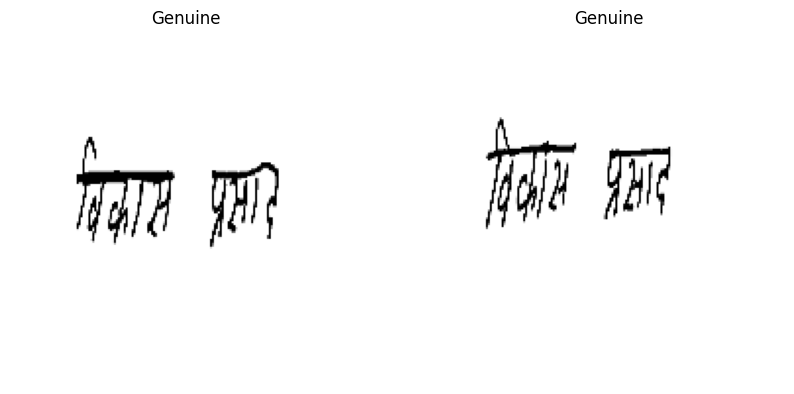

Difference Score =  0.6129655
Its a Genuine Signature


In [ ]:
predict_score()

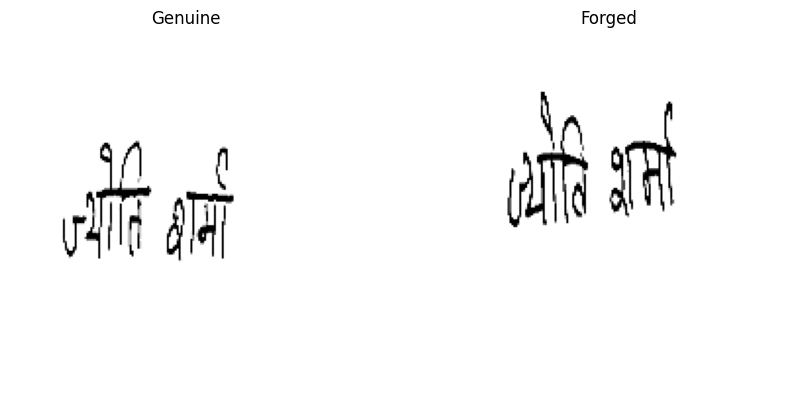

Difference Score =  1.0811273
Its a Forged Signature


In [ ]:
predict_score()

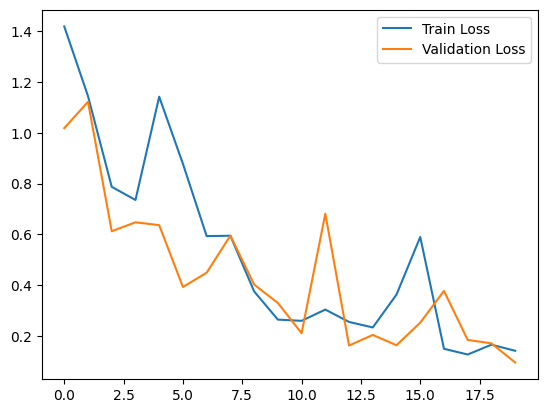

In [ ]:
# Train loss vs validation loss
plt.plot(results.history['loss'],label='Train Loss')
plt.plot(results.history['val_loss'],label='Validation Loss')
plt.legend()
plt.show()

**Train Accuracy**: 92%

**Test Accuracy**: 63%

**Threshold**: 0.73


> As we discussed above, Contrastive loss requires 2 inputs, **(anchor, positive)** or **(anchor, negative)**.


## Triplet Loss

In [ ]:
def triplet_loss(x):
    # Initialize alpha value
    alpha = 0.5
    # Getting anchor, positive and negative embeddings
    anchor, positive, negative = x
    # Calculating distance between anchor and positive
    positive_distance = K.mean(K.square(anchor - positive),axis=-1)
    # Calculating distance between anchor and negative
    negative_distance = K.mean(K.square(anchor - negative),axis=-1)
    # Implement the formula
    return K.mean(K.maximum(0.0, positive_distance - negative_distance + alpha))

- In triplet loss, we need images in the form of triplets (anchor,positive,negative) where anchor and postive are similar and negative is different.
- We will build a **tf.data()** pipeline to build the dataset required for triplet loss

- Now we know that triplet loss requires **anchor**,**positive** and **negative**, lets prepare the dataset

In [ ]:
# Collecting Anchor, positive and negative images
anchor_images = []
positive_images = []
negative_images = []

In [ ]:
# Consists of all forgery images
forg_groups_all = reduce(lambda x,y:x+y,forg_groups)

- We will use a simple loop to prepare the dataset

- **orig_groups** contains signatures for 160 persons, each person with 24 signatures.

- We know that anchor and positive should be similar, but with the same person.

- We will use **orig_groups** for anchor and positive images.

- **forg_groups** contains forgery signatures for all 160 persons.

- Since negative image should be different from **anchor** and **positive**. We will randomly pick a image from **forg_groups** and it will be negative for the triplet.

In [ ]:
def get_triplets():
  for i in range(len(orig_groups)):
    orig_gp = orig_groups[i]
    forg_gp = forg_groups[i]
    for j in range(len(orig_gp)):
      for k in range(j+1,len(orig_gp)):
        anchor = orig_gp[j]
        positive = orig_gp[k]
        negative = forg_groups_all[np.random.randint(len(forg_groups_all))]
        anchor_images.append(anchor)
        positive_images.append(positive)
        negative_images.append(negative)


In [ ]:
get_triplets()

In [ ]:
len(anchor_images),len(positive_images),len(negative_images)

(44160, 44160, 44160)

As you can see below, the positive and anchor image are same but the negative image is different. That's what we want

> **Note**: Anchor and positive are genuine signatures of the same person, but not same images

In [ ]:
print(anchor_images[0])
print(positive_images[0])
print(negative_images[0])

./signatures/BHSig260/Hindi/001/H-S-1-G-01.tif
./signatures/BHSig260/Hindi/001/H-S-1-G-02.tif
./signatures/BHSig260/Hindi/108/H-S-108-F-20.tif


Displaying a sample of anchor, positive and negative image

In [ ]:
k = np.random.randint(len(anchor_images))
a = anchor_images[k]
p = positive_images[k]
n = negative_images[k]
img1 = mpimg.imread(a)
img2 = mpimg.imread(p)
img3 = mpimg.imread(n)

Anchor Image

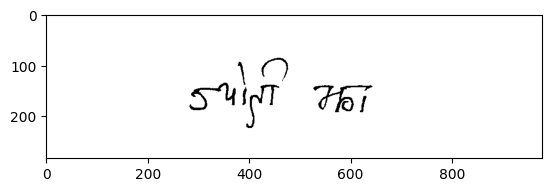

In [ ]:
plt.imshow(img1)

Positive Image

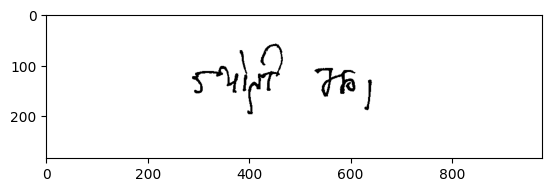

In [ ]:
plt.imshow(img2)

Negative Image

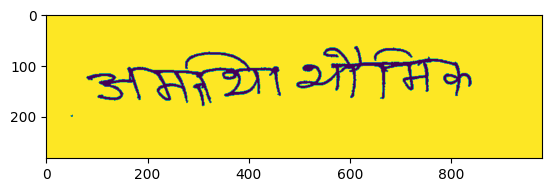

In [ ]:
plt.imshow(img3)

**tf.data.Dataset.zip()** is used for creating dataset by zipping together multiple arrays and tf objects.

In [ ]:
len(anchor_images)

44160

In [ ]:
anchor_dataset = tf.data.Dataset.from_tensor_slices(anchor_images[:20000])
positive_dataset = tf.data.Dataset.from_tensor_slices(positive_images[:20000])
negative_dataset = tf.data.Dataset.from_tensor_slices(negative_images[:20000])

In [ ]:
dataset = tf.data.Dataset.zip((anchor_dataset,positive_dataset,negative_dataset))

In [ ]:
dataset

<ZipDataset element_spec=(TensorSpec(shape=(), dtype=tf.string, name=None), TensorSpec(shape=(), dtype=tf.string, name=None), TensorSpec(shape=(), dtype=tf.string, name=None))>

In [ ]:
dataset.as_numpy_iterator().next()

(b'./signatures/BHSig260/Hindi/001/H-S-1-G-01.tif',
 b'./signatures/BHSig260/Hindi/001/H-S-1-G-02.tif',
 b'./signatures/BHSig260/Hindi/108/H-S-108-F-20.tif')

**preprocess_image()** - Load the specified file as a JPEG image, preprocess it and resize it to the target shape.

**preprocess_triplets** - Preprocess the image and return as a triplet

In [ ]:
def preprocess_triplets(anchor,positive,negative):
  return [
      preprocess_image(anchor),
      preprocess_image(positive),
      preprocess_image(negative),
  ]

Sample triplet of anchor,positve,negative

In [ ]:
sample = dataset.as_numpy_iterator().next()

In [ ]:
sample

(b'./signatures/BHSig260/Hindi/001/H-S-1-G-01.tif',
 b'./signatures/BHSig260/Hindi/001/H-S-1-G-02.tif',
 b'./signatures/BHSig260/Hindi/108/H-S-108-F-20.tif')

- **.shuffle()** - shuffles the samples in the dataset.

- **.map()** - transforms items in the dataset

In [ ]:
dataset = dataset.shuffle(buffer_size=len(dataset))
dataset = dataset.map(preprocess_triplets)

Taking 80% of dataset as training, 10% for validation, 10% for testing

In [ ]:
# Training Partition
train_data = dataset.take(round(len(dataset)*0.8))
train_data = train_data.batch(8)
train_data = train_data.prefetch(4)

In [ ]:
val_data = dataset.skip(round(len(dataset)*0.8))
val_data = val_data.take(round(len(dataset)*0.15))
val_data = val_data.batch(8)
val_data = val_data.prefetch(4)

In [ ]:
# Testing partition
test_data = dataset.skip(round(len(dataset)*0.95))
test_data = test_data.take(round(len(dataset)*0.5))
test_data = test_data.batch(8)
test_data = test_data.prefetch(4)

In [ ]:
len(train_data),len(val_data),len(test_data)

(2000, 375, 125)

In [ ]:
example = train_data.as_numpy_iterator().next()

**Visualize a few triplets from the supplied batches.**

In [ ]:
def visualize(triplet):

    def show(ax, image):
        ax.imshow(image)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    fig = plt.figure(figsize=(30, 40))

    # show(axs[0, 0], np.clip(triplet[0][0],0,1))
    # show(axs[0, 1], np.clip(triplet[1][0],0,1))
    # show(axs[0, 2], np.clip(triplet[2][0],0,1))
    plt.subplot(1,3,1)
    plt.imshow(triplet[0][0].astype('uint8'))

    plt.subplot(1,3,2)
    plt.imshow(triplet[1][0].astype('uint8'))

    plt.subplot(1,3,3)
    plt.imshow(triplet[2][0].astype('uint8'))


In [ ]:
sample = train_data.as_numpy_iterator().next()

In [ ]:
len(sample[0])

8

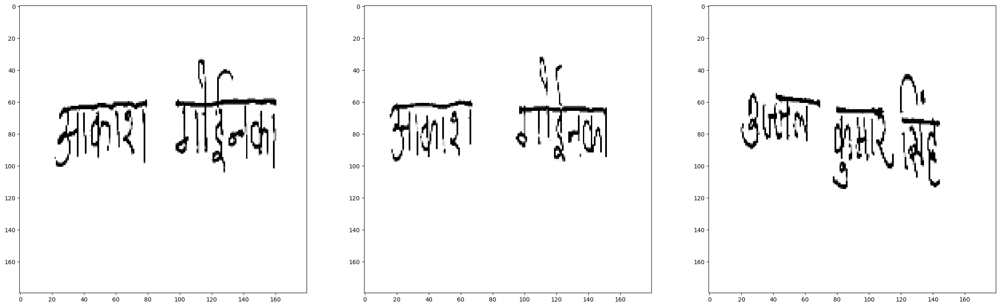

In [ ]:
visualize(sample)

Now lets build the Base CNN for extracting embeddings from the images

As we know that, we can build the Base CNN using the following ways

 - CNN from scratch
 - Using Pre-trained models (Transfer learning)

For contrastive loss, we had used ResNet-50 as Base CNN to extract embedding. Now lets use the same embeddings

**Note:** Try different pre-trained models to check the performance of the model

## Siamese Network with Pretrained model and Triplet Loss

In [ ]:
target_shape=(180,180,3)

In [ ]:
# Embedding
base_cnn = resnet.ResNet50(
    weights="imagenet", input_shape=target_shape, include_top=False
)

base_cnn.trainable=False

glob_pool = layers.GlobalAveragePooling2D()(base_cnn.output)
dense1 = layers.Dense(128)(glob_pool)
dense2 = layers.Dropout(0.2)(dense1)
output = layers.Dense(180)(dense2)


embedding = Model(base_cnn.input, output, name="Embedding")
embedding.summary()

Model: "Embedding"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 180, 180, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 186, 186, 3)  0           ['input_2[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 90, 90, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalization)  (None, 90, 90, 64)   256         ['conv1_conv[0][0]']     

In [ ]:
# Inputs for Anchor, positive and negative images
anchor_in = Input(name='anchor',shape=target_shape)
pos_in = Input(name='positive',shape=target_shape)
neg_in = Input(name='negative',shape=target_shape)

# Extract embeddings using VGG19
anchor_out = embedding(anchor_in)
pos_out = embedding(pos_in)
neg_out = embedding(neg_in)

# Define the model
model_triplet_loss = Model(inputs=[anchor_in, pos_in, neg_in], outputs=[anchor_out,pos_out,neg_out])

model_triplet_loss.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 anchor (InputLayer)            [(None, 180, 180, 3  0           []                               
                                )]                                                                
                                                                                                  
 positive (InputLayer)          [(None, 180, 180, 3  0           []                               
                                )]                                                                
                                                                                                  
 negative (InputLayer)          [(None, 180, 180, 3  0           []                               
                                )]                                                          

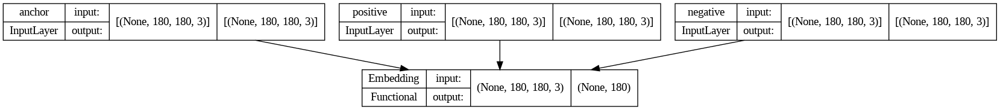

In [ ]:
plot_model(model_triplet_loss, to_file='model_triplet_loss_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
class SiameseModel(Model):

  """The Siamese Network model with a custom training and testing loops.

    Computes the triplet loss using the three embeddings produced by the
    Siamese Network.

    The triplet loss is defined as:
       L(A, P, N) = max(‖f(A) - f(P)‖² - ‖f(A) - f(N)‖² + margin, 0)
    """


  def __init__(self, siamese_network, margin=0.5):
      super().__init__()
      self.siamese_network = siamese_network
      self.margin = margin
      self.loss_tracker = metrics.Mean(name='loss')

  def call(self, inputs):
      return self.siamese_network(inputs)

  def train_step(self, data):
    # GradientTape is a context manager that records every operation that
    # you do inside. We are using it here to compute the loss so we can get
    # the gradients and apply them using the optimizer specified in
    # `compile()`.

    with tf.GradientTape() as tape:

      loss = self._compute_loss(data)

      # Storing the gradients of the loss function with respect to the
      # weights/parameters.

      gradients = tape.gradient(loss,self.siamese_network.trainable_weights)

      # Applying the gradients on the model using the specified optimizer
      self.optimizer.apply_gradients(
                    zip(gradients,self.siamese_network.trainable_weights)
        )

      # Let's update and return the training loss metric
      self.loss_tracker.update_state(loss)
      return {"loss": self.loss_tracker.result()}

  def test_step(self, data):
    loss = self._compute_loss(data)
    # Let's update and return the loss metric.
    self.loss_tracker.update_state(loss)
    return {"loss": self.loss_tracker.result()}

  def _compute_loss(self, data):
    # Computing Triplet loss
    anchor, positive, negative = self.siamese_network(data)

    # Computing the Triplet Loss by subtracting both distances and
    # making sure we don't get a negative value.
    pos_dist = tf.reduce_sum(tf.square(anchor-positive), -1)
    neg_dist = tf.reduce_sum(tf.square(anchor-negative), -1)
    loss = pos_dist - neg_dist + self.margin
    loss = tf.maximum(loss, 0.0)
    return loss

  @property
  def metrics(self):
    return [self.loss_tracker]

In [ ]:
siamese_model = SiameseModel(model_triplet_loss)
siamese_model.compile(optimizer=Adam(learning_rate=0.0001))

### Training the model with triplet loss

In [ ]:
history = siamese_model.fit(train_data, validation_data=val_data, steps_per_epoch=len(train_data)//8,validation_steps = len(val_data)//8,
epochs=8)

Epoch 1/8
250/250 [==============================] - 455s 2s/step - loss: 0.2803 - val_loss: 0.1626
Epoch 2/8
250/250 [==============================] - 438s 2s/step - loss: 0.0951 - val_loss: 0.1050
Epoch 3/8
250/250 [==============================] - 436s 2s/step - loss: 0.0900 - val_loss: 0.0578
Epoch 4/8
250/250 [==============================] - 414s 2s/step - loss: 0.0574 - val_loss: 0.0263
Epoch 5/8
250/250 [==============================] - 416s 2s/step - loss: 0.0513 - val_loss: 0.0433
Epoch 6/8
250/250 [==============================] - 410s 2s/step - loss: 0.0661 - val_loss: 0.0464
Epoch 7/8
250/250 [==============================] - 408s 2s/step - loss: 0.0439 - val_loss: 0.0149
Epoch 8/8
250/250 [==============================] - 410s 2s/step - loss: 0.0573 - val_loss: 0.0222


In [ ]:
# Test Data 1 batch (8 triplets)
ex = test_data.as_numpy_iterator().next()

In [ ]:
# Prediction on the batch
pred = model_triplet_loss.predict(ex)

In [ ]:
# Anchor_embedding, Positive_embedding, Negative_embedding
len(pred)

3

In [ ]:
pred

[array([[-0.76558936, -1.2964464 , -1.0710844 , ...,  0.7454242 ,
          0.70966697, -0.8338506 ],
        [-0.9557396 , -1.2591578 , -0.7683724 , ...,  0.90942895,
          0.7235957 , -1.0486528 ],
        [-0.6548096 , -1.487282  , -1.0145354 , ...,  0.64700943,
          0.9542303 , -0.9276237 ],
        ...,
        [-0.8385905 , -1.2533355 , -1.0997627 , ...,  0.40738004,
          0.88553584, -0.53363097],
        [-1.0066978 , -1.1100035 , -1.344815  , ...,  0.30968532,
          0.99547994, -0.57120764],
        [-0.7259147 , -1.3652716 , -1.1956439 , ...,  0.49678347,
          0.8420548 , -0.77586865]], dtype=float32),
 array([[-0.85636115, -1.2442392 , -1.2228942 , ...,  0.704798  ,
          1.0435429 , -0.83422494],
        [-0.91315347, -1.0944694 , -0.9498567 , ...,  0.71947587,
          0.9425039 , -0.81686646],
        [-1.0093191 , -1.310233  , -1.0681083 , ...,  0.8466239 ,
          1.0135788 , -1.0161096 ],
        ...,
        [-0.79509276, -1.4460882 , -1.0

- At this point, we can check how the network learned to separate the embeddings depending on whether they belong to similar images.

- We can use **Euclidean Distance** to measure the similarity between embeddings.

- Let's pick a batch from the test dataset to check the similarity between the embeddings generated for each image.

- Finally, we can compute the Euclidean between the anchor and positive images and compare it with the similarity between the anchor and the negative images.

- We should expect the similarity between the anchor and positive images to be larger than the similarity between the anchor and the negative images.

In [ ]:
from sklearn.metrics.pairwise import euclidean_distances as L2

In [ ]:
# Distance between anchor and positive
pos = L2(pred[0][0].reshape(1,-1),pred[1][0].reshape(1,-1))
# Distance between anchor and negative
neg = L2(pred[0][0].reshape(1,-1),pred[2][0].reshape(1,-1))

In [ ]:
pos

array([[1.7370224]], dtype=float32)

In [ ]:
neg

array([[2.2224913]], dtype=float32)

Lets Calculate Euclidean distance for 8 triplets`

In [ ]:
pos_pred = []
neg_pred = []

In [ ]:
for i in range(len(pred[0])):
  # Distance between anchor anf positive
  pos = L2(pred[0][i].reshape(1,-1),pred[1][i].reshape(1,-1))[0][0]
  # Distance between anchor and negative
  neg = L2(pred[0][i].reshape(1,-1),pred[2][i].reshape(1,-1))[0][0]
  pos_pred.append(pos)
  neg_pred.append(neg)

In [ ]:
test_pred = pd.DataFrame({'Anchor-positive':pos_pred,'Anchor-negative':neg_pred})

In [ ]:
test_pred

,Anchor-positive,Anchor-negative
0,1.737022,2.222491
1,2.192841,3.032899
2,2.408677,5.389091
3,1.975940,4.254671
4,2.067111,3.490207
5,2.270087,2.741098
6,2.246190,3.810503
7,3.213068,3.022354


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

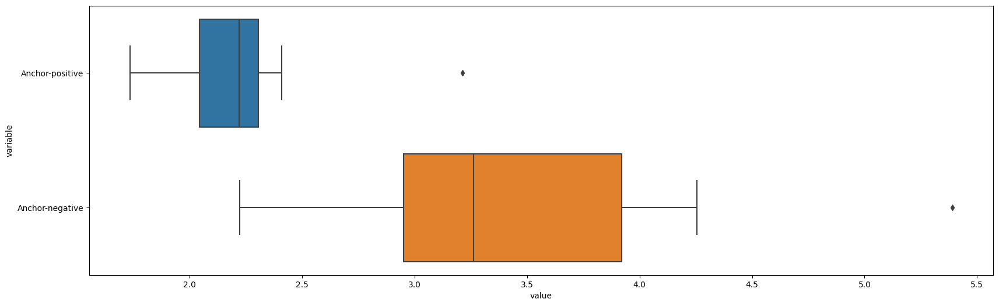

In [ ]:
plt.figure(figsize=(20,6))
sns.boxplot(x="value", y="variable", data=pd.melt(test_pred[['Anchor-positive','Anchor-negative']]))
plt.rc('font', size=20)
plt.show()

Threshold of 2.5 gives correct decisions 75% of the time, so let's go with that. You can try out different values as well.

In [ ]:
len(test_pred[(test_pred['Anchor-positive']<2.5) & (test_pred['Anchor-negative']>2.5)])/len(test_pred)

0.75

### Extraction of Embeddings Model from Siamese Network
Since we don't want to use the three input-three output siamese model every time we are required to create embeddings, we will extract the embeddings network from the model and use it to create embeddings for our future tasks

In [ ]:
model_triplet_loss.layers

In [ ]:
signature_embeddings = model_triplet_loss.layers[-1]

In [ ]:
signature_embeddings.save("embeddings_triplet_loss.h5")

In [ ]:
signature_embeddings.save_weights("embeddings_triplet_loss_weights.h5")

In [ ]:
# Downloading best model and weights

!gdown 1FLM_wpWtyxQAuUv_a4f0_KsPyUlJD251
!gdown 19-QvHIZ4hDea8etuIAAnIaM81_g6XymA

Downloading...
From: https://drive.google.com/uc?id=1FLM_wpWtyxQAuUv_a4f0_KsPyUlJD251
To: /content/embeddings_triplet_loss.h5
100% 96.0M/96.0M [00:02<00:00, 47.6MB/s]
Downloading...
From: https://drive.google.com/uc?id=19-QvHIZ4hDea8etuIAAnIaM81_g6XymA
To: /content/embeddings_triplet_loss_weights.h5
100% 95.9M/95.9M [00:00<00:00, 113MB/s]


In [ ]:
# Loading the
signature_embeddings = tf.keras.models.load_model("/content/embeddings_triplet_loss.h5")
signature_embeddings.load_weights("/content/embeddings_triplet_loss_weights.h5")

Now let's use the image pairs from **Hindi_pairs.txt**, to compute the accuracy and the threshold

In [ ]:
pred_distances = []

In [ ]:
for i in range(len(inp_imgs)):
  inp_feat = preprocess_image(inp_imgs[i])
  val_feat = preprocess_image(val_imgs[i])
  res = L2(signature_embeddings.predict(np.expand_dims(inp_feat,axis=0)),signature_embeddings.predict(np.expand_dims(val_feat,axis=0)))
  pred_distances.append(res)

In [ ]:
len(pred_distances)

8964

In [ ]:
pairs['distance'] = pred_distances

In [ ]:
distances = []

In [ ]:
for idx,row in pairs.iterrows():
  dist = row['distance'][0][0]
  distances.append(dist)

In [ ]:
pairs['distance'] = distances

In [ ]:
pairs.head()

,0,1,2,distance
0,001/H-S-1-G-01.tif,001/H-S-1-F-01.tif,0,4.244997
1,001/H-S-1-G-02.tif,001/H-S-1-F-01.tif,0,4.592545
2,001/H-S-1-G-03.tif,001/H-S-1-F-01.tif,0,3.891743
3,001/H-S-1-G-04.tif,001/H-S-1-F-01.tif,0,3.769315
4,001/H-S-1-G-05.tif,001/H-S-1-F-01.tif,0,3.631461


In [ ]:
pairs.to_csv("pairs_new.csv")

In [ ]:
pairs_new = pd.read_csv("pairs_new.csv")

In [ ]:
pairs_new

In [ ]:
genuine_imgs = pairs_new[pairs_new.iloc[:,3]==1].values
forgery_imgs = pairs_new[pairs_new.iloc[:,3]==0].values

In [ ]:
genuine_imgs

In [ ]:
forgery_imgs

### Now Lets visualize the Embeddings

In [ ]:
# Visualizing 1 Genuine Signature pair
genuine_results = []
img1 = preprocess_image(path+genuine_imgs[0][1])
img2 = preprocess_image(path+genuine_imgs[0][2])
embed1 = signature_embeddings.predict(np.expand_dims(img1,axis=0))
embed2 = signature_embeddings.predict(np.expand_dims(img2,axis=0))
genuine_results.append(embed1)
genuine_results.append(embed2)

In [ ]:
genuine_results = np.array(genuine_results)

In [ ]:
genuine_results.shape

In [ ]:
# Save embeddings for visualization in projector
np.savetxt("vecs.tsv", genuine_results.reshape((2,-1)), delimiter='\t')

<img src="https://drive.google.com/uc?id=1ou8doUGGF3M8YpHNM-W7yjRE4ZCkYSx7" width=600>

In [ ]:
# Visualizing 1 Forgery Signature pair
forgery_results = []
img1 = preprocess_image(path+forgery_imgs[0][1])
img2 = preprocess_image(path+forgery_imgs[0][2])
embed1 = signature_embeddings.predict(np.expand_dims(img1,axis=0))
embed2 = signature_embeddings.predict(np.expand_dims(img2,axis=0))
forgery_results.append(embed1)
forgery_results.append(embed2)

In [ ]:
forgery_results = np.array(forgery_results)

In [ ]:
forgery_results.shape

In [ ]:
# Save embeddings for visualization in projector
np.savetxt("vecs_forgery.tsv", forgery_results.reshape((2,-1)), delimiter='\t')

<img src="https://drive.google.com/uc?id=119ggTHKoBIB6rTq3c0_qMQcnpkbPF48_" width=600>

Similar signatures have less euclidean distance, while the different signatures have comparatively higher euclidean distance

Now lets split the data into two sets

- to compute the threshold and accuracy in the first set of data
- Use the same threshold to find the accuracy in the test set

In [ ]:
labels = pairs_new.iloc[:,3].values
dist = pairs_new['distance'].values

In [ ]:
from sklearn.model_selection import train_test_split

dist_train,dist_test,labels_train,labels_test = train_test_split(dist,labels,test_size=0.2,random_state=42)

In [ ]:
def compute_accuracy_thresh(predictions, labels):

    dmax = np.max(predictions)
    dmin = np.min(predictions)
    nsame = np.sum(labels == 1)
    ndiff = np.sum(labels == 0)

    step = 0.01
    max_acc = 0
    best_thresh = -1
    best_labels = None

    for d in np.arange(dmin, dmax+step, step):

        best_labels = (predictions <= d).astype(int)

    # Calculate tp, tn, fp, fn using best_labels and ground truth labels
        tp = np.sum((best_labels == 1) & (labels == 1))
        tn = np.sum((best_labels == 0) & (labels == 0))
        fp = np.sum((best_labels == 1) & (labels == 0))
        fn = np.sum((best_labels == 0) & (labels == 1))
        accuracy = (tp + tn) / (tp + tn + fp + fn)

        if accuracy>max_acc:
          max_acc = accuracy
          best_thresh = d

    return max_acc, best_thresh

In [ ]:
acc,thresh = compute_accuracy_thresh(dist_train,labels_train)

In [ ]:
# Accuracy
acc

In [ ]:
# Threshold
thresh

Now lets use the same threshold to find the accuracy of the test set

In [ ]:
# Computing Test Accuracy with the train threshold
def compute_accuracy_thresh_test(predictions, labels,d):

    best_labels = (predictions <= d).astype(int)
    tp = np.sum((best_labels == 1) & (labels == 1))
    tn = np.sum((best_labels == 0) & (labels == 0))
    fp = np.sum((best_labels == 1) & (labels == 0))
    fn = np.sum((best_labels == 0) & (labels == 1))
    accuracy = (tp + tn) / (tp + tn + fp + fn)

    return accuracy

In [ ]:
# Test Accuracy
test_acc= compute_accuracy_thresh_test(np.array(dist_test), np.array(labels_test),thresh)
test_acc

In [ ]:
# Train loss vs validation loss
plt.plot(history.history['loss'],label='Train Loss')
plt.plot(history.history['val_loss'],label='Validation Loss')
plt.legend()
plt.show()

### Contrastive Loss Vs Triplet Loss

<table>
  <tr>
    <th>Loss</th>
    <th>Train Accuracy</th>
    <th>Test Accuracy</th>
  </tr>
  <tr>
    <td>Contrastive Loss</td>
    <td>92.56</td>
    <td>63.81</td>
  </tr>
  <tr>
    <td>Triplet Loss</td>
    <td>82.66</td>
    <td>82.48</td>
  </tr>
</table>